# Urban Sound Classification

<img src = "https://www.zmescience.com/mrf4u/statics/i/ps/cdn.zmescience.com/wp-content/uploads/2020/06/AP_18332618287294-1000x666-1.jpg?width=1200&enable=upscale">

## By :- **Sreevaatsav Bavana**    ,  Dec-2021 --- Jan-2022                         

### **This project deals with diiferent ascpects of supervised learning, neural networks ,audio data analysis, applications of sound processing & analysis and feature extraction using python.**

## Task :- 
### To classify some audio files into thier respective, the dataset given is named as UrbanSound8K, which contains about 9000 audio files of 10 different classes. 

Link for the datasert from kaggle.com :- https://www.kaggle.com/chrisfilo/urbansound8k

### The classes and thier respective class IDs are listed below

Class ID:- 

0 : air_conditioner

1 : car_horn

2 : children_playing

3 : dog_bark

4 : drilling

5 : enginge_idling

6 : gun_shot

7 : jackhammer

8 : siren  

9 : street_music

In [1]:
#classes :- 
class_labels = {0:"air_conditioner", 1:"car_horn", 2:"children_playing", 3:"dog_bark", 4:"drilling", 5:"enginge_idling", 6:"gun_shot", 7:"jackhammer", 8:"siren", 9:"street_music"}

### Importing the necessary libraries we will be using to solve the task

In [2]:
import os
import time
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.ensemble import AdaBoostClassifier

from sklearn.metrics import confusion_matrix, classification_report,accuracy_score,average_precision_score,f1_score

import librosa
import IPython.display as ipd

## Note:- 

**All the work done in this project is done on my local computer, without using any cloud_computing service, so loading the files have been done from my local pc, so the data paths would be different, if you want to reuse\rerun the code, make sure to download the dataset and then update all the folder and file paths, while running the notebook**

In [3]:
s, sr = librosa.load("C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold4\\128160-5-0-11.wav")

In [5]:
ipd.Audio("C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold4\\128160-5-0-10.wav")

Loading the metadata of our dataset, which describes about the main data

In [6]:
df = pd.read_csv("C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\metadata\\UrbanSound8K.csv")
df

,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.000000,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.500000,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.500000,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.000000,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.500000,72.500000,1,5,2,children_playing
...,...,...,...,...,...,...,...,...
8727,99812-1-2-0.wav,99812,159.522205,163.522205,2,7,1,car_horn
8728,99812-1-3-0.wav,99812,181.142431,183.284976,2,7,1,car_horn
8729,99812-1-4-0.wav,99812,242.691902,246.197885,2,7,1,car_horn
8730,99812-1-5-0.wav,99812,253.209850,255.741948,2,7,1,car_horn


In [7]:
folder_path = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio"

folds = os.listdir(folder_path)
print(folds)

['fold1', 'fold10', 'fold2', 'fold3', 'fold4', 'fold5', 'fold6', 'fold7', 'fold8', 'fold9']


In [8]:
fold_paths = [os.path.join(folder_path, i) for i in folds]
fold_paths

['C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold1',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold10',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold3',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold4',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold5',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold6',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold7',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold8',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold9']

In [9]:
import random

# Shuffling the folder paths inorder to aviod biased loeading of data
random.shuffle(fold_paths)
fold_paths

['C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold4',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold6',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold5',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold10',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold7',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold3',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold8',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold1',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold9']

#### Extracting the training data and testing data audio files paths

In [10]:
s = time.time()
train_data_paths = []

for i in range(8):
    
    curr_folder_path = fold_paths[i]
    
    curr_files = os.listdir(curr_folder_path)
    
    file_paths = [os.path.join(curr_folder_path, file) for file in curr_files]
    
    for j in range(len(file_paths)):
        curr_file = curr_files[j]
        class_id = df[df['slice_file_name'] == curr_file]
        arr = np.array(class_id['classID'])

        train_data_paths.append([file_paths[j], arr[0]])
        
        
e = time.time()
print((e-s)/60, " mins")
print(len(train_data_paths))

0.19542837937672933  mins
7043


In [11]:
s = time.time()

test_data_paths = []
for i in range(8,10):
    
    curr_folder_path = fold_paths[i]
    
    curr_files = os.listdir(curr_folder_path)
    
    file_paths = [os.path.join(curr_folder_path, file) for file in curr_files]
    
    for j in range(len(file_paths)):
        curr_file = curr_files[j]
        class_id = df[df['slice_file_name'] == curr_file]
        arr = np.array(class_id['classID'])

        test_data_paths.append([file_paths[j], arr[0]])
        
      
e = time.time()
print((e-s)/60, " mins")
print(len(test_data_paths))

0.048430832227071126  mins
1689


In [12]:
len(test_data_paths)

1689

In [13]:
features1 = {"ae_mean", "ae_var", "rms_mean", "rms_var", "zcr_mean", "zcr_var", "chroma_stft_mean", 
            "chroma_stft_var", "spec_centroid_mean", "spec_centroid_var", "spec_cont_mean", "spec_cont_var",
            "spec_bw_mean", "spec_bw,var","percep_mean", "percep_var", "tempo_mean", "tempo_var", 
            "roll_off_mean", "roll_off_var", "roll_off50_mean","roll_off50_var","roll_off25_mean","roll_off25_var",
            "log_mel_mean", "log_mel_var", "mfcc_mean", "mfcc_var", "spec_mean", "spec_var"}


# "mfcc2_mean", "mfcc2_var","mfcc3_mean", "mfcc3_var",
#            "mfcc4_mean", "mfcc4_var","mfcc5_mean", "mfcc5_var","mfcc6_mean", "mfcc6_var","mfcc7_mean", "mfcc7_var", 
#            "mfcc8_mean", "mfcc8_var","mfcc9_mean", "mfcc9_var","mfcc10_mean", "mfcc10_var"

In [14]:
len(features1)

30

In [15]:
data_paths = []

s = time.time()

for i in range(10):
    
    curr_folder_path = fold_paths[i]
    
    curr_files = os.listdir(curr_folder_path)
    
    file_paths = [os.path.join(curr_folder_path, file) for file in curr_files]
    
    for j in range(len(file_paths)):
        curr_file = curr_files[j]
        class_id = df[df['slice_file_name'] == curr_file]
        arr = np.array(class_id['classID'])

        data_paths.append([file_paths[j], arr[0]])
     
e = time.time()
print((e-s)/60, " mins")
# data_paths        

0.25911595424016315  mins


In [16]:
print(len(data_paths))

8732


**Storing the features in form of a dictionary and the we transform this dictionary into a panda's dataframe for easy access**

In [17]:
features_list = {"ae_mean":[], "ae_var":[], "rms_mean":[], "rms_var":[], "zcr_mean":[], "zcr_var":[], "chroma_stft_mean":[], 
            "chroma_stft_var":[], "spec_centroid_mean":[], "spec_centroid_var":[], "spec_cont_mean":[], "spec_cont_var":[],
            "spec_bw_mean":[], "spec_bw_var":[],"percep_mean":[], "percep_var":[], "tempo_mean":[], "tempo_var":[], 
            "roll_off_mean":[], "roll_off_var":[], "roll_off50_mean":[],"roll_off50_var":[],"roll_off25_mean":[],"roll_off25_var":[],
            "log_mel_mean":[], "log_mel_var":[], "mfcc_mean":[], "mfcc_var":[],"spec_mean":[], "spec_var":[], 
            "mag_spec_mean" :[] ,"mag_spec_var":[], "mel_mean":[], "mel_var":[]}

### Functions which we will be using to extract features from the audio files

In [18]:
import numpy as np
import librosa
import IPython.display as ipd

FRAME_LENGTH = 2048
HOP_LENGTH = 512
FRAME_SIZE = 2048
HOP_SIZE = 512


def amplitude_envelope(signal, frame_size = 2048, hop_length = 512):
    amplitude_envelope = []
        
    for i in range(0, len(signal), hop_length):
        current_frame_amplitude_envelope = max(signal[i:i+frame_size])
        amplitude_envelope.append(current_frame_amplitude_envelope)
        
    return np.array(amplitude_envelope)

def Rms(song):
    rms_song = librosa.feature.rms(song, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)
    return rms_song


def Zcr(song):
    zcr_song = librosa.feature.zero_crossing_rate(song, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)
    return zcr_song

def Mag_spec(song):
    signal_ft = np.fft.fft(song)
    magnitude_spectrum = np.abs(signal_ft)
    return magnitude_spectrum
    
def spectrogram(song):
    song_stft = librosa.stft(song, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
    y_song = np.abs(song_stft)**2
    return y_song

def log_spec(song):    
    spec_song = spectrogram(song)
    y_song_log = librosa.power_to_db(spec_song)

def log_mel(song, samp_rate):
    mel_spectrogram = librosa.feature.melspectrogram(song, n_fft= 2048, sr = samp_rate, hop_length = 512 ,n_mels=50)
    log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)
    return log_mel_spectrogram

def Mfcc(song, samp_rate, nmfcc = 13):
    mfccs = librosa.feature.mfcc(song, n_mfcc= nmfcc, sr = samp_rate)
    return mfccs

def delta_mfcc(song, samp_rate, nmfcc = 13):
    mfccs = Mfcc(song, samp_rate)
    delta_mfcc = librosa.feature.delta(mfccs)
    delta2_mfcc = librosa.feature.delta(mfccs, order=2)
    delta3_mfcc = librosa.feature.delta(mfccs, order=3)
    delta4_mfcc = librosa.feature.delta(mfccs, order=4)
    delta5_mfcc = librosa.feature.delta(mfccs, order=5)
    delta6_mfcc = librosa.feature.delta(mfccs, order=6)

    return (delta_mfcc, delta2_mfcc, delta3_mfcc, delta4_mfcc, delta5_mfcc, delta6_mfcc)

def Chroma_stft(song, samp_rate):  
    c_stft = librosa.feature.chroma_stft(song, samp_rate)
    return c_stft

def Spec_centriod(song, samp_rate):
    return librosa.feature.spectral_centroid(song, samp_rate)

# spectral rolloff is the frequency below which a specified percentage of the total spectral energy, e.g. 85%, lies.
def spec_roll_off(song, samp_rate):
    return librosa.feature.spectral_rolloff(song, samp_rate)

def spec_roll_off50(song, samp_rate):
    return librosa.feature.spectral_rolloff(song, samp_rate, roll_percent=0.5)

def spec_roll_off25(song, samp_rate):
    return librosa.feature.spectral_rolloff(song, samp_rate, roll_percent=0.25)

def spec_contrast(song, samp_rate):
    return librosa.feature.spectral_contrast(song, samp_rate)

def perceptual_wt(song, samp_rate):
    return librosa.perceptual_weighting(song, samp_rate)

def tempogram(song, samp_rate):
    return librosa.feature.tempogram(song, samp_rate)

def spec_bandwidth(song, samp_rate):
    return librosa.feature.spectral_bandwidth(song, samp_rate)

## Extracting features

Extracting audio featues which would be useful from all the audio files given

In [19]:
s = time.time()

for i in range(len(data_paths)):
    
    sample , sr = librosa.load(data_paths[i][0])
    
    
    ae = amplitude_envelope(sample, frame_size = 2048, hop_length = 512)
    ae_m, ae_v = ae.mean(), ae.var()
    features_list["ae_mean"].append(ae_m)
    features_list["ae_var"].append(ae_v)
    
    
    rms = Rms(sample)
    rms_m, rms_v = rms.mean(), rms.var()
    features_list["rms_mean"].append(rms_m)
    features_list["rms_var"].append(rms_v)
    
    zcr =  Zcr(sample)
    zcr_m, zcr_v = zcr.mean(), zcr.var()
    features_list["zcr_mean"].append(zcr_m)
    features_list['zcr_var'].append(zcr_v)
    
    
    mag_spec = Mag_spec(sample)
    features_list["mag_spec_mean"].append(mag_spec.mean())
    features_list["mag_spec_var"].append(mag_spec.var())
    
    
    spec = spectrogram(sample)
    features_list["spec_mean"].append(spec.mean())
    features_list['spec_var'].append(spec.var())
    
    
    mel_spec = log_mel(sample, sr)
    features_list["mel_mean"].append(mel_spec.mean())
    features_list["mel_var"].append(mel_spec.var())
    
    
    mfcc = Mfcc(sample, sr)
    features_list["mfcc_mean"].append(mfcc.mean())
    features_list["mfcc_var"].append(mfcc.var())
    
            
    chroma_stft = Chroma_stft(sample, sr)
    features_list["chroma_stft_mean"].append(chroma_stft.mean())
    features_list['chroma_stft_var'].append(chroma_stft.var())
    
    spec_centriod = Spec_centriod(sample, sr)
    features_list['spec_centroid_mean'].append(spec_centriod.mean())
    features_list['spec_centroid_var'].append(spec_centriod.var())
    
    
    spec_roll = spec_roll_off(sample, sr)
    features_list["roll_off_mean"].append(spec_roll.mean())
    features_list['roll_off_var'].append(spec_roll.var())
    
    
    spec_roll50 = spec_roll_off50(sample, sr)
    features_list["roll_off50_mean"].append(spec_roll50.mean())
    features_list['roll_off50_var'].append(spec_roll50.var())
    
    
    spec_roll25 =  spec_roll_off25(sample, sr)
    features_list["roll_off25_mean"].append(spec_roll25.mean())
    features_list['roll_off25_var'].append(spec_roll25.var())
    
    
    spec_contr =  spec_contrast(sample, sr)
    features_list["spec_cont_mean"].append(spec_contr.mean())
    features_list['spec_cont_var'].append(spec_contr.var())
    

    percep =  perceptual_wt(sample, sr)
    features_list["percep_mean"].append(percep.mean())
    features_list['percep_var'].append(percep.var())
    
    
    tempo =  tempogram(sample, sr)
    features_list["tempo_mean"].append(tempo.mean())
    features_list["tempo_var"].append(tempo.var())
    
    
    spec_bw =  spec_bandwidth(sample, sr)
    features_list["spec_bw_mean"].append(spec_bw.mean())
    features_list['spec_bw_var'].append(spec_bw.var())
    
    log_me = log_mel(sample, sr)
    features_list["log_mel_mean"].append(log_me.mean())
    features_list['log_mel_var'].append(log_me.var())
    
#     print(i)

    
e = time.time()
print((e - s)/60  , "mins")

C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\pitch.py:153: UserWarning: Trying to estimate tuning from empty frequency set.
  warnings.warn("Trying to estimate tuning from empty frequency set.")
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1323
  warnings.warn(
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1103
  warnings.warn(
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1523
  warnings.warn(


78.39120826721191 mins


Extracting these features as taken about 1 and a half hour of time, in this local pc

In [20]:
print(len(features_list))

34


In [21]:
keys = features_list.keys()

for key in keys:
    print(len(features_list[key]), key)

8732 ae_mean
8732 ae_var
8732 rms_mean
8732 rms_var
8732 zcr_mean
8732 zcr_var
8732 chroma_stft_mean
8732 chroma_stft_var
8732 spec_centroid_mean
8732 spec_centroid_var
8732 spec_cont_mean
8732 spec_cont_var
8732 spec_bw_mean
8732 spec_bw_var
8732 percep_mean
8732 percep_var
8732 tempo_mean
8732 tempo_var
8732 roll_off_mean
8732 roll_off_var
8732 roll_off50_mean
8732 roll_off50_var
8732 roll_off25_mean
8732 roll_off25_var
8732 log_mel_mean
8732 log_mel_var
8732 mfcc_mean
8732 mfcc_var
8732 spec_mean
8732 spec_var
8732 mag_spec_mean
8732 mag_spec_var
8732 mel_mean
8732 mel_var


In [535]:
feature_df = pd.DataFrame(features_list)
feature_df

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,log_mel_mean,log_mel_var,mfcc_mean,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var
0,0.192389,0.053211,0.050691,0.004390,0.148977,0.000698,0.421281,0.085848,2128.661266,126434.632855,...,-23.082655,244.374283,-20.532057,7552.996094,5.339345,4878.319336,10.810352,499.518139,-23.082655,244.374283
1,0.184112,0.051082,0.051546,0.004913,0.153907,0.000485,0.404386,0.086587,2087.546517,98111.190307,...,-24.810883,259.542023,-22.961239,8421.319336,5.785983,7797.457520,9.924372,551.032124,-24.810883,259.542023
2,0.178527,0.048749,0.046048,0.004137,0.153738,0.000402,0.415631,0.082142,2087.126909,113064.471091,...,-25.653231,254.874680,-23.268936,8738.814453,4.803069,8566.291992,9.214713,469.228249,-25.653231,254.874680
3,0.213327,0.063373,0.057560,0.005774,0.148706,0.000305,0.394409,0.089245,2009.483628,90735.530937,...,-25.589579,284.306000,-23.393444,8856.173828,6.971896,25871.232422,10.431299,696.043762,-25.589579,284.306000
4,0.099304,0.003569,0.022342,0.000265,0.140918,0.001612,0.494683,0.086361,2345.073177,255178.082908,...,-21.765249,110.520988,-15.695037,5767.820312,0.586488,161.388336,1.371720,11.807040,-21.765249,110.520988
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8727,0.027573,0.000104,0.008722,0.000008,0.132025,0.002368,0.460973,0.084904,2186.598901,94962.562056,...,-29.816303,128.564011,-13.761144,10376.634766,0.065017,0.589521,1.339329,5.629912,-29.816303,128.564011
8728,0.022594,0.000051,0.007601,0.000003,0.103343,0.001936,0.514130,0.080489,1886.965369,74929.468914,...,-31.474649,147.418457,-14.021654,11503.816406,0.047384,0.143505,1.043717,4.300226,-31.474649,147.418457
8729,0.032027,0.000111,0.010544,0.000011,0.133594,0.001897,0.416454,0.095439,2101.282680,47676.675760,...,-28.523304,155.665451,-12.850286,9964.236328,0.094609,0.930004,1.618099,8.180577,-28.523304,155.665451
8730,0.026609,0.000055,0.008393,0.000003,0.134100,0.000834,0.498625,0.068075,2095.691714,31783.916885,...,-29.363554,141.354050,-12.993278,10303.923828,0.056747,0.196992,1.245130,4.905445,-29.363554,141.354050


In [536]:
print(len(keys))

34


In [537]:
df1 = feature_df.copy()

df1

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,log_mel_mean,log_mel_var,mfcc_mean,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var
0,0.192389,0.053211,0.050691,0.004390,0.148977,0.000698,0.421281,0.085848,2128.661266,126434.632855,...,-23.082655,244.374283,-20.532057,7552.996094,5.339345,4878.319336,10.810352,499.518139,-23.082655,244.374283
1,0.184112,0.051082,0.051546,0.004913,0.153907,0.000485,0.404386,0.086587,2087.546517,98111.190307,...,-24.810883,259.542023,-22.961239,8421.319336,5.785983,7797.457520,9.924372,551.032124,-24.810883,259.542023
2,0.178527,0.048749,0.046048,0.004137,0.153738,0.000402,0.415631,0.082142,2087.126909,113064.471091,...,-25.653231,254.874680,-23.268936,8738.814453,4.803069,8566.291992,9.214713,469.228249,-25.653231,254.874680
3,0.213327,0.063373,0.057560,0.005774,0.148706,0.000305,0.394409,0.089245,2009.483628,90735.530937,...,-25.589579,284.306000,-23.393444,8856.173828,6.971896,25871.232422,10.431299,696.043762,-25.589579,284.306000
4,0.099304,0.003569,0.022342,0.000265,0.140918,0.001612,0.494683,0.086361,2345.073177,255178.082908,...,-21.765249,110.520988,-15.695037,5767.820312,0.586488,161.388336,1.371720,11.807040,-21.765249,110.520988
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8727,0.027573,0.000104,0.008722,0.000008,0.132025,0.002368,0.460973,0.084904,2186.598901,94962.562056,...,-29.816303,128.564011,-13.761144,10376.634766,0.065017,0.589521,1.339329,5.629912,-29.816303,128.564011
8728,0.022594,0.000051,0.007601,0.000003,0.103343,0.001936,0.514130,0.080489,1886.965369,74929.468914,...,-31.474649,147.418457,-14.021654,11503.816406,0.047384,0.143505,1.043717,4.300226,-31.474649,147.418457
8729,0.032027,0.000111,0.010544,0.000011,0.133594,0.001897,0.416454,0.095439,2101.282680,47676.675760,...,-28.523304,155.665451,-12.850286,9964.236328,0.094609,0.930004,1.618099,8.180577,-28.523304,155.665451
8730,0.026609,0.000055,0.008393,0.000003,0.134100,0.000834,0.498625,0.068075,2095.691714,31783.916885,...,-29.363554,141.354050,-12.993278,10303.923828,0.056747,0.196992,1.245130,4.905445,-29.363554,141.354050


In [538]:
print(len(data_paths))

8732


In [539]:
file_names = [data_paths[i][0].split("\\")[7] for i in range(len(data_paths))]
print(len(file_names))
file_names

8732


['100652-3-0-0.wav',
 '100652-3-0-1.wav',
 '100652-3-0-2.wav',
 '100652-3-0-3.wav',
 '102104-3-0-0.wav',
 '102858-5-0-0.wav',
 '102858-5-0-1.wav',
 '102871-8-0-0.wav',
 '102871-8-0-1.wav',
 '102871-8-0-10.wav',
 '102871-8-0-11.wav',
 '102871-8-0-12.wav',
 '102871-8-0-13.wav',
 '102871-8-0-14.wav',
 '102871-8-0-15.wav',
 '102871-8-0-2.wav',
 '102871-8-0-3.wav',
 '102871-8-0-4.wav',
 '102871-8-0-5.wav',
 '102871-8-0-6.wav',
 '102871-8-0-7.wav',
 '102871-8-0-8.wav',
 '102871-8-0-9.wav',
 '104817-4-0-0.wav',
 '104817-4-0-1.wav',
 '104817-4-0-10.wav',
 '104817-4-0-11.wav',
 '104817-4-0-2.wav',
 '104817-4-0-3.wav',
 '104817-4-0-4.wav',
 '104817-4-0-5.wav',
 '104817-4-0-6.wav',
 '104817-4-0-7.wav',
 '104817-4-0-8.wav',
 '104817-4-0-9.wav',
 '106015-5-0-0.wav',
 '106015-5-0-1.wav',
 '106015-5-0-10.wav',
 '106015-5-0-11.wav',
 '106015-5-0-12.wav',
 '106015-5-0-13.wav',
 '106015-5-0-14.wav',
 '106015-5-0-15.wav',
 '106015-5-0-16.wav',
 '106015-5-0-17.wav',
 '106015-5-0-18.wav',
 '106015-5-0-19.w

In [540]:
class_index = [data_paths[i][1] for i in range(len(data_paths))]
print(len(class_index))

8732


### Creating a Dataframe of the features extracted which would be easy to work out with... :)

In [544]:
df1["file_name"] = file_names
# df1["class_id"] = class_id

df1

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,log_mel_var,mfcc_mean,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var,file_name
0,0.192389,0.053211,0.050691,0.004390,0.148977,0.000698,0.421281,0.085848,2128.661266,126434.632855,...,244.374283,-20.532057,7552.996094,5.339345,4878.319336,10.810352,499.518139,-23.082655,244.374283,100652-3-0-0.wav
1,0.184112,0.051082,0.051546,0.004913,0.153907,0.000485,0.404386,0.086587,2087.546517,98111.190307,...,259.542023,-22.961239,8421.319336,5.785983,7797.457520,9.924372,551.032124,-24.810883,259.542023,100652-3-0-1.wav
2,0.178527,0.048749,0.046048,0.004137,0.153738,0.000402,0.415631,0.082142,2087.126909,113064.471091,...,254.874680,-23.268936,8738.814453,4.803069,8566.291992,9.214713,469.228249,-25.653231,254.874680,100652-3-0-2.wav
3,0.213327,0.063373,0.057560,0.005774,0.148706,0.000305,0.394409,0.089245,2009.483628,90735.530937,...,284.306000,-23.393444,8856.173828,6.971896,25871.232422,10.431299,696.043762,-25.589579,284.306000,100652-3-0-3.wav
4,0.099304,0.003569,0.022342,0.000265,0.140918,0.001612,0.494683,0.086361,2345.073177,255178.082908,...,110.520988,-15.695037,5767.820312,0.586488,161.388336,1.371720,11.807040,-21.765249,110.520988,102104-3-0-0.wav
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8727,0.027573,0.000104,0.008722,0.000008,0.132025,0.002368,0.460973,0.084904,2186.598901,94962.562056,...,128.564011,-13.761144,10376.634766,0.065017,0.589521,1.339329,5.629912,-29.816303,128.564011,99500-2-0-23.wav
8728,0.022594,0.000051,0.007601,0.000003,0.103343,0.001936,0.514130,0.080489,1886.965369,74929.468914,...,147.418457,-14.021654,11503.816406,0.047384,0.143505,1.043717,4.300226,-31.474649,147.418457,99500-2-0-29.wav
8729,0.032027,0.000111,0.010544,0.000011,0.133594,0.001897,0.416454,0.095439,2101.282680,47676.675760,...,155.665451,-12.850286,9964.236328,0.094609,0.930004,1.618099,8.180577,-28.523304,155.665451,99500-2-0-39.wav
8730,0.026609,0.000055,0.008393,0.000003,0.134100,0.000834,0.498625,0.068075,2095.691714,31783.916885,...,141.354050,-12.993278,10303.923828,0.056747,0.196992,1.245130,4.905445,-29.363554,141.354050,99500-2-0-41.wav


In [545]:
df1["class_id"] = class_index
df1

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,mfcc_mean,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var,file_name,class_id
0,0.192389,0.053211,0.050691,0.004390,0.148977,0.000698,0.421281,0.085848,2128.661266,126434.632855,...,-20.532057,7552.996094,5.339345,4878.319336,10.810352,499.518139,-23.082655,244.374283,100652-3-0-0.wav,3
1,0.184112,0.051082,0.051546,0.004913,0.153907,0.000485,0.404386,0.086587,2087.546517,98111.190307,...,-22.961239,8421.319336,5.785983,7797.457520,9.924372,551.032124,-24.810883,259.542023,100652-3-0-1.wav,3
2,0.178527,0.048749,0.046048,0.004137,0.153738,0.000402,0.415631,0.082142,2087.126909,113064.471091,...,-23.268936,8738.814453,4.803069,8566.291992,9.214713,469.228249,-25.653231,254.874680,100652-3-0-2.wav,3
3,0.213327,0.063373,0.057560,0.005774,0.148706,0.000305,0.394409,0.089245,2009.483628,90735.530937,...,-23.393444,8856.173828,6.971896,25871.232422,10.431299,696.043762,-25.589579,284.306000,100652-3-0-3.wav,3
4,0.099304,0.003569,0.022342,0.000265,0.140918,0.001612,0.494683,0.086361,2345.073177,255178.082908,...,-15.695037,5767.820312,0.586488,161.388336,1.371720,11.807040,-21.765249,110.520988,102104-3-0-0.wav,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8727,0.027573,0.000104,0.008722,0.000008,0.132025,0.002368,0.460973,0.084904,2186.598901,94962.562056,...,-13.761144,10376.634766,0.065017,0.589521,1.339329,5.629912,-29.816303,128.564011,99500-2-0-23.wav,2
8728,0.022594,0.000051,0.007601,0.000003,0.103343,0.001936,0.514130,0.080489,1886.965369,74929.468914,...,-14.021654,11503.816406,0.047384,0.143505,1.043717,4.300226,-31.474649,147.418457,99500-2-0-29.wav,2
8729,0.032027,0.000111,0.010544,0.000011,0.133594,0.001897,0.416454,0.095439,2101.282680,47676.675760,...,-12.850286,9964.236328,0.094609,0.930004,1.618099,8.180577,-28.523304,155.665451,99500-2-0-39.wav,2
8730,0.026609,0.000055,0.008393,0.000003,0.134100,0.000834,0.498625,0.068075,2095.691714,31783.916885,...,-12.993278,10303.923828,0.056747,0.196992,1.245130,4.905445,-29.363554,141.354050,99500-2-0-41.wav,2


In [546]:
df1.to_csv('C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\features_urban_sounds.csv')

In [547]:
y = df1["class_id"]
y = np.array(y)
y

array([3, 3, 3, ..., 2, 2, 2], dtype=int64)

In [548]:
del df1["file_name"]
del df1["class_id"]

X = np.array(df1)

In [549]:
X.shape

(8732, 34)

### Scaling the data

In [564]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

mmscale = MinMaxScaler()

X_sc = mmscale.fit_transform(X)

### Splitting the data into training and testing

In [565]:
x_train, x_test, y_train, y_test = train_test_split(X_sc,y,random_state = 6, test_size=0.2)

In [566]:
x_train.shape, x_test.shape

((6985, 34), (1747, 34))

In [89]:
# x_train, x_val, y_train, y_val = train_test_split(x_train,y_train, )

In [59]:
# print(x_train.shape, x_val.shape, x_test.shape)

### Visualising the top 2 most important features from the extracted ones  

In [393]:
# Top 2 principle compnenets
from sklearn import decomposition, ensemble, datasets, linear_model

pca = decomposition.PCA(n_components = 2)
x_train_vis = pca.fit_transform(x_train)

x_train_vis.shape

(6985, 2)

(6985,) (6985,)


C:\Users\srevaatsav\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


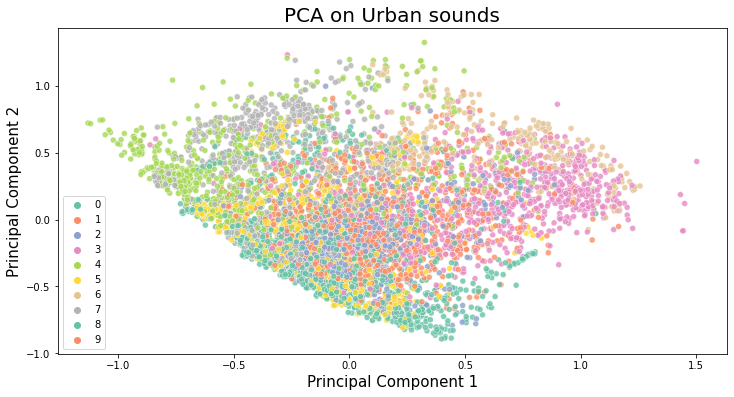

In [394]:
fig = plt.figure(figsize=(12 ,6))

pc1 = x_train_vis[:,0]
pc2 = x_train_vis[:,1]

plt.title('PCA on Urban sounds', fontsize = 20)
plt.xlabel("Principal Component 1", fontsize = 15)
plt.ylabel("Principal Component 2", fontsize = 15)

print(pc1.shape, pc2.shape)
# plt.scatter(pc1, pc2)
sns.scatterplot(pc1, pc2, alpha=0.8, palette="Set2", hue = y_train)

plt.show()

### Creating a copy of the data frame created as a backup 

In [395]:
df2 = df1.copy()

# FIlling the class ids and file names to the respective audio files

df2["file_name"] = file_names
df2["class_id"] = class_index

df2.head()

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,mfcc_mean,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var,file_name,class_id
0,0.192389,0.053211,0.050691,0.004390,0.148977,0.000698,0.421281,0.085848,2128.661266,126434.632855,...,-20.532057,7552.996094,5.339345,4878.319336,10.810352,499.518139,-23.082655,244.374283,100652-3-0-0.wav,3
1,0.184112,0.051082,0.051546,0.004913,0.153907,0.000485,0.404386,0.086587,2087.546517,98111.190307,...,-22.961239,8421.319336,5.785983,7797.457520,9.924372,551.032124,-24.810883,259.542023,100652-3-0-1.wav,3
2,0.178527,0.048749,0.046048,0.004137,0.153738,0.000402,0.415631,0.082142,2087.126909,113064.471091,...,-23.268936,8738.814453,4.803069,8566.291992,9.214713,469.228249,-25.653231,254.874680,100652-3-0-2.wav,3
3,0.213327,0.063373,0.057560,0.005774,0.148706,0.000305,0.394409,0.089245,2009.483628,90735.530937,...,-23.393444,8856.173828,6.971896,25871.232422,10.431299,696.043762,-25.589579,284.306000,100652-3-0-3.wav,3
4,0.099304,0.003569,0.022342,0.000265,0.140918,0.001612,0.494683,0.086361,2345.073177,255178.082908,...,-15.695037,5767.820312,0.586488,161.388336,1.371720,11.807040,-21.765249,110.520988,102104-3-0-0.wav,3


In [396]:
class_labels = {0:"air_conditioner", 1:"car_horn", 2:"children_playing", 3:"dog_bark", 4:"drilling", 5:"enginge_idling", 6:"gun_shot", 7:"jackhammer", 8:"siren", 9:"street_music"}

In [397]:
class_labels.values()

dict_values(['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren', 'street_music'])

In [398]:
def f(n):
    return class_labels[n]


# Filling the class name column as well

df2["class_name"] = df2["class_id"].apply(f)
df2.head()

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var,file_name,class_id,class_name
0,0.192389,0.053211,0.050691,0.004390,0.148977,0.000698,0.421281,0.085848,2128.661266,126434.632855,...,7552.996094,5.339345,4878.319336,10.810352,499.518139,-23.082655,244.374283,100652-3-0-0.wav,3,dog_bark
1,0.184112,0.051082,0.051546,0.004913,0.153907,0.000485,0.404386,0.086587,2087.546517,98111.190307,...,8421.319336,5.785983,7797.457520,9.924372,551.032124,-24.810883,259.542023,100652-3-0-1.wav,3,dog_bark
2,0.178527,0.048749,0.046048,0.004137,0.153738,0.000402,0.415631,0.082142,2087.126909,113064.471091,...,8738.814453,4.803069,8566.291992,9.214713,469.228249,-25.653231,254.874680,100652-3-0-2.wav,3,dog_bark
3,0.213327,0.063373,0.057560,0.005774,0.148706,0.000305,0.394409,0.089245,2009.483628,90735.530937,...,8856.173828,6.971896,25871.232422,10.431299,696.043762,-25.589579,284.306000,100652-3-0-3.wav,3,dog_bark
4,0.099304,0.003569,0.022342,0.000265,0.140918,0.001612,0.494683,0.086361,2345.073177,255178.082908,...,5767.820312,0.586488,161.388336,1.371720,11.807040,-21.765249,110.520988,102104-3-0-0.wav,3,dog_bark


## ***Some Data Visualization***

In [401]:
def pred_int(y_prediction):
    y_pred_int = []
    for i in range(len(y_prediction)):
        max_i = 0
        max_p = 0
        for j in range(len(y_prediction[i])):
            if y_pred[i][j] > max_p:
                max_p = y_prediction[i][j]
                max_i = j
                
        y_pred_int.append(max_i)
        
    return y_pred_int

# y_tr = pred_int(y_train)

In [402]:
sample_data_paths = []
    
dp = np.array(data_paths)
dp.shape

(8732, 2)

In [403]:
for i in range(10):
    temp = dp[dp[:,1] == str(i)]
    sample_data_paths.append(temp[0][0])
    
sample_data_paths

['C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\127872-0-0-0.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\132073-1-0-0.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\109703-2-0-134.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\100652-3-0-0.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\104817-4-0-0.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\102858-5-0-0.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\145608-6-0-0.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\156893-7-0-0.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\102871-8-0-0.wav',
 'C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold2\\14387-9-0-11.wav']

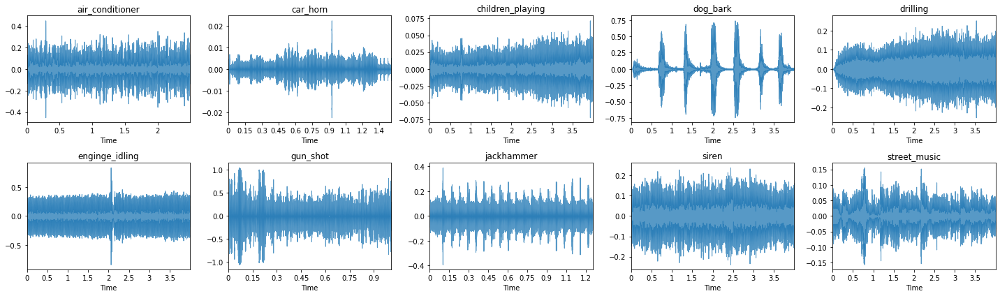

In [72]:
# Displaying each audio file's waveplot, belonging to each class 

import librosa.display

plt.figure(figsize=(20,6))

FRAME_LENGTH = 1024
HOP_LENGTH = 512

for i in range(10):
    
    plt.subplot(2,5,i+1)
    
    s , sr = librosa.load(sample_data_paths[i])
    plt.title(class_labels[i])
    librosa.display.waveplot(s, alpha = 0.75)
    
#     plt.show()
plt.tight_layout()

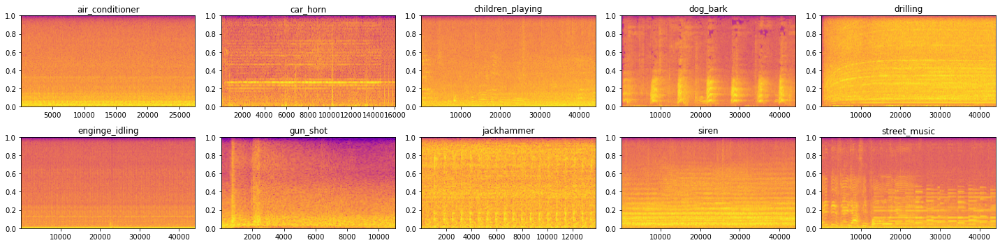

In [73]:
# Plotting the specrograms of the audio files belonging to each class 

import librosa.display

plt.figure(figsize=(20,5))

FRAME_LENGTH = 1024
HOP_LENGTH = 512

for i in range(10):
    
    plt.subplot(2,5,i+1)
    
    s , sr = librosa.load(sample_data_paths[i])
    plt.title(class_labels[i])
    
#              other way to visulaize the spectrums of the audio files 
#####################################################################################
#     s_stft = librosa.stft(s, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)
#     y_s = np.abs(s_stft)**2
#     y_s_stft_log = librosa.power_to_db(y_s)
    
#     librosa.display.specshow(y_s_stft_log,
#                         sr = sr,
#                         hop_length=HOP_LENGTH,
#                         x_axis="time",
#                         y_axis= "log")
#     plt.colorbar(format = "%+2.f")
#####################################################################################

    plt.specgram(s, cmap = "plasma")
    
    
plt.tight_layout()

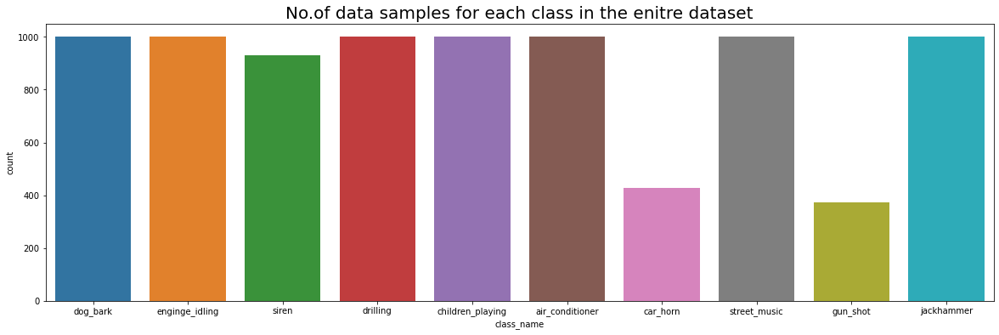

In [404]:
fig = plt.figure(figsize=(20,6))
plt.title("No.of data samples for each class in the enitre dataset", fontsize= 20)
sns.countplot(x ='class_name', data = df2)
plt.show()

### As we can see, the dataset given to us is a bit biased towards other classes than car_horn and gun_shot, as there are lesser no.of datasamples from the 2 classes

To overcome this, we can do some upsampling of our data of the minority class in the **training data only**  

In [567]:
x_train, x_val, y_train, y_val = train_test_split(x_train,y_train,random_state = 6, test_size=0.15)

In [568]:
x_train.shape, y_train.shape

((5937, 34), (5937,))

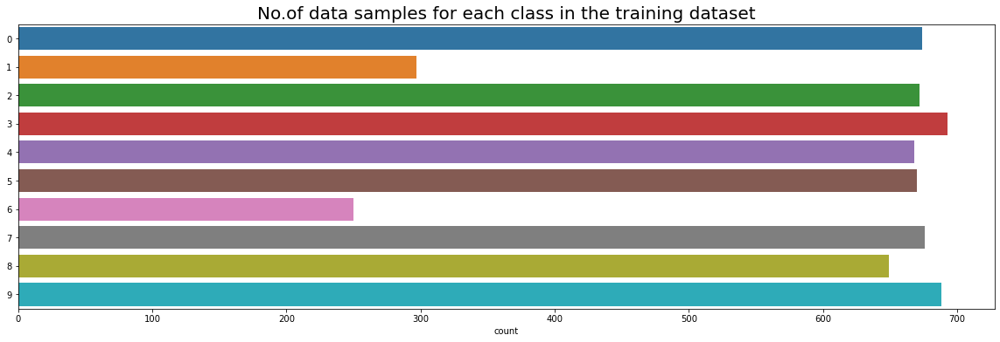

In [569]:
fig = plt.figure(figsize=(20,6))
plt.title("No.of data samples for each class in the training dataset", fontsize= 20)
sns.countplot(y=y_train)
plt.show()

In [556]:
temp_gun = []
temp_car = []

for i in range(len(y_train)):
    
    if y_train[i] == 1:
        temp_car.append(x_train[i])
        
    if y_train[i] == 6:
        temp_gun.append(x_train[i])

In [570]:
target_size = 685

t_s_car = target_size - len(temp_car)
t_s_gun = target_size - len(temp_gun)

print(t_s_car, t_s_gun)

388 435


In [571]:
upsample_car = []
upsample_gun = []

y_up_car = []
y_up_gun = []

In [572]:
for i in range(t_s_car):
    ind = random.randint(0, len(temp_car)-1)
    upsample_car.append(temp_car[ind])
    y_up_car.append(1)
    
for i in range(t_s_gun):
    ind = random.randint(0, len(temp_gun)-1)
    upsample_gun.append(temp_gun[ind])
    y_up_gun.append(6)

In [573]:
x_train = list(x_train)
x_train = x_train + upsample_car + upsample_gun
print(len(x_train))

6760


In [574]:
y_train = list(y_train)
y_train = y_train + y_up_car + y_up_gun
print(len(y_train))

6760


In [575]:
x_train = np.array(x_train)
y_train = np.array(y_train)

print(x_train.shape, y_train.shape)

(6760, 34) (6760,)


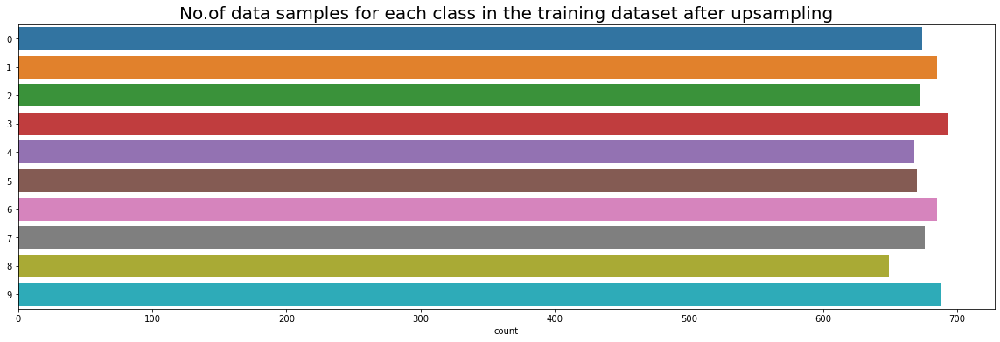

In [576]:
fig = plt.figure(figsize=(20,6))
plt.title("No.of data samples for each class in the training dataset after upsampling", fontsize= 20)
sns.countplot(y=y_train)
plt.show()

In [577]:
x_train_n = x_train

In [578]:
y_train_n = y_train

In [579]:
print(x_train_n.shape, x_test_n.shape, y_train_n.shape, y_test_n.shape)

(6760, 34) (1985, 34) (6760,) (1985,)


In [580]:
x_val.shape , y_val.shape

((1048, 34), (1048,))

### **Plotting different features of the entire data**

#### (Only for orignal data, not the synthetic(upsampled) data).

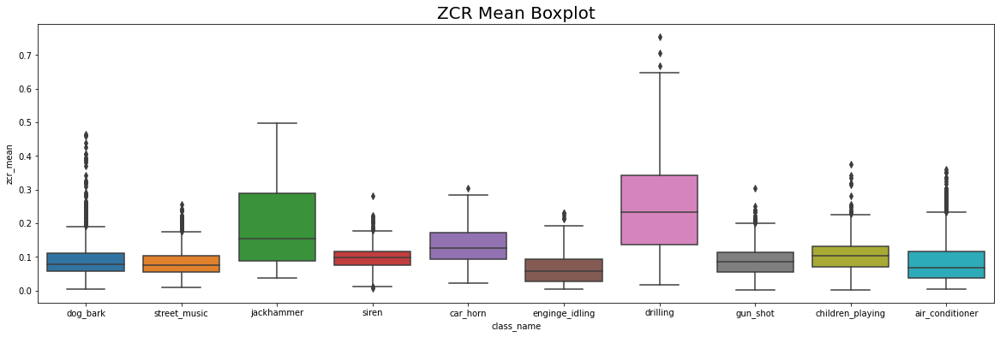

In [866]:
fig = plt.figure(figsize=(20,6))
plt.title("ZCR Mean Boxplot", fontsize= 20)

sns.boxplot(y="zcr_mean",
            x="class_name",
            data=df2)


plt.show()

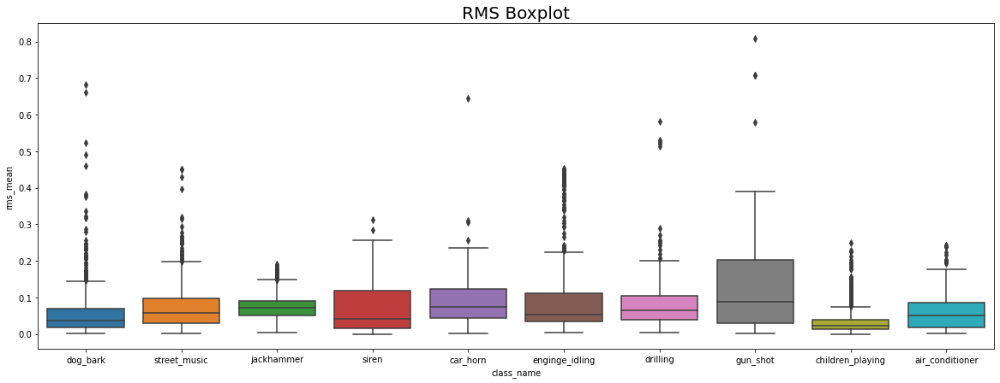

In [865]:
fig = plt.figure(figsize=(20,7))
plt.title("RMS Boxplot", fontsize= 20)
sns.boxplot(y="rms_mean",
            x="class_name",
            data=df2)

plt.show()

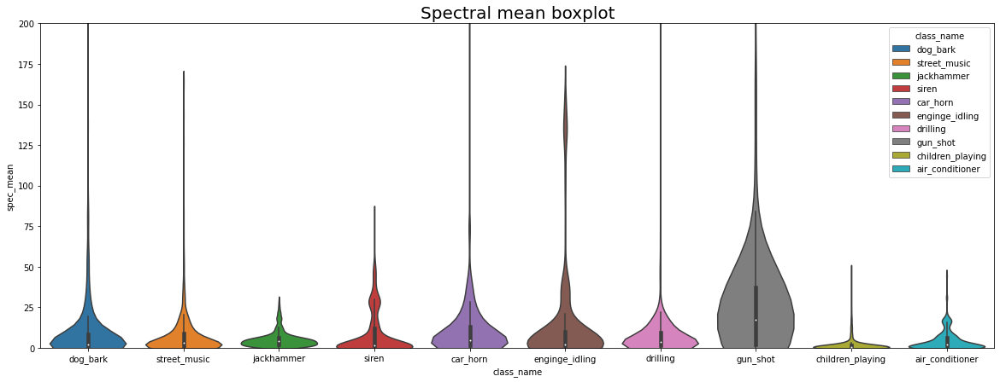

In [890]:
fig = plt.figure(figsize=(20,7))
plt.title("Spectral mean boxplot", fontsize= 20)
sns.violinplot(x = "class_name",
            y = "spec_mean",
            hue = 'class_name',
            data = df2,dodge=0
            )

plt.ylim((0,200))
plt.show()

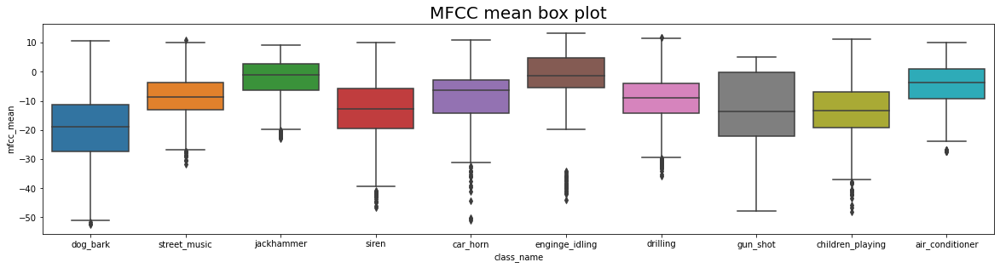

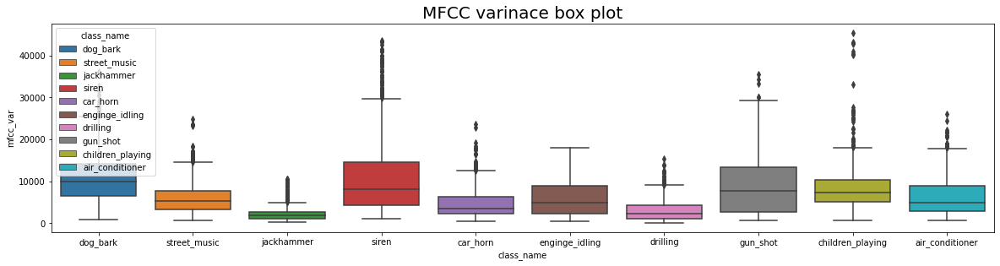

In [895]:
fig = plt.figure(figsize=(20,10))
plt.subplot(2,1,1)
plt.title("MFCC mean box plot", fontsize= 20)
sns.boxplot(x = "class_name",
            y = "mfcc_mean",
#             hue = 'class_name',
            data = df2,
            dodge=0,)

plt.show()


fig = plt.figure(figsize=(20,10))
plt.subplot(2,1,2)
plt.title("MFCC varinace box plot", fontsize= 20)
sns.boxplot(x = "class_name",
            y = "mfcc_var",
            hue = 'class_name',
            data = df2,
            dodge=0,)

plt.show()

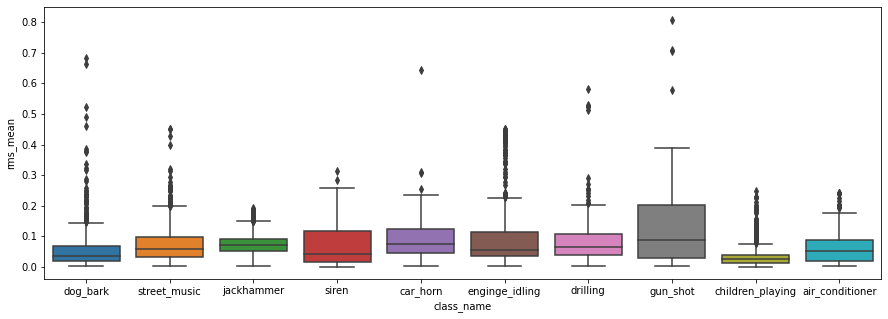

In [863]:
fig = plt.figure(figsize=(15,5))

sns.boxplot(y="rms_mean",
            x="class_name",
            data=df2)

plt.show()

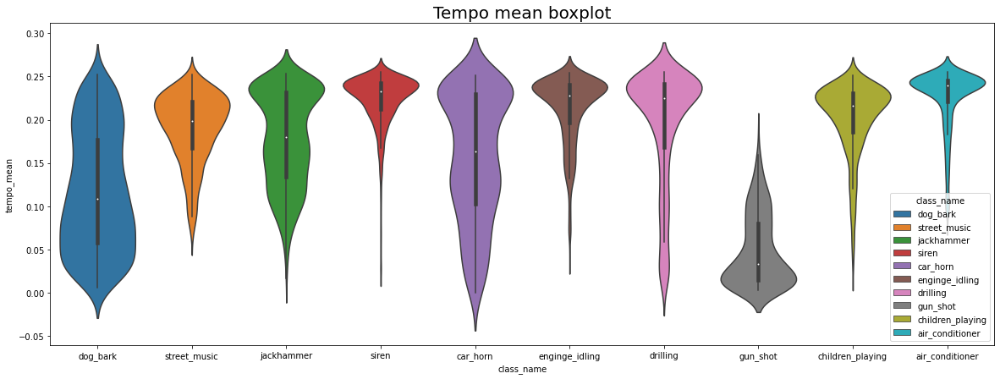

In [901]:
fig = plt.figure(figsize=(20,7))
plt.title("Tempo mean boxplot", fontsize= 20)
sns.violinplot(x = "class_name",
            y = "tempo_mean",
            hue = 'class_name',
            data = df2,dodge=0
            )

plt.show()

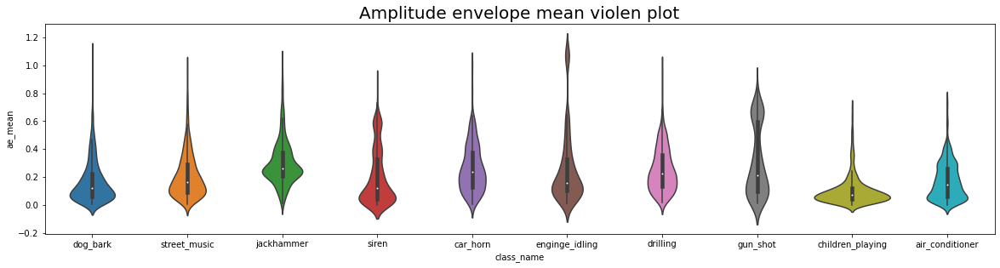

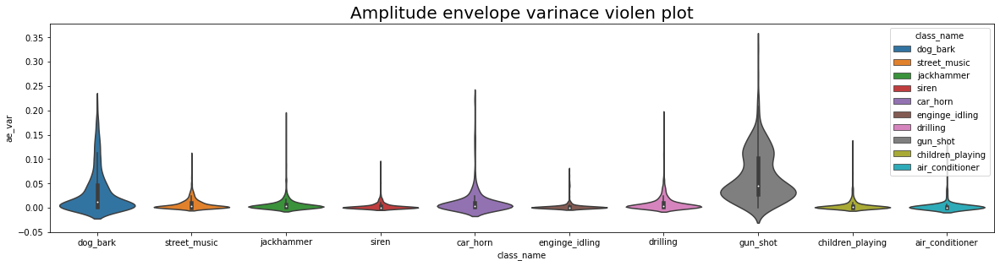

In [907]:
fig = plt.figure(figsize=(20,10))

plt.subplot(2,1,1)
plt.title("Amplitude envelope mean violen plot", fontsize= 20)
sns.violinplot(x = "class_name",
            y = "ae_mean",
            data = df2,dodge=0
            )

plt.show()

fig = plt.figure(figsize=(20,10))
plt.subplot(2,1,2)
plt.title("Amplitude envelope varinace violen plot", fontsize= 20)
sns.violinplot(x = "class_name",
            y = "ae_var",
            hue = 'class_name',
            data = df2,dodge=0
            )

plt.show()

### Plotting some features for 2 classes, specifically he engine_ideling and the air_conditioner ones

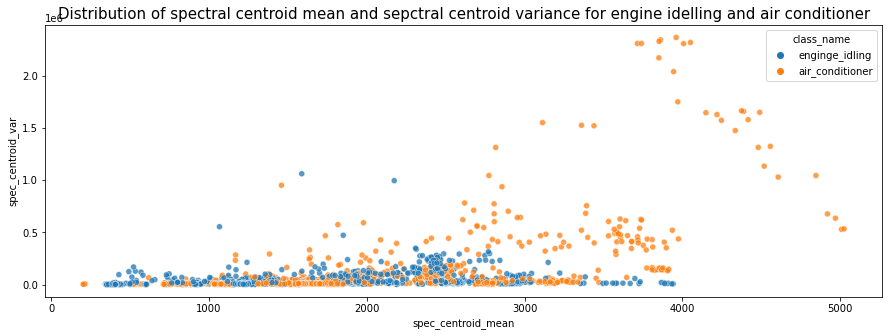

In [975]:
fig = plt.figure(figsize=(15,5))
plt.title("Distribution of spectral centroid mean and sepctral centroid variance for engine idelling and air conditioner", fontsize= 15)
sns.scatterplot(x = "spec_centroid_mean",
            y = "spec_centroid_var",
            hue = 'class_name',
            data = df2[(df2["class_id"]==0) | (df2["class_id"]==5)], alpha = 0.75
            )

plt.show()

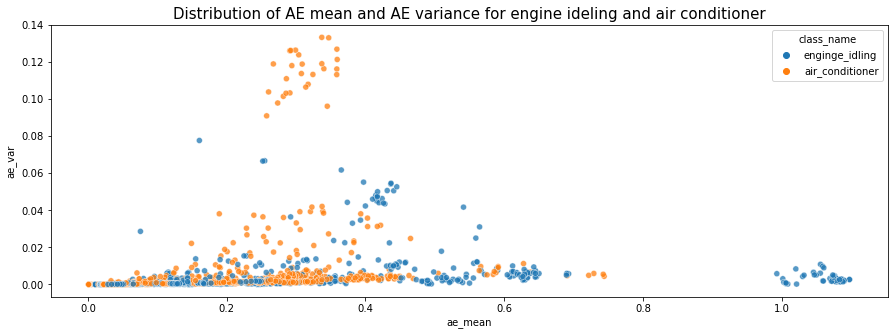

In [972]:
fig = plt.figure(figsize=(15,5))
plt.title("Distribution of AE mean and AE variance for engine ideling and air conditioner", fontsize= 15)
sns.scatterplot(x = "ae_mean",
            y = "ae_var",
            hue = 'class_name',
            data = df2[(df2["class_id"]==5) | (df2["class_id"]==0)], alpha = 0.75
            )

plt.show()

################################################################################################################

## Using classical supervised algorithms to classify the audio 

In [581]:
from sklearn import preprocessing

from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier, XGBRFClassifier

from sklearn.metrics import confusion_matrix, classification_report


In [595]:
x_train_n1 = list(x_train_n)  + list(x_val)
y_train_n1 = list(y_train_n) + list(y_val)

x_train_n1 = np.array(x_train_n1)
y_train_n1 = np.array(y_train_n1)

In [601]:
x_train_n1.shape , y_train_n1.shape

((7808, 34), (7808,))

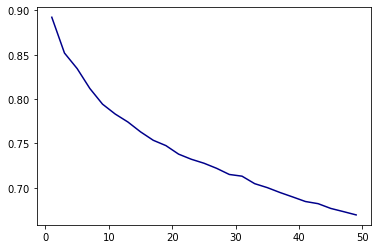

0.44040268659591675 mins
1 0.8921625964511077


In [596]:
# using KNN to classify
import time
from matplotlib import pyplot as plt
from sklearn.model_selection import cross_val_score


# Finding the best value of k by using the method of cross-validation 
s = time.time()
max_score = 0
max_i = -1
x = []
y = []
for i in range(1, 50, 2):
    clf = KNeighborsClassifier(n_neighbors=i)
    score = cross_val_score(clf, x_train_n1, y_train_n1)
    
    if (score.mean() > max_score):
        max_score = score.mean()
        max_i = i
        
    x.append(i)
    y.append(score.mean())
    
plt.plot(x, y, color = "darkblue")
plt.show()

e = time.time()

print((e-s)/60 , "mins")
print(max_i, max_score)

So, here we can see that, KNN performs bad as the no.of clusters increase, so we take some arbirtary k, say k = 3.

We don't take k = 1 as this is very sensitive to all sort of distortions like noise, outliers, mislabelling of data, and so on. By using a higher value for k, you tend to be more robust against those distortions.

In [598]:
clf = KNeighborsClassifier(3)
clf.fit(x_train_n1, y_train_n1)
print("Test socre using 3 nearest neighbours in KNN")
clf.score(x_test_n, y_test_n)

Test socre using 3 nearest neighbours in KNN


0.9047858942065491

In [600]:
y_pred_knn = clf.predict(x_test_n)

print(classification_report(y_test_n, y_pred_knn))

              precision    recall  f1-score   support

           0       0.86      0.97      0.91       212
           1       0.88      0.90      0.89       197
           2       0.81      0.89      0.85       211
           3       0.92      0.82      0.87       194
           4       0.90      0.87      0.89       175
           5       0.91      0.92      0.92       194
           6       0.99      0.97      0.98       189
           7       0.93      0.92      0.93       225
           8       0.97      0.96      0.96       181
           9       0.91      0.81      0.86       207

    accuracy                           0.90      1985
   macro avg       0.91      0.90      0.91      1985
weighted avg       0.91      0.90      0.90      1985



#######################################################################################################################

## Using some Ensemble techniques to classify the features extracted out of the given audio data

### Using Random Forest Classifer to classify the data

In [585]:
from sklearn.metrics  import f1_score, precision_score

In [602]:
# Using RF Clf 

n_est = 41 
rfc = RandomForestClassifier(n_estimators = n_est)

rfc.fit(x_train_n1, y_train_n1)

y_train_pred = rfc.predict(x_train_n1)

print("Train score using", n_est ,"decision trees in random forest classifier",rfc.score(x_train_n1, y_train_n1))
print("F1 score socre using", n_est ,"decision trees in random forest classifier",f1_score(y_train_n1, y_train_pred, average="macro"))

Train score using 41 decision trees in random forest classifier 1.0
F1 score socre using 41 decision trees in random forest classifier 1.0


In [603]:
print(y_test_n.shape)

(1985,)


In [604]:
y_pred_rf = rfc.predict(x_test_n)

### Note:- 
#### Here, no.of estimator are choosen after several experimentations with the training and validation data, so it might be that some other value of the n_est might perform better or worse than the selected 

In [605]:
print("Test score using", n_est ,"decision trees in random forest classifier",rfc.score(x_test_n, y_test_n))
print("F1 score socre using", n_est ,"decision trees in random forest classifier",f1_score(y_test_n, y_pred_rf, average="macro"))

Test score using 41 decision trees in random forest classifier 0.9420654911838791
F1 score socre using 41 decision trees in random forest classifier 0.9422751833109674


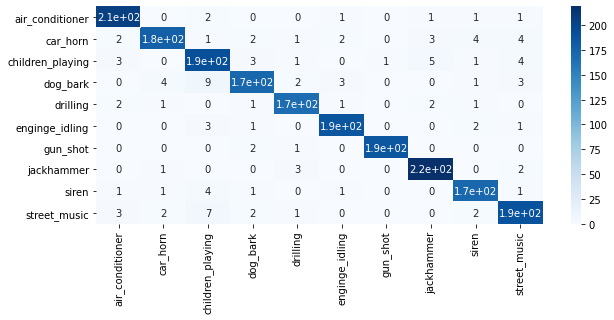

In [606]:
import seaborn as sns

y_pred_rf = rfc.predict(x_test_n)
confusion_mat = confusion_matrix(y_test_n, y_pred_rf)

plt.figure(figsize=(10,4))
plt.xlabel("Predicted class")
plt.ylabel("True class")
sns.heatmap(confusion_mat, annot=True, cmap="Blues", xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()

As seen from the above confusion matrix, there's a slight challenge for the rf classifier to classify children playing

In [607]:
print(classification_report(y_test_n, y_pred_rf))

              precision    recall  f1-score   support

           0       0.95      0.97      0.96       212
           1       0.95      0.90      0.93       197
           2       0.88      0.91      0.90       211
           3       0.93      0.89      0.91       194
           4       0.95      0.95      0.95       175
           5       0.96      0.96      0.96       194
           6       0.99      0.98      0.99       189
           7       0.95      0.97      0.96       225
           8       0.93      0.95      0.94       181
           9       0.92      0.92      0.92       207

    accuracy                           0.94      1985
   macro avg       0.94      0.94      0.94      1985
weighted avg       0.94      0.94      0.94      1985



As we can see, the accuracy is pretty good with **ensemble leanring techniques**, i.e here, random forest classfier. It acheived about 93% testing accuracy.

### Classifying the data with Xtreme Gradient Boosting classifier

In [608]:
xgb_clf  = XGBClassifier()

s = time.time()
xgb_clf.fit(x_train_n1, y_train_n1)
e = time.time()

print((e-s)/60 , " mins")

C:\Users\srevaatsav\anaconda3\lib\site-packages\xgboost\sklearn.py:888: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[18:04:07] WARNING: ..\src\learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
0.17537614107131957  mins


In [610]:
y_pred_train_xgb = xgb_clf.predict(x_train_n1)

print("Train score :- ",xgb_clf.score(x_train_n1, y_train_n1))
print("F1 score on trianing data :- ",f1_score(y_train_n1, y_pred_train_xgb, average="macro"))

Train score :-  1.0
F1 score on trianing data :-  1.0


In [611]:
y_pred_xgb = xgb_clf.predict(x_test_n)

In [612]:
xgb_clf.score(x_test_n, y_test_n)

0.9496221662468514

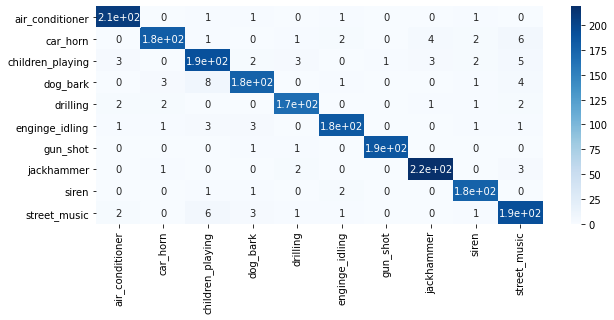

In [613]:
confusion_mat = confusion_matrix(y_test_n, y_pred_xgb)

plt.figure(figsize=(10,4))
plt.xlabel("Predicted class")
plt.ylabel("True class")
sns.heatmap(confusion_mat, annot=True, cmap="Blues", xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()

In [614]:
print(classification_report(y_test_n, y_pred_xgb))

              precision    recall  f1-score   support

           0       0.96      0.98      0.97       212
           1       0.96      0.92      0.94       197
           2       0.91      0.91      0.91       211
           3       0.94      0.91      0.93       194
           4       0.95      0.95      0.95       175
           5       0.96      0.95      0.96       194
           6       0.99      0.99      0.99       189
           7       0.96      0.97      0.97       225
           8       0.95      0.98      0.96       181
           9       0.90      0.93      0.92       207

    accuracy                           0.95      1985
   macro avg       0.95      0.95      0.95      1985
weighted avg       0.95      0.95      0.95      1985



Even the Xtreme Gradient boositing classifier is able to classify the testing samples pretty well

In [1610]:
from sklearn.ensemble import RandomForestClassifier

######################################################################################################################

In [1666]:
from sklearn.ensemble import AdaBoostClassifier 

clf_ada = AdaBoostClassifier(base_estimator = RandomForestClassifier(n_estimators=1, max_depth=10, max_features="log2"), n_estimators = 102)

clf_ada.fit(x_train_n1, y_train_n1)
print("Training accuracy is :-", clf_ada.score(x_train_n1, y_train_n1))

Training accuracy is :- 0.9933401639344263


In [1667]:
y_train_pred_ada = clf_ada.predict(x_train_n1)

print("Training precision score is :-", precision_score(y_train_n1, y_train_pred_ada, average="macro"))
print("Training recall is :-", recall_score(y_train_n1, y_train_pred_ada, average="macro"))

Training precision score is :- 0.9935365686382653
Training recall is :- 0.9934523683795385


In [1668]:
print("Testing accuracy is :-", clf_ada.score(x_test_n, y_test_n))

y_pred_ada = clf_ada.predict(x_test_n)
print()
print("Testing precision score is :-", precision_score(y_test_n, y_pred_ada, average="macro"))
print("Testing recall is :-", recall_score(y_test_n, y_pred_ada, average="macro"))
print()
print("Testing f1 score is :-", f1_score(y_test_n, y_pred_ada, average="macro"))

Testing accuracy is :- 0.9204030226700252

Testing precision score is :- 0.9240892933278243
Testing recall is :- 0.9204413162287368

Testing f1 score is :- 0.9214410406471846


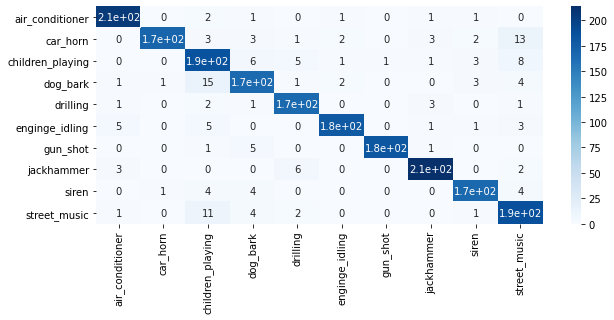

In [1669]:
import seaborn as sns

confusion_mat = confusion_matrix(y_test_n, y_pred_ada)

plt.figure(figsize=(10,4))

plt.xlabel("Predicted class")
plt.ylabel("True class")

sns.heatmap(confusion_mat, annot=True, cmap="Blues", xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()

### Support Vector Machines to classify the data

In [615]:
from sklearn.metrics  import f1_score, precision_score, recall_score

In [616]:
from sklearn.model_selection import GridSearchCV

s = time.time()

clf = SVC(C = 6000, gamma = 10, kernel="rbf")

# clf = SVC()
# grid = {"C":[10, 1e2,1e3],"gamma":[1e-3, 1e-4, 5e-3], "kernel":['linear','rbf',]}
# grid_s = GridSearchCV(clf, grid)
# grid_s.fit(x_train,y_train)
# grid_s.best_params_

clf.fit(x_train_n1, y_train_n1)
print("Training accuracy is :-", clf.score(x_train_n1, y_train_n1))
    
y_train_pred_svm = clf.predict(x_train_n1)

print("Training precision score is :-", precision_score(y_train_n1, y_train_pred_svm, average="macro"))
print("Training recall is :-", recall_score(y_train_n1, y_train_pred_svm, average="macro"))

print()

e = time.time()
print((e-s)/60 , " mins")

Training accuracy is :- 1.0
Training precision score is :- 1.0
Training recall is :- 1.0

0.16581846078236898  mins


* **C**  :- Regularization parameter. The strength of the regularization is inversely proportional to C.
*  **gamma**   :- Kernel coefficient for ‘rbf’, ‘poly’ and ‘sigmoid’ kernels.

In [617]:
print("Testing accuracy is :-", clf.score(x_test_n, y_test_n))

y_pred_svm = clf.predict(x_test_n)
print()
print("Testing precision score is :-", precision_score(y_test_n, y_pred_svm, average="macro"))
print("Testing recall is :-", recall_score(y_test_n, y_pred_svm, average="macro"))
print()
print("Testing f1 score is :-", f1_score(y_test_n, y_pred_svm, average="macro"))

print()

Testing accuracy is :- 0.9556675062972292

Testing precision score is :- 0.9561325672659418
Testing recall is :- 0.9560136189934362

Testing f1 score is :- 0.9559304729081497



### SVMS performed better as far for now, as it was able to achive a testing accuracy of approx 96%  and pretty good precision and recall scores

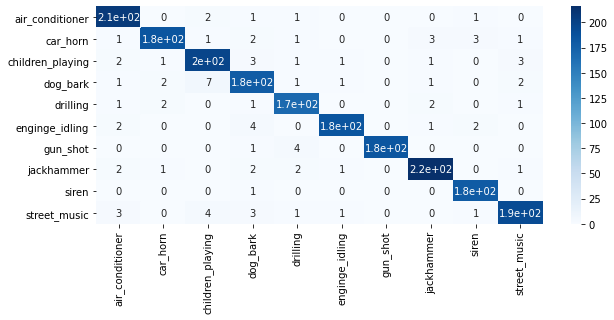

In [618]:
import seaborn as sns

confusion_mat = confusion_matrix(y_test_n, y_pred_svm)

plt.figure(figsize=(10,4))

plt.xlabel("Predicted class")
plt.ylabel("True class")

sns.heatmap(confusion_mat, annot=True, cmap="Blues", xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()

In [619]:
print(classification_report(y_test_n, y_pred_svm))

              precision    recall  f1-score   support

           0       0.95      0.98      0.96       212
           1       0.97      0.94      0.95       197
           2       0.93      0.94      0.94       211
           3       0.91      0.92      0.92       194
           4       0.94      0.96      0.95       175
           5       0.98      0.95      0.97       194
           6       1.00      0.97      0.99       189
           7       0.96      0.96      0.96       225
           8       0.96      0.99      0.98       181
           9       0.96      0.94      0.95       207

    accuracy                           0.96      1985
   macro avg       0.96      0.96      0.96      1985
weighted avg       0.96      0.96      0.96      1985



### Listing out the best classifiers which were able to classify our audio data well.


1. **Suppor Vector machines** :- with about 96% testing accuracy using the audio features extracted and f1 score of about 95.6% with C = 6000 and gamma = 10.


2. **XG Boost classifier** :- with about 95.5% testing accuracy using the audio features extracted with f1 score of 95.6%


3. **Random forest classifier** :- with about 94.4% testing accuracy using the audio features extracted and f1 score of about 95.2% with 41 induvidual decision trees%


.
.
.


As we can see, the ensemble techniques worked pretty well on the given dataset.

Saving the model's trained for further usage

In [1672]:
import pickle

filename = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Classifiers\\svm_clf.sav"
pickle.dump(clf, open(filename, 'wb'))

In [1673]:
filename = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Classifiers\\svm_ada.sav"
pickle.dump(clf_ada, open(filename, 'wb'))

In [1674]:
filename = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Classifiers\\rf_clf.sav"
pickle.dump(rfc, open(filename, 'wb'))

In [1675]:
filename = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Classifiers\\xgb_clf.sav"
pickle.dump(xgb_clf, open(filename, 'wb'))

################################################################################################################################

# Deep learning to classify the audio data

In [620]:
from keras.utils.vis_utils import plot_model

**Converting the output labels into the one hot encoded form**

In [621]:
from tensorflow.keras.utils import to_categorical

y_train = to_categorical(y_train_n, num_classes = 10)
y_test = to_categorical(y_test_n, num_classes =10)

In [628]:
y_val = to_categorical(y_val, num_classes=10)

In [622]:
x_train_n.shape, x_test_n.shape

((6760, 34), (1985, 34))

In [623]:
y_train.shape, y_test.shape

((6760, 10), (1985, 10))

In [624]:
input_shape = x_train_n.shape[1]
print(input_shape)

34


### Starting off by building a very basic neural network and trying to classify 

In [629]:
import tensorflow as tf
import keras
from keras import layers
from keras.models import Sequential

model = Sequential()

model.add(keras.Input(shape=input_shape))

model.add(layers.Dense(124, activation = "tanh"))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(64, activation = "sigmoid"))

model.add(layers.Dense(units = 10, activation = "softmax"))

model.summary()

Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_122 (Dense)           (None, 124)               4340      
                                                                 
 dropout_50 (Dropout)        (None, 124)               0         
                                                                 
 dense_123 (Dense)           (None, 64)                8000      
                                                                 
 dense_124 (Dense)           (None, 10)                650       
                                                                 
Total params: 12,990
Trainable params: 12,990
Non-trainable params: 0
_________________________________________________________________


In [630]:
model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [631]:
import time

batch_size = 32
epochs = 500

es = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience = 3, min_delta=0.005)

s = time.time()
history = model.fit(x_train_n, y_train, batch_size=batch_size, epochs=epochs, validation_data= (x_val ,y_val))
#                      ,callbacks = [es])
e = time.time()
print((e-s)/60, "mins")

Epoch 1/500
212/212 [==============================] - 1s 2ms/step - loss: 2.0049 - accuracy: 0.3206 - val_loss: 1.7733 - val_accuracy: 0.3550
Epoch 2/500
212/212 [==============================] - 0s 1ms/step - loss: 1.5878 - accuracy: 0.4439 - val_loss: 1.5675 - val_accuracy: 0.4237
Epoch 3/500
212/212 [==============================] - 0s 1ms/step - loss: 1.4448 - accuracy: 0.4808 - val_loss: 1.4690 - val_accuracy: 0.4552
Epoch 4/500
212/212 [==============================] - 0s 1ms/step - loss: 1.3733 - accuracy: 0.5095 - val_loss: 1.4116 - val_accuracy: 0.4800
Epoch 5/500
212/212 [==============================] - 0s 1ms/step - loss: 1.3246 - accuracy: 0.5287 - val_loss: 1.3707 - val_accuracy: 0.4943
Epoch 6/500
212/212 [==============================] - 0s 2ms/step - loss: 1.2804 - accuracy: 0.5462 - val_loss: 1.3374 - val_accuracy: 0.5095
Epoch 7/500
212/212 [==============================] - 0s 2ms/step - loss: 1.2578 - accuracy: 0.5497 - val_loss: 1.3127 - val_accuracy: 0.5115

Epoch 58/500
212/212 [==============================] - 0s 2ms/step - loss: 0.8409 - accuracy: 0.7124 - val_loss: 0.8848 - val_accuracy: 0.7109
Epoch 59/500
212/212 [==============================] - 0s 2ms/step - loss: 0.8414 - accuracy: 0.7123 - val_loss: 0.8697 - val_accuracy: 0.7166
Epoch 60/500
212/212 [==============================] - 0s 2ms/step - loss: 0.8286 - accuracy: 0.7124 - val_loss: 0.8689 - val_accuracy: 0.7137
Epoch 61/500
212/212 [==============================] - 0s 2ms/step - loss: 0.8279 - accuracy: 0.7185 - val_loss: 0.8993 - val_accuracy: 0.6975
Epoch 62/500
212/212 [==============================] - 0s 2ms/step - loss: 0.8208 - accuracy: 0.7232 - val_loss: 0.8474 - val_accuracy: 0.7233
Epoch 63/500
212/212 [==============================] - 0s 1ms/step - loss: 0.8239 - accuracy: 0.7142 - val_loss: 0.8523 - val_accuracy: 0.7204
Epoch 64/500
212/212 [==============================] - 0s 2ms/step - loss: 0.8172 - accuracy: 0.7220 - val_loss: 0.8463 - val_accuracy:

Epoch 115/500
212/212 [==============================] - 0s 1ms/step - loss: 0.6891 - accuracy: 0.7732 - val_loss: 0.7447 - val_accuracy: 0.7624
Epoch 116/500
212/212 [==============================] - 0s 1ms/step - loss: 0.6892 - accuracy: 0.7663 - val_loss: 0.7215 - val_accuracy: 0.7710
Epoch 117/500
212/212 [==============================] - 0s 1ms/step - loss: 0.6819 - accuracy: 0.7725 - val_loss: 0.7232 - val_accuracy: 0.7615
Epoch 118/500
212/212 [==============================] - 0s 1ms/step - loss: 0.6771 - accuracy: 0.7734 - val_loss: 0.7292 - val_accuracy: 0.7567
Epoch 119/500
212/212 [==============================] - 0s 1ms/step - loss: 0.6822 - accuracy: 0.7762 - val_loss: 0.7273 - val_accuracy: 0.7586
Epoch 120/500
212/212 [==============================] - 0s 1ms/step - loss: 0.6774 - accuracy: 0.7709 - val_loss: 0.7245 - val_accuracy: 0.7643
Epoch 121/500
212/212 [==============================] - 0s 1ms/step - loss: 0.6774 - accuracy: 0.7714 - val_loss: 0.7137 - val_ac

212/212 [==============================] - 0s 2ms/step - loss: 0.6039 - accuracy: 0.7960 - val_loss: 0.6849 - val_accuracy: 0.7777
Epoch 172/500
212/212 [==============================] - 0s 2ms/step - loss: 0.6078 - accuracy: 0.7964 - val_loss: 0.6553 - val_accuracy: 0.7948
Epoch 173/500
212/212 [==============================] - 0s 2ms/step - loss: 0.6010 - accuracy: 0.7978 - val_loss: 0.6693 - val_accuracy: 0.7891
Epoch 174/500
212/212 [==============================] - 0s 2ms/step - loss: 0.6095 - accuracy: 0.7938 - val_loss: 0.6747 - val_accuracy: 0.7891
Epoch 175/500
212/212 [==============================] - 0s 2ms/step - loss: 0.6053 - accuracy: 0.7979 - val_loss: 0.6594 - val_accuracy: 0.7977
Epoch 176/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5991 - accuracy: 0.7999 - val_loss: 0.6726 - val_accuracy: 0.7805
Epoch 177/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5948 - accuracy: 0.8003 - val_loss: 0.6616 - val_accuracy: 0.7910

212/212 [==============================] - 0s 2ms/step - loss: 0.5525 - accuracy: 0.8127 - val_loss: 0.6166 - val_accuracy: 0.8044
Epoch 228/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5590 - accuracy: 0.8149 - val_loss: 0.6192 - val_accuracy: 0.8139
Epoch 229/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5563 - accuracy: 0.8123 - val_loss: 0.6148 - val_accuracy: 0.8101
Epoch 230/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5524 - accuracy: 0.8182 - val_loss: 0.6215 - val_accuracy: 0.8063
Epoch 231/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5486 - accuracy: 0.8151 - val_loss: 0.6179 - val_accuracy: 0.8063
Epoch 232/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5523 - accuracy: 0.8138 - val_loss: 0.6228 - val_accuracy: 0.7968
Epoch 233/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5461 - accuracy: 0.8178 - val_loss: 0.6185 - val_accuracy: 0.8053

212/212 [==============================] - 0s 2ms/step - loss: 0.5175 - accuracy: 0.8235 - val_loss: 0.5987 - val_accuracy: 0.7977
Epoch 284/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5239 - accuracy: 0.8244 - val_loss: 0.5952 - val_accuracy: 0.8044
Epoch 285/500
212/212 [==============================] - 0s 1ms/step - loss: 0.5193 - accuracy: 0.8243 - val_loss: 0.5943 - val_accuracy: 0.8063
Epoch 286/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5192 - accuracy: 0.8244 - val_loss: 0.5843 - val_accuracy: 0.8073
Epoch 287/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5275 - accuracy: 0.8185 - val_loss: 0.5969 - val_accuracy: 0.8025
Epoch 288/500
212/212 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.8250 - val_loss: 0.6006 - val_accuracy: 0.8034
Epoch 289/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5194 - accuracy: 0.8229 - val_loss: 0.5959 - val_accuracy: 0.8034

212/212 [==============================] - 0s 2ms/step - loss: 0.5011 - accuracy: 0.8333 - val_loss: 0.5636 - val_accuracy: 0.8158
Epoch 340/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4932 - accuracy: 0.8349 - val_loss: 0.5767 - val_accuracy: 0.8158
Epoch 341/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4984 - accuracy: 0.8274 - val_loss: 0.5616 - val_accuracy: 0.8168
Epoch 342/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4908 - accuracy: 0.8359 - val_loss: 0.5726 - val_accuracy: 0.8177
Epoch 343/500
212/212 [==============================] - 0s 2ms/step - loss: 0.5044 - accuracy: 0.8294 - val_loss: 0.5755 - val_accuracy: 0.8130
Epoch 344/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4976 - accuracy: 0.8303 - val_loss: 0.5619 - val_accuracy: 0.8158
Epoch 345/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4973 - accuracy: 0.8269 - val_loss: 0.5577 - val_accuracy: 0.8302

212/212 [==============================] - 0s 2ms/step - loss: 0.4776 - accuracy: 0.8382 - val_loss: 0.5545 - val_accuracy: 0.8177
Epoch 396/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4716 - accuracy: 0.8391 - val_loss: 0.5514 - val_accuracy: 0.8244
Epoch 397/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4697 - accuracy: 0.8423 - val_loss: 0.5677 - val_accuracy: 0.8120
Epoch 398/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4752 - accuracy: 0.8358 - val_loss: 0.5555 - val_accuracy: 0.8206
Epoch 399/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4824 - accuracy: 0.8368 - val_loss: 0.5532 - val_accuracy: 0.8187
Epoch 400/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4727 - accuracy: 0.8432 - val_loss: 0.5625 - val_accuracy: 0.8111
Epoch 401/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4726 - accuracy: 0.8398 - val_loss: 0.5573 - val_accuracy: 0.8177

212/212 [==============================] - 0s 2ms/step - loss: 0.4596 - accuracy: 0.8463 - val_loss: 0.5516 - val_accuracy: 0.8225
Epoch 452/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4626 - accuracy: 0.8425 - val_loss: 0.5394 - val_accuracy: 0.8206
Epoch 453/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4524 - accuracy: 0.8482 - val_loss: 0.5352 - val_accuracy: 0.8273
Epoch 454/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4518 - accuracy: 0.8450 - val_loss: 0.5394 - val_accuracy: 0.8235
Epoch 455/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4480 - accuracy: 0.8466 - val_loss: 0.5611 - val_accuracy: 0.8139
Epoch 456/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4636 - accuracy: 0.8428 - val_loss: 0.5519 - val_accuracy: 0.8254
Epoch 457/500
212/212 [==============================] - 0s 2ms/step - loss: 0.4519 - accuracy: 0.8475 - val_loss: 0.5509 - val_accuracy: 0.8263

<Figure size 432x288 with 0 Axes>

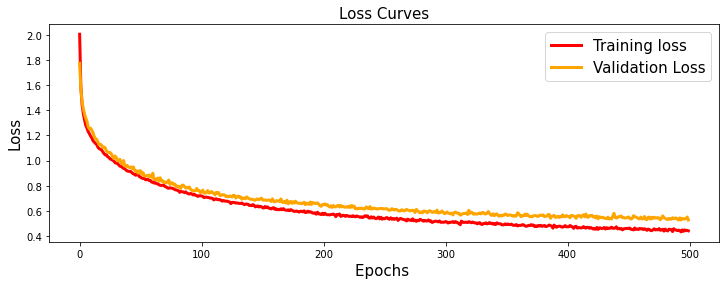

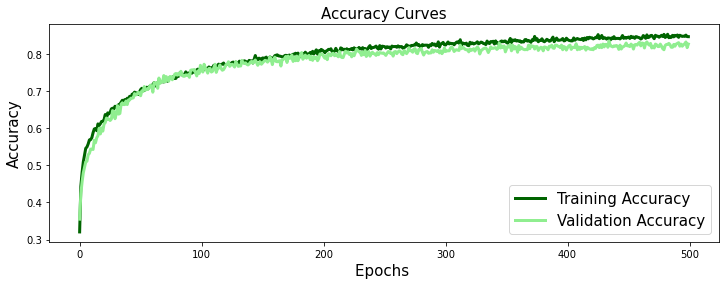

In [632]:
import matplotlib.pyplot as plt

fig = plt.figure()

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(history.history['loss'],'red',linewidth=3.0)
plt.plot(history.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(history.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(history.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [634]:
model.evaluate(x_test_n, y_test)

63/63 [==============================] - 0s 1ms/step - loss: 0.4355 - accuracy: 0.8685


[0.43553873896598816, 0.8685138821601868]

**As we can see the testing accuray is about 87% which is pretty good for this basic model architecture**

### Creating another model, having bit more complex architecture than before, but just a sequential one.

In [635]:
model1 = Sequential()

model1.add(keras.Input(shape=input_shape))
model1.add(layers.Dense(4096 ,activation="tanh"))
model1.add(layers.Dropout(0.35))
model1.add(layers.Dense(2048, activation = "tanh"))
model1.add(layers.Dropout(0.45))
model1.add(layers.Dense(1024, activation = "sigmoid"))
model1.add(layers.Dropout(0.5))
model1.add(layers.Dense(512, activation = "tanh"))
model1.add(layers.Dropout(0.5))
model1.add(layers.Dense(64))
model1.add(layers.Dense(units = 10, activation = "softmax"))

model1.summary()

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_125 (Dense)           (None, 4096)              143360    
                                                                 
 dropout_51 (Dropout)        (None, 4096)              0         
                                                                 
 dense_126 (Dense)           (None, 2048)              8390656   
                                                                 
 dropout_52 (Dropout)        (None, 2048)              0         
                                                                 
 dense_127 (Dense)           (None, 1024)              2098176   
                                                                 
 dropout_53 (Dropout)        (None, 1024)              0         
                                                                 
 dense_128 (Dense)           (None, 512)             

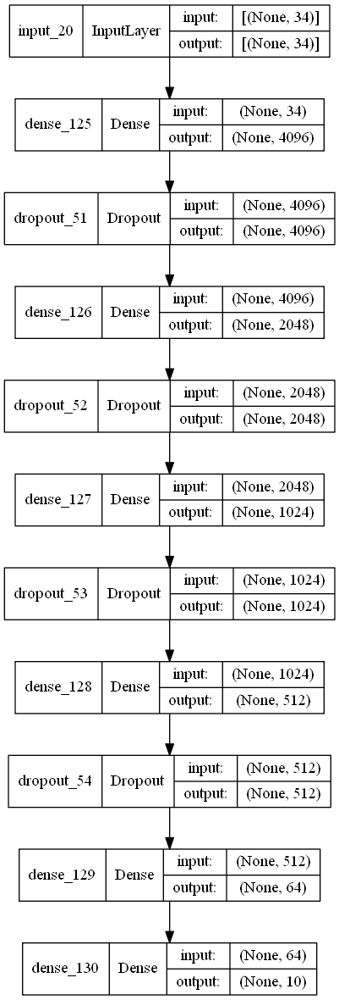

In [636]:
plot_model(model1, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [638]:
model1.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [640]:
import time

batch_size = 32
epochs = 120

# es = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience = 3, min_delta=0.01)

s = time.time()
history1 = model1.fit(x_train_n, y_train, batch_size=batch_size, epochs=epochs, validation_data= (x_val ,y_val))
#                      ,callbacks = [es])
e = time.time()
print((e-s)/60, "mins")

Epoch 1/120
212/212 [==============================] - 10s 48ms/step - loss: 1.5388 - accuracy: 0.4552 - val_loss: 1.3176 - val_accuracy: 0.5124
Epoch 2/120
212/212 [==============================] - 11s 53ms/step - loss: 1.3263 - accuracy: 0.5240 - val_loss: 1.2648 - val_accuracy: 0.5143
Epoch 3/120
212/212 [==============================] - 13s 60ms/step - loss: 1.2508 - accuracy: 0.5464 - val_loss: 1.2949 - val_accuracy: 0.5258
Epoch 4/120
212/212 [==============================] - 13s 60ms/step - loss: 1.2177 - accuracy: 0.5624 - val_loss: 1.1578 - val_accuracy: 0.5668
Epoch 5/120
212/212 [==============================] - 13s 60ms/step - loss: 1.1574 - accuracy: 0.5876 - val_loss: 1.1050 - val_accuracy: 0.5878
Epoch 6/120
212/212 [==============================] - 13s 60ms/step - loss: 1.1368 - accuracy: 0.5967 - val_loss: 1.0852 - val_accuracy: 0.6355
Epoch 7/120
212/212 [==============================] - 13s 60ms/step - loss: 1.0961 - accuracy: 0.6104 - val_loss: 1.1012 - val_ac

212/212 [==============================] - 13s 62ms/step - loss: 0.5242 - accuracy: 0.8185 - val_loss: 0.5441 - val_accuracy: 0.8139
Epoch 58/120
212/212 [==============================] - 13s 62ms/step - loss: 0.5289 - accuracy: 0.8151 - val_loss: 0.6130 - val_accuracy: 0.7958
Epoch 59/120
212/212 [==============================] - 13s 62ms/step - loss: 0.5291 - accuracy: 0.8173 - val_loss: 0.6014 - val_accuracy: 0.8053
Epoch 60/120
212/212 [==============================] - 13s 62ms/step - loss: 0.5069 - accuracy: 0.8257 - val_loss: 0.5973 - val_accuracy: 0.7948
Epoch 61/120
212/212 [==============================] - 17s 79ms/step - loss: 0.5125 - accuracy: 0.8235 - val_loss: 0.6007 - val_accuracy: 0.7939
Epoch 62/120
212/212 [==============================] - 18s 85ms/step - loss: 0.5205 - accuracy: 0.8166 - val_loss: 0.5384 - val_accuracy: 0.8082
Epoch 63/120
212/212 [==============================] - 17s 82ms/step - loss: 0.4985 - accuracy: 0.8274 - val_loss: 0.6313 - val_accuracy

212/212 [==============================] - 17s 80ms/step - loss: 0.4197 - accuracy: 0.8496 - val_loss: 0.5160 - val_accuracy: 0.8311
Epoch 114/120
212/212 [==============================] - 16s 73ms/step - loss: 0.4274 - accuracy: 0.8506 - val_loss: 0.4926 - val_accuracy: 0.8321
Epoch 115/120
212/212 [==============================] - 15s 72ms/step - loss: 0.3897 - accuracy: 0.8611 - val_loss: 0.5971 - val_accuracy: 0.8053
Epoch 116/120
212/212 [==============================] - 15s 71ms/step - loss: 0.4050 - accuracy: 0.8615 - val_loss: 0.5076 - val_accuracy: 0.8378
Epoch 117/120
212/212 [==============================] - 15s 69ms/step - loss: 0.4238 - accuracy: 0.8506 - val_loss: 0.5048 - val_accuracy: 0.8340
Epoch 118/120
212/212 [==============================] - 14s 68ms/step - loss: 0.3939 - accuracy: 0.8648 - val_loss: 0.4989 - val_accuracy: 0.8378
Epoch 119/120
212/212 [==============================] - 14s 66ms/step - loss: 0.4172 - accuracy: 0.8575 - val_loss: 0.5521 - val_ac

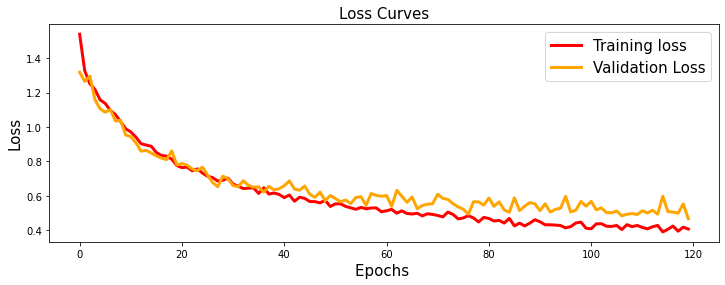

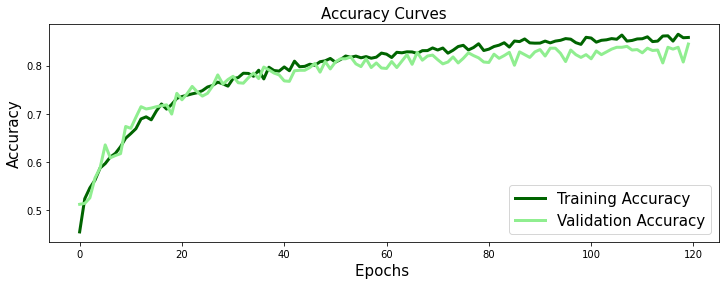

In [641]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(history1.history['loss'],'red',linewidth=3.0)
plt.plot(history1.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(history1.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(history1.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [642]:
model1.evaluate(x_test_n, y_test)

63/63 [==============================] - 1s 12ms/step - loss: 0.3755 - accuracy: 0.8872


[0.37553954124450684, 0.8871536254882812]

In [643]:
def pred_int(y_pred):
    y_pred_int = []
    for i in range(len(y_pred)):
        max_i = 0
        max_p = 0
        for j in range(len(y_pred[i])):
            if y_pred[i][j] > max_p:
                max_p = y_pred[i][j]
                max_i = j
                
        y_pred_int.append(max_i)
        
    return y_pred_int

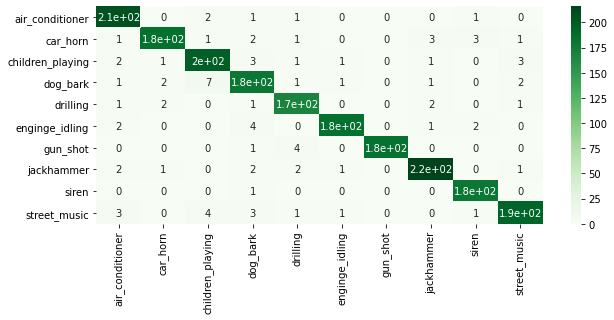

In [644]:
y_pred_m1 = model1.predict(x_test_n)


y_pred_m1 = pred_int(y_pred_m1)
y_test1 = pred_int(y_test)

confusion_mat1 = confusion_matrix(y_test1, y_pred_m1)

plt.figure(figsize=(10,4))

plt.xlabel("Predicted class")
plt.ylabel("True class")

sns.heatmap(confusion_mat, annot=True, cmap="Greens",  xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()

In [645]:
print(classification_report(y_test1, y_pred_m1))

              precision    recall  f1-score   support

           0       0.85      0.96      0.90       212
           1       0.91      0.92      0.91       197
           2       0.76      0.83      0.79       211
           3       0.91      0.74      0.82       194
           4       0.89      0.91      0.90       175
           5       0.93      0.89      0.91       194
           6       0.99      0.96      0.97       189
           7       0.95      0.93      0.94       225
           8       0.91      0.91      0.91       181
           9       0.82      0.82      0.82       207

    accuracy                           0.89      1985
   macro avg       0.89      0.89      0.89      1985
weighted avg       0.89      0.89      0.89      1985



#### We are achiving about 90% accuracy with this model

### Creating another model, this time not a sequential one, but a different one, using kera's functional API

In [646]:
from tensorflow.keras import Model
from tensorflow.keras.layers import Concatenate,Input,Dropout, Dense


input_to_nn = Input(shape = input_shape)

hidden_1 = Dense(512, activation = "tanh")(input_to_nn)
d1 = Dropout(0.45)(hidden_1)
hidden_2 = Dense(128, activation = "tanh")(d1)
d2 = Dropout(0.5)(hidden_2)
hidden_3 = Dense(32, activation = "tanh")(d2)

hidden_4 = Dense(256, activation = "sigmoid")(input_to_nn)
d3 = Dropout(0.4)(hidden_4)
hidden_5 = Dense(64, activation = "sigmoid")(d3)
d4 = Dropout(0.45)(hidden_5)
hidden_6 = Dense(16, activation = "sigmoid")(d4)

concat = Concatenate()([hidden_3, hidden_6])

dense1 = Dense(512, activation = "tanh")(concat)
dense2 = Dense(128, activation = "relu")(dense1)
output = Dense(10, activation = "softmax")(dense2)

model2 = Model(inputs = [input_to_nn], outputs = [output])

model2.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_21 (InputLayer)          [(None, 34)]         0           []                               
                                                                                                  
 dense_131 (Dense)              (None, 512)          17920       ['input_21[0][0]']               
                                                                                                  
 dense_134 (Dense)              (None, 256)          8960        ['input_21[0][0]']               
                                                                                                  
 dropout_55 (Dropout)           (None, 512)          0           ['dense_131[0][0]']              
                                                                                            

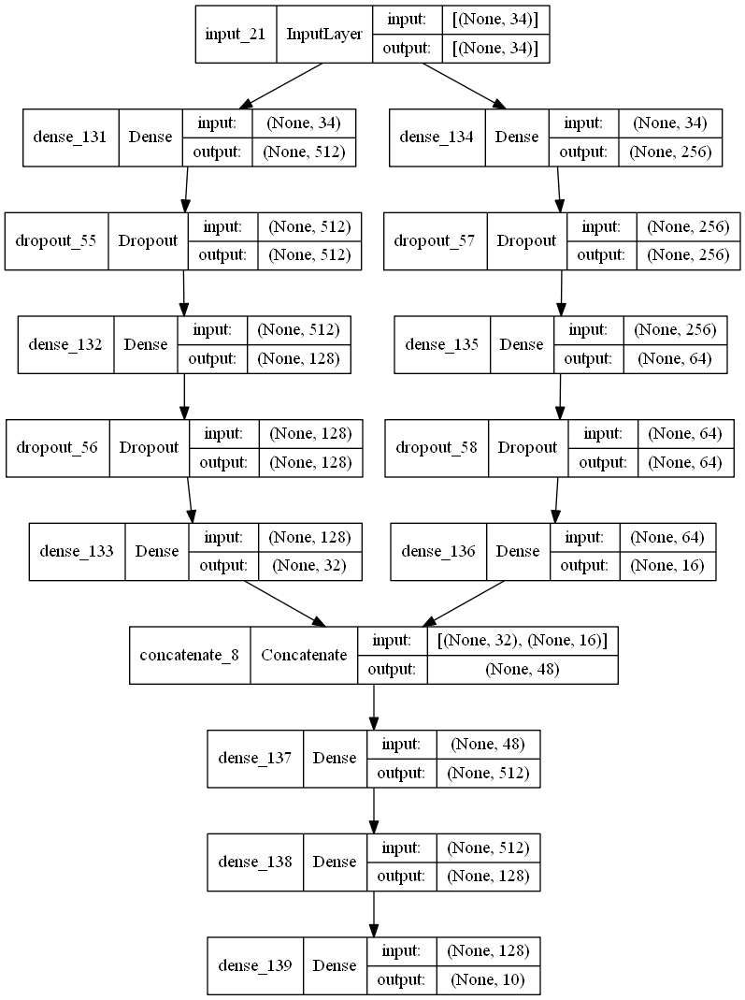

In [647]:
plot_model(model2, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [648]:
model2.compile(optimizer="adam", loss= "categorical_crossentropy", metrics= ["accuracy"])

In [649]:
hist2 = model2.fit(x_train_n , y_train, epochs=500, batch_size = 32, validation_data= (x_val ,y_val))

Epoch 1/500
212/212 [==============================] - 1s 4ms/step - loss: 1.5770 - accuracy: 0.4189 - val_loss: 1.3241 - val_accuracy: 0.5153
Epoch 2/500
212/212 [==============================] - 1s 3ms/step - loss: 1.2904 - accuracy: 0.5232 - val_loss: 1.2624 - val_accuracy: 0.5010
Epoch 3/500
212/212 [==============================] - 1s 3ms/step - loss: 1.2063 - accuracy: 0.5567 - val_loss: 1.1373 - val_accuracy: 0.5677
Epoch 4/500
212/212 [==============================] - 1s 3ms/step - loss: 1.1772 - accuracy: 0.5762 - val_loss: 1.0969 - val_accuracy: 0.5926
Epoch 5/500
212/212 [==============================] - 1s 3ms/step - loss: 1.0969 - accuracy: 0.6012 - val_loss: 1.2372 - val_accuracy: 0.5353
Epoch 6/500
212/212 [==============================] - 1s 3ms/step - loss: 1.0953 - accuracy: 0.6089 - val_loss: 1.0262 - val_accuracy: 0.6260
Epoch 7/500
212/212 [==============================] - 1s 3ms/step - loss: 1.0415 - accuracy: 0.6209 - val_loss: 1.0018 - val_accuracy: 0.6450

Epoch 58/500
212/212 [==============================] - 1s 4ms/step - loss: 0.5915 - accuracy: 0.7907 - val_loss: 0.6244 - val_accuracy: 0.7767
Epoch 59/500
212/212 [==============================] - 1s 4ms/step - loss: 0.6079 - accuracy: 0.7876 - val_loss: 0.6243 - val_accuracy: 0.7939
Epoch 60/500
212/212 [==============================] - 1s 4ms/step - loss: 0.5814 - accuracy: 0.7942 - val_loss: 0.5963 - val_accuracy: 0.8006
Epoch 61/500
212/212 [==============================] - 1s 3ms/step - loss: 0.5945 - accuracy: 0.7925 - val_loss: 0.6076 - val_accuracy: 0.7853
Epoch 62/500
212/212 [==============================] - 1s 3ms/step - loss: 0.5825 - accuracy: 0.7947 - val_loss: 0.6044 - val_accuracy: 0.7920
Epoch 63/500
212/212 [==============================] - 1s 3ms/step - loss: 0.5707 - accuracy: 0.7972 - val_loss: 0.6296 - val_accuracy: 0.7987
Epoch 64/500
212/212 [==============================] - 1s 3ms/step - loss: 0.6033 - accuracy: 0.7833 - val_loss: 0.6137 - val_accuracy:

212/212 [==============================] - 1s 3ms/step - loss: 0.4331 - accuracy: 0.8430 - val_loss: 0.5242 - val_accuracy: 0.8340
Epoch 115/500
212/212 [==============================] - 1s 3ms/step - loss: 0.4361 - accuracy: 0.8439 - val_loss: 0.5020 - val_accuracy: 0.8445
Epoch 116/500
212/212 [==============================] - 1s 3ms/step - loss: 0.4321 - accuracy: 0.8487 - val_loss: 0.5525 - val_accuracy: 0.8197
Epoch 117/500
212/212 [==============================] - 1s 3ms/step - loss: 0.4439 - accuracy: 0.8393 - val_loss: 0.5309 - val_accuracy: 0.8263
Epoch 118/500
212/212 [==============================] - 1s 3ms/step - loss: 0.4460 - accuracy: 0.8382 - val_loss: 0.5264 - val_accuracy: 0.8101
Epoch 119/500
212/212 [==============================] - 1s 3ms/step - loss: 0.4273 - accuracy: 0.8482 - val_loss: 0.5192 - val_accuracy: 0.8149
Epoch 120/500
212/212 [==============================] - 1s 3ms/step - loss: 0.4378 - accuracy: 0.8479 - val_loss: 0.5287 - val_accuracy: 0.8263

212/212 [==============================] - 1s 3ms/step - loss: 0.3308 - accuracy: 0.8848 - val_loss: 0.5316 - val_accuracy: 0.8321
Epoch 171/500
212/212 [==============================] - 1s 3ms/step - loss: 0.3424 - accuracy: 0.8791 - val_loss: 0.5115 - val_accuracy: 0.8349
Epoch 172/500
212/212 [==============================] - 1s 3ms/step - loss: 0.3470 - accuracy: 0.8775 - val_loss: 0.5266 - val_accuracy: 0.8349
Epoch 173/500
212/212 [==============================] - 1s 3ms/step - loss: 0.3485 - accuracy: 0.8766 - val_loss: 0.5024 - val_accuracy: 0.8359
Epoch 174/500
212/212 [==============================] - 1s 3ms/step - loss: 0.3283 - accuracy: 0.8818 - val_loss: 0.5176 - val_accuracy: 0.8397
Epoch 175/500
212/212 [==============================] - 1s 3ms/step - loss: 0.3300 - accuracy: 0.8825 - val_loss: 0.5504 - val_accuracy: 0.8387
Epoch 176/500
212/212 [==============================] - 1s 3ms/step - loss: 0.3389 - accuracy: 0.8809 - val_loss: 0.4954 - val_accuracy: 0.8483

212/212 [==============================] - 1s 4ms/step - loss: 0.3092 - accuracy: 0.8880 - val_loss: 0.4890 - val_accuracy: 0.8511
Epoch 227/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2767 - accuracy: 0.9033 - val_loss: 0.4662 - val_accuracy: 0.8664
Epoch 228/500
212/212 [==============================] - 1s 4ms/step - loss: 0.3034 - accuracy: 0.8902 - val_loss: 0.4812 - val_accuracy: 0.8550
Epoch 229/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2880 - accuracy: 0.8976 - val_loss: 0.4830 - val_accuracy: 0.8473
Epoch 230/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2786 - accuracy: 0.9009 - val_loss: 0.5000 - val_accuracy: 0.8588
Epoch 231/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2929 - accuracy: 0.8973 - val_loss: 0.5153 - val_accuracy: 0.8521
Epoch 232/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2725 - accuracy: 0.9030 - val_loss: 0.4732 - val_accuracy: 0.8540

212/212 [==============================] - 1s 4ms/step - loss: 0.2539 - accuracy: 0.9084 - val_loss: 0.4804 - val_accuracy: 0.8511
Epoch 283/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2543 - accuracy: 0.9108 - val_loss: 0.5639 - val_accuracy: 0.8406
Epoch 284/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2480 - accuracy: 0.9089 - val_loss: 0.5438 - val_accuracy: 0.8445
Epoch 285/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2825 - accuracy: 0.9012 - val_loss: 0.4727 - val_accuracy: 0.8578
Epoch 286/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2537 - accuracy: 0.9099 - val_loss: 0.5260 - val_accuracy: 0.8454
Epoch 287/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2745 - accuracy: 0.9050 - val_loss: 0.5122 - val_accuracy: 0.8531
Epoch 288/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2661 - accuracy: 0.9089 - val_loss: 0.5323 - val_accuracy: 0.8588

212/212 [==============================] - 1s 4ms/step - loss: 0.2302 - accuracy: 0.9185 - val_loss: 0.5733 - val_accuracy: 0.8502
Epoch 339/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2545 - accuracy: 0.9148 - val_loss: 0.4640 - val_accuracy: 0.8559
Epoch 340/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2387 - accuracy: 0.9149 - val_loss: 0.5447 - val_accuracy: 0.8511
Epoch 341/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2366 - accuracy: 0.9170 - val_loss: 0.5507 - val_accuracy: 0.8521
Epoch 342/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2520 - accuracy: 0.9123 - val_loss: 0.5117 - val_accuracy: 0.8550
Epoch 343/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2360 - accuracy: 0.9175 - val_loss: 0.5015 - val_accuracy: 0.8511
Epoch 344/500
212/212 [==============================] - 1s 4ms/step - loss: 0.2535 - accuracy: 0.9086 - val_loss: 0.4903 - val_accuracy: 0.8540

212/212 [==============================] - 1s 3ms/step - loss: 0.2229 - accuracy: 0.9232 - val_loss: 0.5067 - val_accuracy: 0.8502
Epoch 395/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2378 - accuracy: 0.9179 - val_loss: 0.5579 - val_accuracy: 0.8540
Epoch 396/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2246 - accuracy: 0.9213 - val_loss: 0.5118 - val_accuracy: 0.8655
Epoch 397/500
212/212 [==============================] - 1s 3ms/step - loss: 0.1913 - accuracy: 0.9318 - val_loss: 0.6202 - val_accuracy: 0.8378
Epoch 398/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2253 - accuracy: 0.9204 - val_loss: 0.5331 - val_accuracy: 0.8464
Epoch 399/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2178 - accuracy: 0.9238 - val_loss: 0.5468 - val_accuracy: 0.8569
Epoch 400/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2290 - accuracy: 0.9209 - val_loss: 0.5607 - val_accuracy: 0.8616

212/212 [==============================] - 1s 3ms/step - loss: 0.2155 - accuracy: 0.9277 - val_loss: 0.4792 - val_accuracy: 0.8750
Epoch 451/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2165 - accuracy: 0.9243 - val_loss: 0.5579 - val_accuracy: 0.8502
Epoch 452/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2103 - accuracy: 0.9263 - val_loss: 0.5346 - val_accuracy: 0.8626
Epoch 453/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2159 - accuracy: 0.9244 - val_loss: 0.5515 - val_accuracy: 0.8531
Epoch 454/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2016 - accuracy: 0.9320 - val_loss: 0.5210 - val_accuracy: 0.8588
Epoch 455/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2181 - accuracy: 0.9274 - val_loss: 0.5528 - val_accuracy: 0.8454
Epoch 456/500
212/212 [==============================] - 1s 3ms/step - loss: 0.2200 - accuracy: 0.9250 - val_loss: 0.5065 - val_accuracy: 0.8645

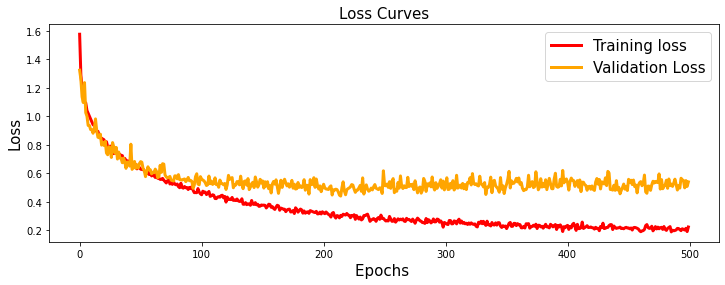

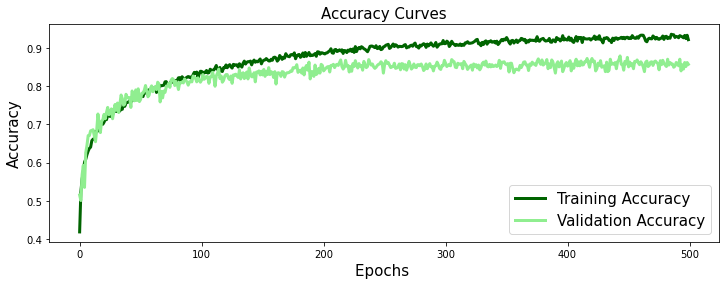

In [650]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(hist2.history['loss'],'red',linewidth=3.0)
plt.plot(hist2.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist2.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(hist2.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [652]:
model2.evaluate(x_test_n, y_test)

63/63 [==============================] - 0s 2ms/step - loss: 0.3676 - accuracy: 0.9174


[0.36762091517448425, 0.9173803329467773]

In [994]:
y_pred_m2 = model2.predict(x_test_n)
y_pred_m2 = pred_int(y_pred_m2)

In [998]:
print(classification_report(pred_int(y_test), y_pred_m2))

              precision    recall  f1-score   support

           0       0.93      0.96      0.95       212
           1       0.89      0.92      0.91       197
           2       0.85      0.84      0.85       211
           3       0.88      0.83      0.85       194
           4       0.92      0.91      0.92       175
           5       0.95      0.95      0.95       194
           6       0.99      0.96      0.98       189
           7       0.95      0.96      0.95       225
           8       0.89      0.96      0.92       181
           9       0.92      0.88      0.90       207

    accuracy                           0.92      1985
   macro avg       0.92      0.92      0.92      1985
weighted avg       0.92      0.92      0.92      1985



#### Accuarcy for this model is pretty good but let's build another graph based model to classify the data better.

In [653]:
input_shape1 = (34)

In [654]:
from keras.layers import AlphaDropout, BatchNormalization

In [659]:
input_to_nn = Input(shape = input_shape1)

hidden_1 = Dense(2048,  activation='selu',kernel_initializer='lecun_normal' )(input_to_nn)
bn1 = BatchNormalization()(hidden_1)

hidden_2 = Dense(1024, activation='selu',kernel_initializer='lecun_normal')(bn1)
bn2 = BatchNormalization()(hidden_2)

hidden_3 = Dense(512,  activation='selu',kernel_initializer='lecun_normal')(bn2)
bn3 = BatchNormalization()(hidden_3)

hidden_4 = Dense(256,  activation='selu',kernel_initializer='lecun_normal')(bn3)
bn4 = BatchNormalization()(hidden_4)

hidden_5 = Dense(128,  activation='selu',kernel_initializer='lecun_normal')(bn4)
bn5 = BatchNormalization()(hidden_5)

d1 = AlphaDropout(0.5)(bn5)


hidden_6 = Dense(1024, activation = "elu")(input_to_nn)
bn6 = BatchNormalization()(hidden_6)

hidden_7 = Dense(256, activation = "elu")(bn6)
bn7 = BatchNormalization()(hidden_7)

hidden_8 = Dense(64, activation = "elu")(bn7)
bn8 = BatchNormalization()(hidden_8)

hidden_9 = Dense(32, activation = "elu")(bn8)
bn9 = BatchNormalization()(hidden_9)

hidden_10 = Dense(16, activation = "elu")(bn9)
bn10 = BatchNormalization()(hidden_10)

d2 = AlphaDropout(0.5)(bn10)


concat = Concatenate()([d1, d2])

dense1 = Dense(64, activation = "selu", kernel_initializer='lecun_normal')(concat)
d3 = AlphaDropout(0.5)(dense1)
dense2 = Dense(32, activation = "elu")(d3)

output = Dense(10, activation = "softmax")(dense2)

model3 = Model(inputs = [input_to_nn], outputs = [output])

model3.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_23 (InputLayer)          [(None, 34)]         0           []                               
                                                                                                  
 dense_153 (Dense)              (None, 2048)         71680       ['input_23[0][0]']               
                                                                                                  
 dense_158 (Dense)              (None, 1024)         35840       ['input_23[0][0]']               
                                                                                                  
 batch_normalization_53 (BatchN  (None, 2048)        8192        ['dense_153[0][0]']              
 ormalization)                                                                              

### In this model, which we created, we used some good techniques to train the model even more better, like selecting  better activation functions (SeLU and ELU) which would avoid the vanishig gradient problem and the "Dead ReLU" problem. 

### Also, we layed down Batch Normalization for each layer of the neual network, which definitly improves the overall performance of the model

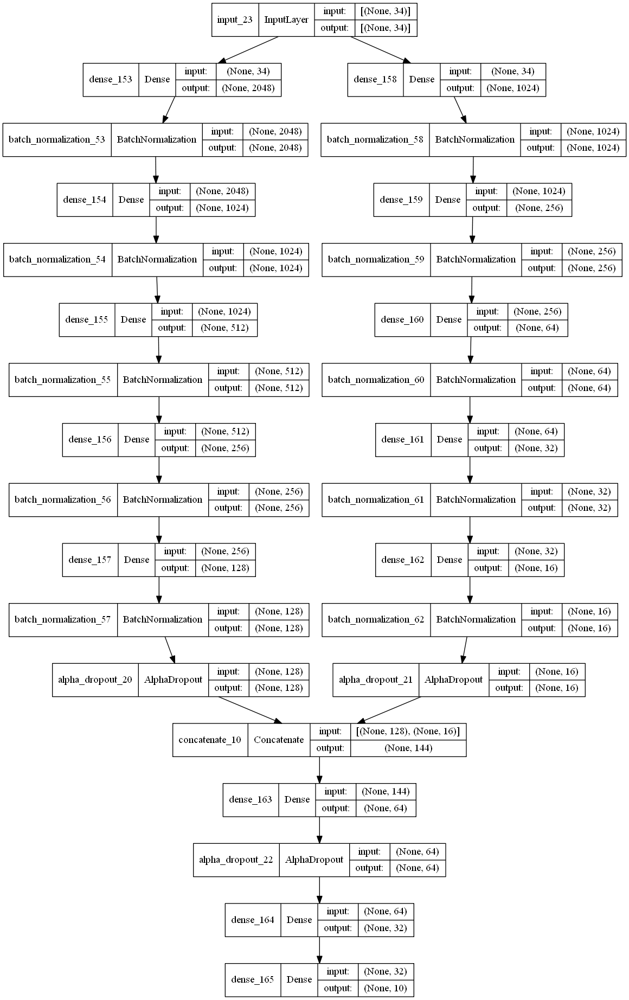

In [660]:
plot_model(model3, show_shapes=True, show_layer_names=True)

In [661]:
model3.compile(optimizer="adam", loss= "categorical_crossentropy", metrics= ["accuracy"])

In [662]:
hist3 = model3.fit(x_train_n , y_train, epochs=200, batch_size = 32, validation_data= (x_val ,y_val))

Epoch 1/200
212/212 [==============================] - 6s 20ms/step - loss: 1.8649 - accuracy: 0.3478 - val_loss: 1.8199 - val_accuracy: 0.5191
Epoch 2/200
212/212 [==============================] - 4s 21ms/step - loss: 1.4724 - accuracy: 0.4901 - val_loss: 2.0573 - val_accuracy: 0.5658
Epoch 3/200
212/212 [==============================] - 4s 20ms/step - loss: 1.2980 - accuracy: 0.5512 - val_loss: 2.0478 - val_accuracy: 0.6069
Epoch 4/200
212/212 [==============================] - 4s 20ms/step - loss: 1.1873 - accuracy: 0.5985 - val_loss: 1.7247 - val_accuracy: 0.6441
Epoch 5/200
212/212 [==============================] - 5s 21ms/step - loss: 1.1013 - accuracy: 0.6320 - val_loss: 1.8136 - val_accuracy: 0.6832
Epoch 6/200
212/212 [==============================] - 5s 23ms/step - loss: 1.0186 - accuracy: 0.6612 - val_loss: 1.4282 - val_accuracy: 0.7271
Epoch 7/200
212/212 [==============================] - 5s 23ms/step - loss: 0.9581 - accuracy: 0.6925 - val_loss: 1.7703 - val_accuracy:

212/212 [==============================] - 5s 26ms/step - loss: 0.1957 - accuracy: 0.9404 - val_loss: 1.6262 - val_accuracy: 0.8473
Epoch 58/200
212/212 [==============================] - 5s 25ms/step - loss: 0.2274 - accuracy: 0.9315 - val_loss: 1.4652 - val_accuracy: 0.8511
Epoch 59/200
212/212 [==============================] - 5s 24ms/step - loss: 0.2094 - accuracy: 0.9349 - val_loss: 1.2910 - val_accuracy: 0.8683
Epoch 60/200
212/212 [==============================] - 5s 24ms/step - loss: 0.2024 - accuracy: 0.9367 - val_loss: 1.3416 - val_accuracy: 0.8655
Epoch 61/200
212/212 [==============================] - 5s 24ms/step - loss: 0.2109 - accuracy: 0.9362 - val_loss: 1.1152 - val_accuracy: 0.8760
Epoch 62/200
212/212 [==============================] - 5s 24ms/step - loss: 0.1990 - accuracy: 0.9408 - val_loss: 0.9354 - val_accuracy: 0.8884
Epoch 63/200
212/212 [==============================] - 5s 24ms/step - loss: 0.1677 - accuracy: 0.9507 - val_loss: 1.1715 - val_accuracy: 0.868

212/212 [==============================] - 6s 26ms/step - loss: 0.1323 - accuracy: 0.9580 - val_loss: 1.0651 - val_accuracy: 0.8922
Epoch 114/200
212/212 [==============================] - 5s 26ms/step - loss: 0.1384 - accuracy: 0.9598 - val_loss: 0.7397 - val_accuracy: 0.8969
Epoch 115/200
212/212 [==============================] - 5s 25ms/step - loss: 0.1252 - accuracy: 0.9626 - val_loss: 0.9960 - val_accuracy: 0.8960
Epoch 116/200
212/212 [==============================] - 5s 25ms/step - loss: 0.1200 - accuracy: 0.9654 - val_loss: 0.9427 - val_accuracy: 0.8931
Epoch 117/200
212/212 [==============================] - 5s 25ms/step - loss: 0.1162 - accuracy: 0.9678 - val_loss: 0.9363 - val_accuracy: 0.9132
Epoch 118/200
212/212 [==============================] - 5s 24ms/step - loss: 0.1235 - accuracy: 0.9648 - val_loss: 1.0607 - val_accuracy: 0.9036
Epoch 119/200
212/212 [==============================] - 5s 24ms/step - loss: 0.1369 - accuracy: 0.9587 - val_loss: 0.7871 - val_accuracy:

212/212 [==============================] - 6s 27ms/step - loss: 0.0983 - accuracy: 0.9707 - val_loss: 1.3259 - val_accuracy: 0.8989
Epoch 170/200
212/212 [==============================] - 6s 27ms/step - loss: 0.0857 - accuracy: 0.9754 - val_loss: 1.5597 - val_accuracy: 0.8721
Epoch 171/200
212/212 [==============================] - 6s 26ms/step - loss: 0.0854 - accuracy: 0.9731 - val_loss: 0.9579 - val_accuracy: 0.9094
Epoch 172/200
212/212 [==============================] - 6s 27ms/step - loss: 0.0895 - accuracy: 0.9728 - val_loss: 1.1370 - val_accuracy: 0.9055
Epoch 173/200
212/212 [==============================] - 6s 27ms/step - loss: 0.0836 - accuracy: 0.9756 - val_loss: 1.6311 - val_accuracy: 0.8655
Epoch 174/200
212/212 [==============================] - 6s 27ms/step - loss: 0.0986 - accuracy: 0.9704 - val_loss: 0.8912 - val_accuracy: 0.9160
Epoch 175/200
212/212 [==============================] - 6s 27ms/step - loss: 0.0879 - accuracy: 0.9740 - val_loss: 0.9868 - val_accuracy:

Took about 18 mins to train this model,whcih consisted 3,177,082 trainable parameters

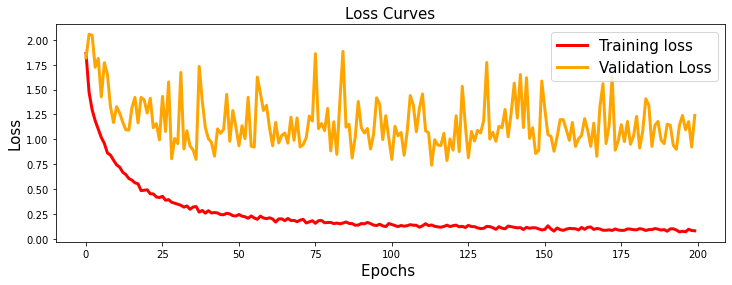

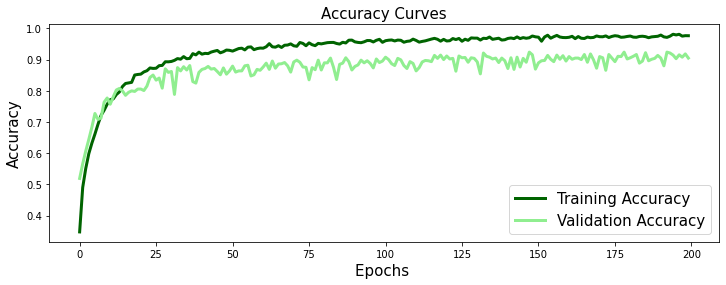

In [663]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(hist3.history['loss'],'red',linewidth=3.0)
plt.plot(hist3.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist3.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(hist3.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [671]:
model3.evaluate(x_test_n, y_test)

63/63 [==============================] - 1s 10ms/step - loss: 0.6484 - accuracy: 0.9481


[0.648350179195404, 0.948110818862915]

Here, as we can see, the **validation loss fluctuates** a bit rigoursly, which could be treated by better regularization, such as Dropout or L1/L2 regularization on the weights or activations.

**This also happens when the validation data is biased**

But the model performs good on the testing data, with about 95% accuarcy

In [665]:
# Fuction to convert one-hot encoded labels into the integer ones

def pred_int(y_pred):
    y_pred_int = []
    for i in range(len(y_pred)):
        max_i = 0
        max_p = 0
        for j in range(len(y_pred[i])):
            if y_pred[i][j] > max_p:
                max_p = y_pred[i][j]
                max_i = j
                
        y_pred_int.append(max_i)
        
    return y_pred_int

### Testing on some randomly seletected 5 samples from the testing dataset, with the model3

In [672]:
import random
test_samples = []
sample_classes = []

for i in range(5):
    random_number = random.randint(0, len(x_test_n)-1)
    test_samples.append(x_test_n[random_number])
    
    y_curr = y_test[random_number]
    for j in range(len(y_curr)):
        if y_curr[j] == 1:
            sample_classes.append(j)
            break
                        
sample_classes

[6, 7, 5, 8, 3]

In [673]:
test_samples = np.array(test_samples)
print(test_samples.shape)

(5, 34)


In [674]:
y_pred_p = model3.predict(test_samples)
    
y_true = sample_classes

y_pred_p  = pred_int(y_pred_p)

    
print("Predicted labels      True lebels")
print(y_pred_p, "    ",y_true)
print()


Predicted labels      True lebels
[6, 7, 5, 8, 3]      [6, 7, 5, 8, 3]



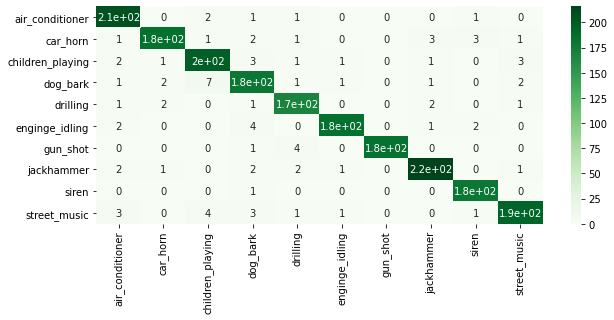

In [675]:
y_pred_m3 = model3.predict(x_test_n)

y_pred_m3 = pred_int(y_pred_m3)

y_test3 = pred_int(y_test)

confusion_mat3 = confusion_matrix(y_test3, y_pred_m3)

plt.figure(figsize=(10,4))

plt.xlabel("Predicted class")
plt.ylabel("True class")

sns.heatmap(confusion_mat, annot=True, cmap="Greens",  xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()

In [676]:
print(classification_report(y_test3, y_pred_m3))

              precision    recall  f1-score   support

           0       0.96      0.92      0.94       212
           1       0.99      0.94      0.96       197
           2       0.94      0.91      0.92       211
           3       0.94      0.91      0.92       194
           4       0.96      0.94      0.95       175
           5       0.99      0.94      0.97       194
           6       1.00      0.99      0.99       189
           7       0.89      1.00      0.94       225
           8       0.93      0.99      0.96       181
           9       0.91      0.95      0.93       207

    accuracy                           0.95      1985
   macro avg       0.95      0.95      0.95      1985
weighted avg       0.95      0.95      0.95      1985



### By far, the highest accuracy achived is by model 3, with approx 95% accuracy on the testing data

# Using only MFCCs to classify the data

### Extracting MFCCs (Mel Frequency Cepstral Coefficients)

1. Describes the large structures of the spectrum
2. Ignores the fine spectral structrues

MFCCs are good data features to extract high frequency and low frequency information about the audio signals.

In [751]:
Y = [data_paths[i][1] for i in range(len(data_paths))]
Y

[3,
 3,
 3,
 3,
 3,
 5,
 5,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 3,
 3,
 3,
 3,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 3,
 3,
 3,
 4,
 3,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 8,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 9,
 9,
 9,
 9,
 9,
 9,
 5,
 5,
 5,
 5,
 1,
 6,
 6,
 6,
 6,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 3,
 3,
 3,
 9,
 9,
 9,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 6,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 1,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 2,
 2,
 2,
 2,
 2,
 2,
 2,


**While extracting MFCCs and storing them, we need to pad them in order that the numpy array storing them would have the same dimension as we need to train a CNN, which would require a proper matrix, this is done as some of the audio files might not be having the duration such that would make all the shapes of the mfccs the same**


<img src = "https://sparrow.dev/wp-content/uploads/2021/03/numpy-pad.png" >

In [307]:
max_pad_len = 174
def extract_features(file_name):
    audio, sample_rate = librosa.load(file_name, res_type='kaiser_fast') 
    mfccs = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=40)
    pad_width = max_pad_len - mfccs.shape[1]
    mfccs = np.pad(mfccs, pad_width=((0, 0), (0, pad_width)), mode='constant')
        
    return mfccs

extract_features(data_paths[0][0]).shape

(40, 174)

In [752]:
# Extracting the MFCCs all the audio files given (training + testing)
s = time.time()

mfccs_arr = []

for i in range(len(data_paths)):
    mfccs_arr.append(extract_features(data_paths[i][0]))
#     print(i)
    
e = time.time()
print((e-s)/60, "mins")

C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1323
  warnings.warn(
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1103
  warnings.warn(
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1523
  warnings.warn(


8.600433834393819 mins


In [753]:
mfccs_arr = np.array(mfccs_arr)

In [754]:
mfccs_arr.shape

(8732, 40, 174)

In [900]:
# Splitting the entire data into testing and training.

X_train, X_test, Y_train, Y_test = train_test_split(mfccs_arr, np.array(Y), random_state = 0)

In [901]:
num_rows = 40
num_columns = 174
num_channels = 1

# Reshaping the data to feed it through a CNN

X_train = X_train.reshape(X_train.shape[0], num_rows, num_columns, num_channels)
X_test = X_test.reshape(X_test.shape[0], num_rows, num_columns, num_channels)
print(X_train.shape)

(6549, 40, 174, 1)


In [902]:
num_labels = len(Y)
num_labels

8732

In [827]:
# Y_val = np.array(Y_val)
# Y_val.shape

In [864]:
# Y_train = np.array(Y_train)

In [903]:
X_train, X_val, Y_train, Y_val = train_test_split(X_train, Y_train, test_size=0.15,random_state = 0)

print(X_train.shape , X_val.shape, Y_train.shape, Y_val.shape)

(5566, 40, 174, 1) (983, 40, 174, 1) (5566,) (983,)


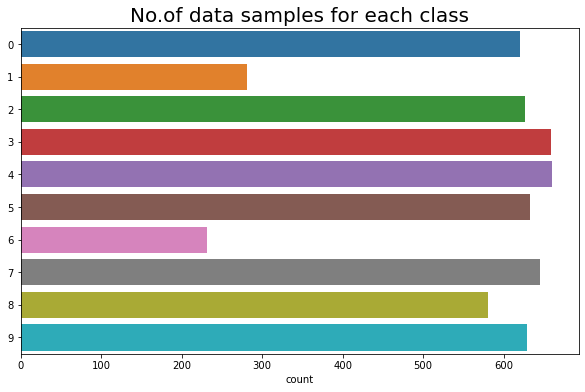

In [904]:
fig = plt.figure(figsize=(10,6))
plt.title("No.of data samples for each class", fontsize= 20)
sns.countplot(y = Y_train, orient="h")
plt.show()

In [905]:
Y_train.shape, Y_val.shape

((5566,), (983,))

In [906]:
input_shape = (num_rows, num_columns, num_channels)

In [908]:
temp_gun = []
temp_car = []

for i in range(len(y_train_int)):
    
    if y_train_int[i] == 1:
        temp_car.append(X_train[i])
        
    if y_train_int[i] == 6:
        temp_gun.append(X_train[i])

In [909]:
target_size = 600

In [910]:
print(len(temp_gun), len(temp_car))

231 281


In [911]:
t_s_car = target_size - len(temp_car)
t_s_gun = target_size - len(temp_gun)
print(t_s_car , t_s_gun)

319 369


In [912]:
upsample_gun = []
upsample_car = []

y_up_car = []
y_up_gun = []

In [913]:
for i in range(t_s_car):
    ind = random.randint(0, len(temp_car)-1)
    upsample_car.append(temp_car[ind])
    y_up_car.append(1)
    
for i in range(t_s_gun):
    ind = random.randint(0, len(temp_gun)-1)
    upsample_gun.append(temp_gun[ind])
    y_up_gun.append(6)

In [914]:
len(upsample_car), len(upsample_gun)

(319, 369)

In [915]:
print(len(y_up_car), len(y_up_gun))

319 369


In [916]:
X_train = list(X_train)
X_train = X_train + upsample_car + upsample_gun

Y1 = y_train_int
Y1 = Y1 + y_up_car + y_up_gun

In [917]:
print(len(X_train), len(Y1))

6254 6254


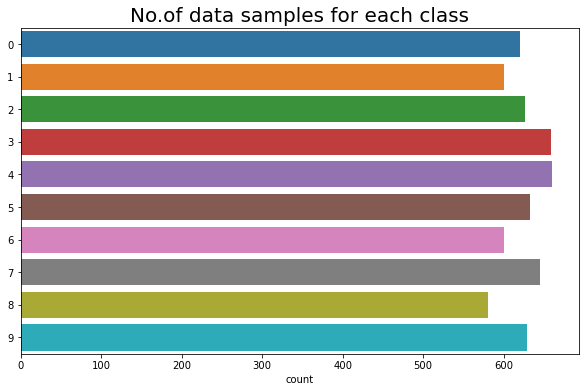

In [918]:
fig = plt.figure(figsize=(10,6))
plt.title("No.of data samples for each class", fontsize= 20)
sns.countplot(y = Y1, orient="h")
plt.show()

In [919]:
X_train = np.array(X_train)
Y_train = np.array(Y1)

print(X_train.shape , Y_train.shape)

(6254, 40, 174, 1) (6254,)


In [920]:
Y_train = to_categorical(Y_train)

In [921]:
Y_val = to_categorical(Y_val)

In [922]:
(X_train.shape , Y_train.shape), ((X_val.shape , Y_val.shape))

(((6254, 40, 174, 1), (6254, 10)), ((983, 40, 174, 1), (983, 10)))

### Creating a CNN model to classify the data

In [923]:
from keras.models import Sequential

model_n = keras.Sequential()

In [924]:
model_n.add(keras.Input(shape=input_shape))

model_n.add(layers.Conv2D(256, activation = "relu",kernel_size = (2,2)))
model_n.add(layers.MaxPool2D(pool_size = (2,2)))

model_n.add(layers.Conv2D(128, activation = "relu",kernel_size = (2,2)))
model_n.add(layers.MaxPool2D(pool_size = (2,2)))

model_n.add(layers.Conv2D(64, activation = "relu",kernel_size = (2,2)))
model_n.add(layers.MaxPool2D(pool_size = (2,2)))

model_n.add(layers.Conv2D(32, activation = "relu",kernel_size = (2,2)))
model_n.add(layers.MaxPool2D(pool_size = (2,2)))

model_n.add(layers.Flatten())

model_n.add(layers.Dense(256, activation = "sigmoid"))
model_n.add(layers.Dropout(0.5))
model_n.add(layers.Dense(128, activation = "tanh"))
model_n.add(layers.Dropout(0.5))
model_n.add(layers.Dense(64))
model_n.add(layers.Dense(units = 10, activation = "softmax"))

model_n.summary()

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 39, 173, 256)      1280      
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 19, 86, 256)      0         
 g2D)                                                            
                                                                 
 conv2d_13 (Conv2D)          (None, 18, 85, 128)       131200    
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 9, 42, 128)       0         
 g2D)                                                            
                                                                 
 conv2d_14 (Conv2D)          (None, 8, 41, 64)         32832     
                                                                 
 max_pooling2d_14 (MaxPoolin  (None, 4, 20, 64)      

In [925]:
model_n.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer='adam')

In [926]:
# tf.config.run_functions_eagerly(False)

batch_size = 32
epochs = 25

model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

histn = model_n.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val))

Epoch 1/25
196/196 [==============================] - 228s 1s/step - loss: 2.0533 - accuracy: 0.2816 - val_loss: 1.4987 - val_accuracy: 0.4720
Epoch 2/25
196/196 [==============================] - 203s 1s/step - loss: 1.5214 - accuracy: 0.4551 - val_loss: 1.2804 - val_accuracy: 0.5046
Epoch 3/25
196/196 [==============================] - 203s 1s/step - loss: 1.2979 - accuracy: 0.5379 - val_loss: 1.1389 - val_accuracy: 0.5931
Epoch 4/25
196/196 [==============================] - 181s 921ms/step - loss: 1.1669 - accuracy: 0.5875 - val_loss: 1.0197 - val_accuracy: 0.6460
Epoch 5/25
196/196 [==============================] - 156s 794ms/step - loss: 1.0396 - accuracy: 0.6436 - val_loss: 0.9927 - val_accuracy: 0.6755
Epoch 6/25
196/196 [==============================] - 157s 804ms/step - loss: 0.9599 - accuracy: 0.6741 - val_loss: 0.8605 - val_accuracy: 0.7162
Epoch 7/25
196/196 [==============================] - 191s 976ms/step - loss: 0.8737 - accuracy: 0.7026 - val_loss: 0.8775 - val_accu

Continuing the training process, to fit the training data a bit more

In [927]:
histn = model_n.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val))

Epoch 1/25
196/196 [==============================] - 213s 1s/step - loss: 0.3795 - accuracy: 0.8786 - val_loss: 0.5670 - val_accuracy: 0.8159
Epoch 2/25
196/196 [==============================] - 212s 1s/step - loss: 0.3554 - accuracy: 0.8855 - val_loss: 0.6934 - val_accuracy: 0.8087
Epoch 3/25
196/196 [==============================] - 241s 1s/step - loss: 0.4038 - accuracy: 0.8714 - val_loss: 0.6695 - val_accuracy: 0.7935
Epoch 4/25
196/196 [==============================] - 146s 744ms/step - loss: 0.3495 - accuracy: 0.8905 - val_loss: 0.5348 - val_accuracy: 0.8403
Epoch 5/25
196/196 [==============================] - 175s 893ms/step - loss: 0.3589 - accuracy: 0.8834 - val_loss: 0.5912 - val_accuracy: 0.8240
Epoch 6/25
196/196 [==============================] - 166s 848ms/step - loss: 0.3536 - accuracy: 0.8884 - val_loss: 0.5255 - val_accuracy: 0.8413
Epoch 7/25
196/196 [==============================] - 151s 771ms/step - loss: 0.3458 - accuracy: 0.8882 - val_loss: 0.5265 - val_accu

In [933]:
print(X_test.shape , Y_test.shape)

(2183, 40, 174, 1) (2183,)


In [938]:
Y_test = to_categorical(Y_test)

In [939]:
model_n.evaluate(X_test, Y_test)

69/69 [==============================] - 19s 270ms/step - loss: 0.6999 - accuracy: 0.7994


[0.6999326348304749, 0.7993586659431458]

In [940]:
y_pred_c1 = model_n.predict(X_test)
y_pred_c1 = pred_int(y_pred_c1)

y_testc = pred_int(Y_test)

print(classification_report(y_testc, y_pred_c1))

              precision    recall  f1-score   support

           0       0.80      0.91      0.85       273
           1       0.78      0.84      0.81       104
           2       0.80      0.77      0.78       273
           3       0.84      0.77      0.81       234
           4       0.94      0.69      0.80       223
           5       0.64      0.91      0.75       241
           6       0.93      0.90      0.91        98
           7       0.89      0.66      0.76       243
           8       0.87      0.91      0.89       239
           9       0.71      0.70      0.71       255

    accuracy                           0.80      2183
   macro avg       0.82      0.81      0.81      2183
weighted avg       0.81      0.80      0.80      2183



As we can see, the above model (model_n) is not able to classify some of the classes pretty well.

#################################################################################################################################

### Using the ELU (Exponential Linear unit) as the activation function

Here, in this model we also introduced the batch normalization, in order to standardize the outputs of each layer, which helping in the gradient process by not outlying large and small weights and biases, and also speeds up training.

Batch normalization applies a transformation that maintains the mean output close to 0 and the output standard deviation close to 1.

In [944]:
from keras.layers import Input, Conv2D, Dense, BatchNormalization, MaxPooling2D, GlobalAveragePooling2D, Flatten, Dropout

model_elu = Sequential()
model_elu.add(Conv2D(filters=16, kernel_size=2, input_shape=(num_rows, num_columns, num_channels), activation='elu'))
model_elu.add(BatchNormalization())
model_elu.add(MaxPooling2D(pool_size=(2,2)))
model_elu.add(Dropout(0.2))


model_elu.add(Conv2D(filters=32, kernel_size=2, activation='elu'))
model_elu.add(BatchNormalization())
model_elu.add(MaxPooling2D(pool_size=(2,2)))
model_elu.add(Dropout(0.2))


model_elu.add(Conv2D(filters=64, kernel_size=2, activation='elu'))
model_elu.add(BatchNormalization())
model_elu.add(MaxPooling2D(pool_size=(2,2)))
model_elu.add(Dropout(0.2))


model_elu.add(Conv2D(filters=128, kernel_size=2, activation='elu'))
model_elu.add(MaxPooling2D(pool_size=(2,2)))
model_elu.add(Dropout(0.2))
model_elu.add(GlobalAveragePooling2D())
model_elu.add(Flatten())
model_elu.add(Dense(10, activation='softmax'))

In [945]:
model_elu.summary()

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_20 (Conv2D)          (None, 39, 173, 16)       80        
                                                                 
 batch_normalization_66 (Bat  (None, 39, 173, 16)      64        
 chNormalization)                                                
                                                                 
 max_pooling2d_20 (MaxPoolin  (None, 19, 86, 16)       0         
 g2D)                                                            
                                                                 
 dropout_67 (Dropout)        (None, 19, 86, 16)        0         
                                                                 
 conv2d_21 (Conv2D)          (None, 18, 85, 32)        2080      
                                                                 
 batch_normalization_67 (Bat  (None, 18, 85, 32)     

In [946]:
model_elu.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer='adam')

batch_size = 32
epochs = 100

histn_elu = model_elu.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val))

Epoch 1/100
196/196 [==============================] - 37s 184ms/step - loss: 1.4365 - accuracy: 0.4976 - val_loss: 1.3653 - val_accuracy: 0.5504
Epoch 2/100
196/196 [==============================] - 31s 158ms/step - loss: 1.0258 - accuracy: 0.6445 - val_loss: 1.1036 - val_accuracy: 0.6267
Epoch 3/100
196/196 [==============================] - 32s 165ms/step - loss: 0.8734 - accuracy: 0.7026 - val_loss: 0.9636 - val_accuracy: 0.6755
Epoch 4/100
196/196 [==============================] - 32s 164ms/step - loss: 0.7665 - accuracy: 0.7400 - val_loss: 0.8393 - val_accuracy: 0.7121
Epoch 5/100
196/196 [==============================] - 30s 154ms/step - loss: 0.6990 - accuracy: 0.7597 - val_loss: 0.7695 - val_accuracy: 0.7416
Epoch 6/100
196/196 [==============================] - 30s 152ms/step - loss: 0.6142 - accuracy: 0.7947 - val_loss: 0.7049 - val_accuracy: 0.7640
Epoch 7/100
196/196 [==============================] - 32s 164ms/step - loss: 0.5561 - accuracy: 0.8174 - val_loss: 0.6718 -

Epoch 57/100
196/196 [==============================] - 28s 145ms/step - loss: 0.1042 - accuracy: 0.9643 - val_loss: 0.3258 - val_accuracy: 0.9176
Epoch 58/100
196/196 [==============================] - 28s 143ms/step - loss: 0.0947 - accuracy: 0.9672 - val_loss: 0.3092 - val_accuracy: 0.9115
Epoch 59/100
196/196 [==============================] - 27s 140ms/step - loss: 0.1031 - accuracy: 0.9624 - val_loss: 0.3752 - val_accuracy: 0.9064
Epoch 60/100
196/196 [==============================] - 27s 138ms/step - loss: 0.1038 - accuracy: 0.9642 - val_loss: 0.2979 - val_accuracy: 0.9227
Epoch 61/100
196/196 [==============================] - 27s 138ms/step - loss: 0.1126 - accuracy: 0.9618 - val_loss: 0.3661 - val_accuracy: 0.9115
Epoch 62/100
196/196 [==============================] - 27s 138ms/step - loss: 0.0964 - accuracy: 0.9669 - val_loss: 0.3943 - val_accuracy: 0.9013
Epoch 63/100
196/196 [==============================] - 28s 141ms/step - loss: 0.1112 - accuracy: 0.9602 - val_loss: 0

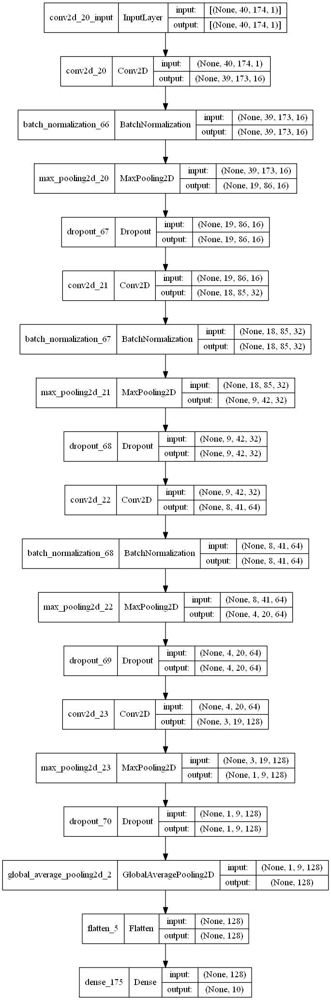

In [947]:
plot_model(model_elu,show_shapes=True, show_layer_names=True )

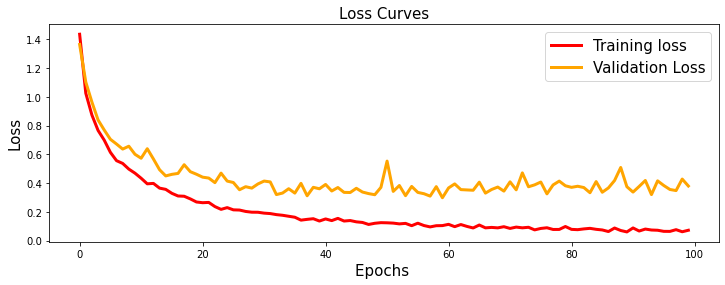

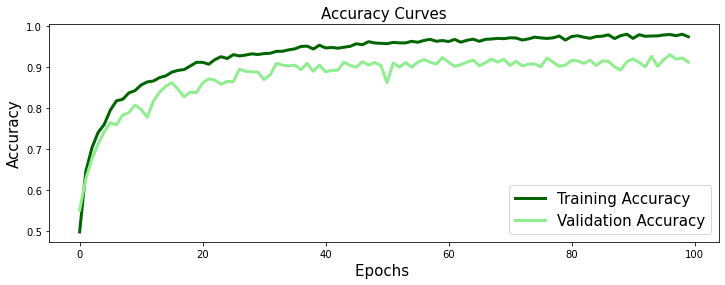

In [948]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(histn_elu.history['loss'],'red',linewidth=3.0)
plt.plot(histn_elu.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(histn_elu.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(histn_elu.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [949]:
model_elu.evaluate(X_test,Y_test)

69/69 [==============================] - 3s 42ms/step - loss: 0.3745 - accuracy: 0.9134


[0.37450850009918213, 0.9134218692779541]

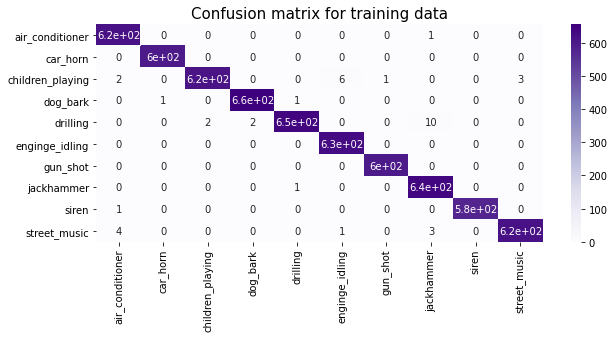

In [950]:
y_train_elu = pred_int(Y_train)

y_pred_elu_train = model_elu.predict(X_train)
y_pred_elu_train = pred_int(y_pred_elu_train)

con_mat_train = confusion_matrix(y_train_elu, y_pred_elu_train)

plt.figure(figsize=(10,4))
plt.title("Confusion matrix for training data", fontsize = 15)
plt.xlabel("Predicted class")
plt.ylabel("True class")

sns.heatmap(con_mat_train, annot=True, cmap="Purples",  xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()

In [951]:
y_pred_elu = model_elu.predict(X_test)
y_pred_elu = pred_int(y_pred_elu)

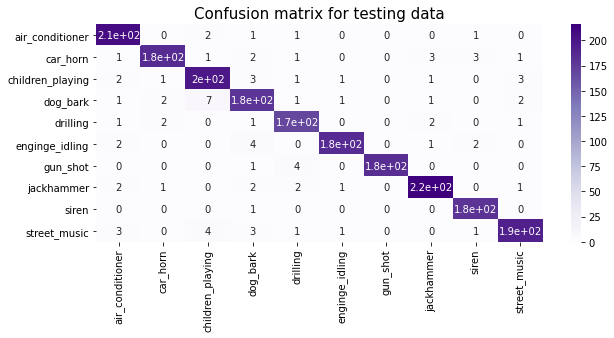

In [952]:
y_test_elu = pred_int(Y_test)

confusion_matelu = confusion_matrix(y_test_elu, y_pred_elu)

plt.figure(figsize=(10,4))
plt.title("Confusion matrix for testing data", fontsize = 15)
plt.xlabel("Predicted class")
plt.ylabel("True class")

sns.heatmap(confusion_mat, annot=True, cmap="Purples",  xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()



# 'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'crest', 'crest_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'flare', 'flare_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'mako', 'mako_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r', 'rocket', 'rocket_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r'

In [953]:
print(classification_report(y_test_elu,y_pred_elu))

              precision    recall  f1-score   support

           0       0.92      0.98      0.95       273
           1       0.94      0.93      0.94       104
           2       0.90      0.83      0.87       273
           3       0.93      0.90      0.91       234
           4       0.94      0.90      0.92       223
           5       0.90      0.94      0.92       241
           6       0.90      0.97      0.93        98
           7       0.91      0.96      0.94       243
           8       0.90      0.97      0.93       239
           9       0.90      0.80      0.85       255

    accuracy                           0.91      2183
   macro avg       0.91      0.92      0.92      2183
weighted avg       0.91      0.91      0.91      2183



Testing accuracy about 91% is achived using the above model built, and also, the f1-scores are pretty good for all the induvidual classes

#################################################################################################################################

### A very under performing model

In [954]:
from keras.models import Sequential

model_n2 = keras.Sequential()

In [955]:
model_n2.add(keras.Input(shape=input_shape))

model_n2.add(layers.Conv2D(32, activation = "elu",kernel_size = (2,2)))
model_n2.add(layers.MaxPool2D(pool_size = (2,2)))

model_n2.add(layers.Conv2D(64, activation = "elu",kernel_size = (2,2)))
model_n2.add(layers.MaxPool2D(pool_size = (2,2)))

model_n2.add(layers.Conv2D(256, activation = "elu",kernel_size = (2,2)))
model_n2.add(layers.MaxPool2D(pool_size = (2,2)))

model_n2.add(layers.Conv2D(512, activation = "elu",kernel_size = (2,2)))
model_n2.add(layers.MaxPool2D(pool_size = (2,2)))

model_n2.add(layers.Flatten())

model_n2.add(layers.Dense(1024, activation = "tanh"))
model_n2.add(layers.Dropout(0.25))
model_n2.add(layers.Dense(512, activation = "tanh"))
model_n2.add(layers.Dropout(0.4))
model_n2.add(layers.Dense(128,activation = "tanh"))
model_n2.add(layers.Dropout(0.5))
model_n2.add(layers.Dense(32,activation = "tanh"))
model_n2.add(layers.Dense(units = 10, activation = "softmax"))

model_n2.summary()

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_24 (Conv2D)          (None, 39, 173, 32)       160       
                                                                 
 max_pooling2d_24 (MaxPoolin  (None, 19, 86, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_25 (Conv2D)          (None, 18, 85, 64)        8256      
                                                                 
 max_pooling2d_25 (MaxPoolin  (None, 9, 42, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_26 (Conv2D)          (None, 8, 41, 256)        65792     
                                                                 
 max_pooling2d_26 (MaxPoolin  (None, 4, 20, 256)     

In [956]:
model_n2.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer='adam')

In [957]:
batch_size = 64
epochs = 100

histn2 = model_n2.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val))

Epoch 1/100
98/98 [==============================] - 56s 564ms/step - loss: 2.2881 - accuracy: 0.1527 - val_loss: 2.1493 - val_accuracy: 0.1424
Epoch 2/100
98/98 [==============================] - 65s 661ms/step - loss: 2.1226 - accuracy: 0.1804 - val_loss: 2.1315 - val_accuracy: 0.1526
Epoch 3/100
98/98 [==============================] - 56s 569ms/step - loss: 2.0572 - accuracy: 0.2066 - val_loss: 2.0360 - val_accuracy: 0.2431
Epoch 4/100
98/98 [==============================] - 53s 540ms/step - loss: 1.9980 - accuracy: 0.2430 - val_loss: 2.0895 - val_accuracy: 0.1882
Epoch 5/100
98/98 [==============================] - 53s 540ms/step - loss: 2.0411 - accuracy: 0.2138 - val_loss: 1.9857 - val_accuracy: 0.2340
Epoch 6/100
98/98 [==============================] - 66s 671ms/step - loss: 1.9466 - accuracy: 0.2506 - val_loss: 1.9151 - val_accuracy: 0.2604
Epoch 7/100
98/98 [==============================] - 60s 610ms/step - loss: 1.8924 - accuracy: 0.2693 - val_loss: 1.8916 - val_accuracy:

98/98 [==============================] - 52s 527ms/step - loss: 2.1110 - accuracy: 0.1784 - val_loss: 2.1577 - val_accuracy: 0.1495
Epoch 58/100
98/98 [==============================] - 51s 524ms/step - loss: 2.1069 - accuracy: 0.1799 - val_loss: 2.1495 - val_accuracy: 0.1617
Epoch 59/100
98/98 [==============================] - 52s 527ms/step - loss: 2.1064 - accuracy: 0.1724 - val_loss: 2.1507 - val_accuracy: 0.1404
Epoch 60/100
98/98 [==============================] - 68s 694ms/step - loss: 2.1064 - accuracy: 0.1775 - val_loss: 2.1540 - val_accuracy: 0.1495
Epoch 61/100
98/98 [==============================] - 63s 648ms/step - loss: 2.1060 - accuracy: 0.1808 - val_loss: 2.1493 - val_accuracy: 0.1597
Epoch 62/100
98/98 [==============================] - 58s 589ms/step - loss: 2.1004 - accuracy: 0.1740 - val_loss: 2.1546 - val_accuracy: 0.1506
Epoch 63/100
98/98 [==============================] - 53s 543ms/step - loss: 2.1038 - accuracy: 0.1744 - val_loss: 2.1523 - val_accuracy: 0.164

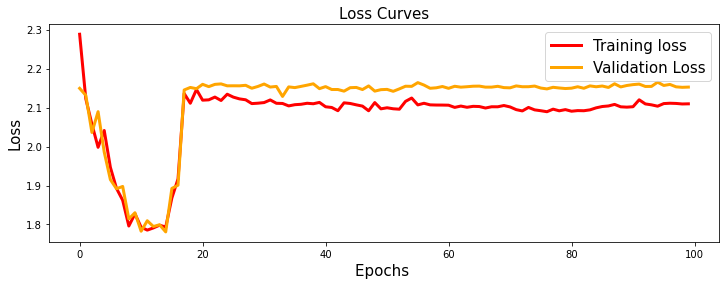

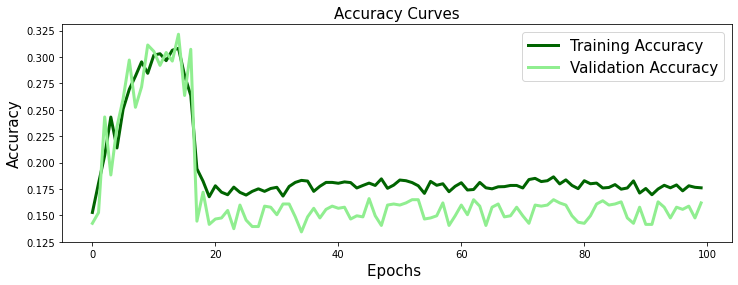

In [958]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(histn2.history['loss'],'red',linewidth=3.0)
plt.plot(histn2.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(histn2.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(histn2.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [959]:
model_n2.evaluate(X_test, Y_test)

69/69 [==============================] - 5s 66ms/step - loss: 2.1490 - accuracy: 0.1434


[2.148963689804077, 0.14338067173957825]

As we can see, the model (model_n2) isn't learning much from the training data, and also, there's a very unusual behaviour while traing for 100 epochs (Drastic change in training and validation loss @ epoch about 30) and the the training accuracy increaes but gets saturated at 15%, this might be due to the **Vaninshing Gradient** problem, in which the network doesn't learn from the new data points due to very very small change in gradient.

This is possibly due to the usage of **tanh** as the activation fucntion in the Dense layers, which would easily cause this problem

## Improving the underfitting model

So, this time, we use the **Leaky ReLU** activation function in the dense layers instead of **tanh**, as they cause ***Vaninshing Gradient*** problem, also we use the bacth normalization, in order to make the training proper and fast

### A bit about Batch Normalization

During training, the layer normalizes its output using the mean and std dev of the current batch of inputs.

For each channel being normalized, the layer returns gamma * (batch - mean(batch)) / sqrt(var(batch) + epsilon) + beta, where:

1. epsilon is small constant (configurable as part of the constructor arguments)
2. gamma is a learned scaling factor (initialized as 1), which can be disabled by passing scale=False to the constructor.
3. beta is a learned offset factor (initialized as 0), which can be disabled by passing center=False to the constructor.


Just like the parameters (eg. weights, bias) of any network layer, a Batch Norm layer also has parameters of its own:

* Two learnable parameters called beta and gamma.
* Two non-learnable parameters (Mean Moving Average and Variance Moving Average) are saved as part of the ‘state’ of the Batch Norm layer.

In [960]:
# Creating the improved version of the model_n2 -> model_n2i
model_n2i = Sequential()

# We use the same architecture as model_n2 (previous model), but add some Batch norm layers and change the activation
# funcion in the dense layers

model_n2i.add(keras.Input(shape=input_shape))

model_n2i.add(layers.Conv2D(32, activation = "elu",kernel_size = (2,2)))
model_n2i.add(BatchNormalization())
model_n2i.add(layers.MaxPool2D(pool_size = (2,2)))

model_n2i.add(layers.Conv2D(64, activation = "elu",kernel_size = (2,2)))
model_n2i.add(BatchNormalization())
model_n2i.add(layers.MaxPool2D(pool_size = (2,2)))

model_n2i.add(layers.Conv2D(256, activation = "elu",kernel_size = (2,2)))
model_n2i.add(BatchNormalization())
model_n2i.add(layers.MaxPool2D(pool_size = (2,2)))

model_n2i.add(layers.Conv2D(512, activation = "elu",kernel_size = (2,2)))
model_n2i.add(BatchNormalization())
model_n2i.add(layers.MaxPool2D(pool_size = (2,2)))

model_n2i.add(layers.Flatten())

# Here we used Leaky ReLU as activation functions
model_n2i.add(layers.Dense(1024, activation = keras.layers.LeakyReLU(alpha=0.01)))
model_n2i.add(layers.Dropout(0.25))
model_n2i.add(layers.Dense(512, activation = keras.layers.LeakyReLU(alpha=0.02)))
model_n2i.add(layers.Dropout(0.2))
model_n2i.add(layers.Dense(128,activation = keras.layers.LeakyReLU(alpha=0.025)))
model_n2i.add(layers.Dropout(0.25))
model_n2i.add(layers.Dense(32,activation = keras.layers.LeakyReLU(alpha=0.01)))
model_n2i.add(layers.Dense(units = 10, activation = "softmax"))

model_n2i.summary()

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_28 (Conv2D)          (None, 39, 173, 32)       160       
                                                                 
 batch_normalization_69 (Bat  (None, 39, 173, 32)      128       
 chNormalization)                                                
                                                                 
 max_pooling2d_28 (MaxPoolin  (None, 19, 86, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_29 (Conv2D)          (None, 18, 85, 64)        8256      
                                                                 
 batch_normalization_70 (Bat  (None, 18, 85, 64)       256       
 chNormalization)                                                
                                                     

In [961]:
model_n2i.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer='adam')

In [962]:
batch_size = 64
epochs = 100

histn2i = model_n2i.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val))

Epoch 1/100
98/98 [==============================] - 69s 694ms/step - loss: 1.9453 - accuracy: 0.3439 - val_loss: 1.6886 - val_accuracy: 0.4212
Epoch 2/100
98/98 [==============================] - 79s 806ms/step - loss: 1.2700 - accuracy: 0.5654 - val_loss: 1.0904 - val_accuracy: 0.6317
Epoch 3/100
98/98 [==============================] - 71s 724ms/step - loss: 0.9164 - accuracy: 0.7010 - val_loss: 0.8423 - val_accuracy: 0.7375
Epoch 4/100
98/98 [==============================] - 65s 665ms/step - loss: 0.7044 - accuracy: 0.7787 - val_loss: 0.8676 - val_accuracy: 0.7325
Epoch 5/100
98/98 [==============================] - 64s 656ms/step - loss: 0.5592 - accuracy: 0.8212 - val_loss: 0.7154 - val_accuracy: 0.7904
Epoch 6/100
98/98 [==============================] - 64s 656ms/step - loss: 0.4738 - accuracy: 0.8500 - val_loss: 0.6347 - val_accuracy: 0.8118
Epoch 7/100
98/98 [==============================] - 67s 680ms/step - loss: 0.3963 - accuracy: 0.8730 - val_loss: 0.8520 - val_accuracy:

98/98 [==============================] - 74s 761ms/step - loss: 0.0205 - accuracy: 0.9941 - val_loss: 0.5477 - val_accuracy: 0.9013
Epoch 58/100
98/98 [==============================] - 74s 758ms/step - loss: 0.0163 - accuracy: 0.9958 - val_loss: 0.6802 - val_accuracy: 0.8871
Epoch 59/100
98/98 [==============================] - 67s 688ms/step - loss: 0.0413 - accuracy: 0.9909 - val_loss: 0.7326 - val_accuracy: 0.8647
Epoch 60/100
98/98 [==============================] - 64s 656ms/step - loss: 0.0211 - accuracy: 0.9944 - val_loss: 0.6909 - val_accuracy: 0.9023
Epoch 61/100
98/98 [==============================] - 64s 657ms/step - loss: 0.0260 - accuracy: 0.9934 - val_loss: 0.6556 - val_accuracy: 0.8973
Epoch 62/100
98/98 [==============================] - 64s 654ms/step - loss: 0.0145 - accuracy: 0.9958 - val_loss: 0.7706 - val_accuracy: 0.8922
Epoch 63/100
98/98 [==============================] - 70s 716ms/step - loss: 0.0243 - accuracy: 0.9938 - val_loss: 0.8262 - val_accuracy: 0.892

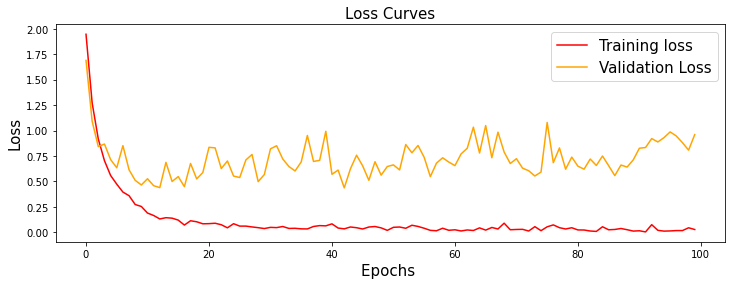

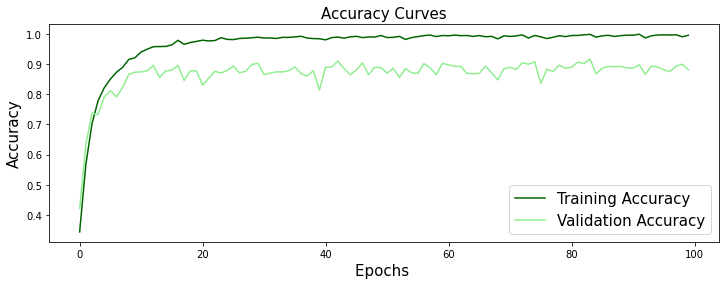

In [963]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(histn2i.history['loss'],'red',linewidth=1.5)
plt.plot(histn2i.history['val_loss'],'orange',linewidth=1.5)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(histn2i.history['accuracy'],'darkgreen',linewidth=1.5)
plt.plot(histn2i.history['val_accuracy'],'lightgreen',linewidth=1.5)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [964]:
model_n2i.evaluate(X_test, Y_test)

69/69 [==============================] - 7s 95ms/step - loss: 1.0109 - accuracy: 0.8804


[1.0108957290649414, 0.8804397583007812]

**So, this improvised version of model_n2 is greatly learning from the training data as it achives a testing accuracy of about 88%**

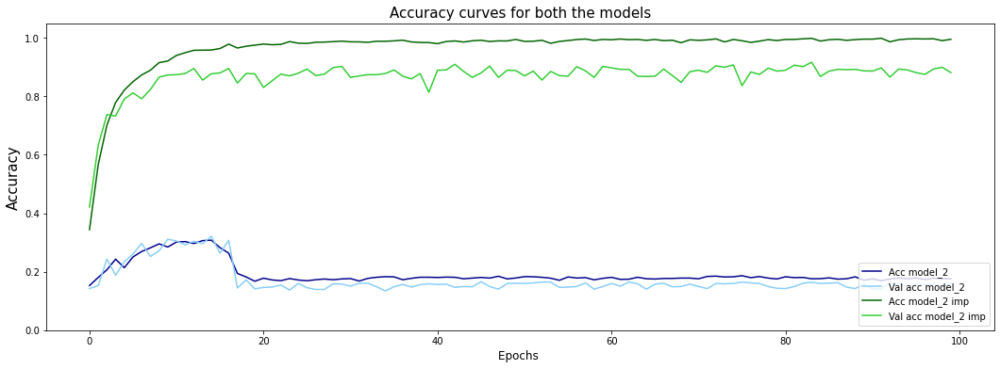

In [965]:
# Loss curves

plt.figure(figsize=[18,6])
plt.plot(histn2.history['accuracy'],"darkblue")
plt.plot(histn2.history['val_accuracy'],'lightskyblue')

plt.plot(histn2i.history['accuracy'],"darkgreen")
plt.plot(histn2i.history['val_accuracy'], "limegreen")


plt.xlabel('Epochs ',fontsize=12)
plt.ylabel('Accuracy',fontsize=15)
plt.title("Accuracy curves for both the models",fontsize=15)
plt.ylim([0,1.05])

plt.legend(["Acc model_2", "Val acc model_2", "Acc model_2 imp", "Val acc model_2 imp"], loc ="lower right")

plt.show()

**Clearly, we are able to solve the problem of vanishing gradients in the neural network, by picking up a new activation fucntion for the dense layers and also by introducing batch normalization which ensures that weights, biases and outputs will always be in the same range, i.e wouldn't benefit the outliers**

#################################################################################################################################

### Using the SELU (Scaled Exponential Linear unit) as the activation function

*We use the **lecun_normal** function to initialize the weights from a normal distribution and also we must use the **Alpha Dropout layers** instead of normla ones for working with this activation function 

**Alpha Dropout** is a type of Dropout that maintains the self-normalizing property. For an input with zero mean and unit standard deviation, the output of Alpha Dropout maintains the original mean and standard deviation of the input

We use batch normalization here too

In [966]:
from keras.layers import Input, Conv2D, Dense, BatchNormalization, MaxPooling2D, GlobalAveragePooling2D, Flatten,AlphaDropout

model_selu = Sequential()

model_selu.add(Conv2D(filters=512, kernel_size=2, input_shape=(num_rows, num_columns, num_channels), 
                      activation='selu', kernel_initializer='lecun_normal'))
model_selu.add(BatchNormalization())
model_selu.add(MaxPooling2D(pool_size=(2,2)))
model_selu.add(AlphaDropout(0.15))


model_selu.add(Conv2D(filters=256, kernel_size=2, activation='selu', kernel_initializer='lecun_normal'))
model_selu.add(BatchNormalization())
model_selu.add(MaxPooling2D(pool_size=(2,2)))
model_selu.add(AlphaDropout(0.15))


model_selu.add(Conv2D(filters=128, kernel_size=2, activation='selu',kernel_initializer='lecun_normal'))
model_selu.add(BatchNormalization())
model_selu.add(MaxPooling2D(pool_size=(2,2)))
model_selu.add(AlphaDropout(0.15))


model_selu.add(Conv2D(filters=64, kernel_size=2, activation='selu', kernel_initializer='lecun_normal'))
model_selu.add(MaxPooling2D(pool_size=(2,2)))
model_selu.add(AlphaDropout(0.15))

model_selu.add(Flatten())

model_selu.add(Dense(32, activation='selu', kernel_initializer='lecun_normal'))
model_selu.add(Dense(10, activation='softmax'))

In [967]:
model_selu.summary()

Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_32 (Conv2D)          (None, 39, 173, 512)      2560      
                                                                 
 batch_normalization_73 (Bat  (None, 39, 173, 512)     2048      
 chNormalization)                                                
                                                                 
 max_pooling2d_32 (MaxPoolin  (None, 19, 86, 512)      0         
 g2D)                                                            
                                                                 
 alpha_dropout_23 (AlphaDrop  (None, 19, 86, 512)      0         
 out)                                                            
                                                                 
 conv2d_33 (Conv2D)          (None, 18, 85, 256)       524544    
                                                     

In [968]:
model_selu.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer='adam')

In [969]:
batch_size = 96
epochs = 30

hist_selu = model_selu.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val))

Epoch 1/30
66/66 [==============================] - 703s 11s/step - loss: 1.8398 - accuracy: 0.3790 - val_loss: 4.7572 - val_accuracy: 0.2452
Epoch 2/30
66/66 [==============================] - 651s 10s/step - loss: 1.2030 - accuracy: 0.5721 - val_loss: 2.1414 - val_accuracy: 0.4995
Epoch 3/30
66/66 [==============================] - 672s 10s/step - loss: 0.9749 - accuracy: 0.6604 - val_loss: 2.7562 - val_accuracy: 0.4446
Epoch 4/30
66/66 [==============================] - 658s 10s/step - loss: 0.8119 - accuracy: 0.7295 - val_loss: 2.0722 - val_accuracy: 0.5392
Epoch 5/30
66/66 [==============================] - 677s 10s/step - loss: 0.7119 - accuracy: 0.7515 - val_loss: 2.0519 - val_accuracy: 0.6002
Epoch 6/30
66/66 [==============================] - 674s 10s/step - loss: 0.6183 - accuracy: 0.7929 - val_loss: 1.6992 - val_accuracy: 0.6297
Epoch 7/30
66/66 [==============================] - 672s 10s/step - loss: 0.5464 - accuracy: 0.8123 - val_loss: 1.9574 - val_accuracy: 0.6175
Epoch 

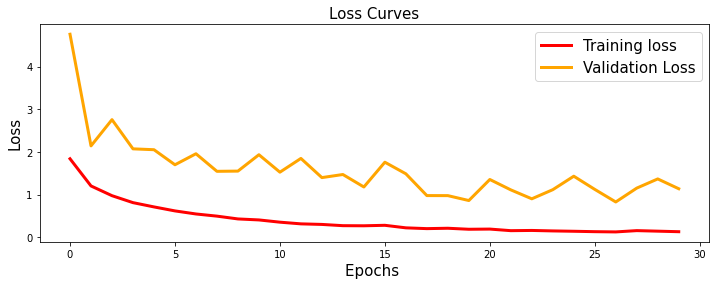

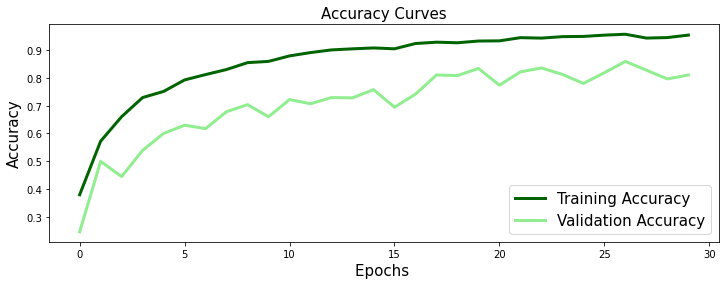

In [970]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(hist_selu.history['loss'],'red',linewidth=3.0)
plt.plot(hist_selu.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist_selu.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(hist_selu.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [971]:
model_selu.evaluate(X_test,Y_test)

69/69 [==============================] - 98s 1s/step - loss: 1.0990 - accuracy: 0.8250


[1.099048137664795, 0.8250114321708679]

#### Here, we could see that there's very little amount of overfitting taking place as validation accuracy is less then training accuracy

#################################################################################################################################

### Creating another model with only SeLU activation functions

In [1011]:
model_selu2 = Sequential()


# Creating the model's architecture
model_selu2.add(Conv2D(filters=32, kernel_size=2, input_shape=(num_rows, num_columns, num_channels), 
                      activation='selu', kernel_initializer='lecun_normal'))
model_selu2.add(BatchNormalization())
model_selu2.add(MaxPooling2D(pool_size=(2,2)))
model_selu2.add(AlphaDropout(0.10))

model_selu2.add(Conv2D(filters=64, kernel_size=2, activation='selu', kernel_initializer='lecun_normal'))
model_selu2.add(BatchNormalization())
model_selu2.add(MaxPooling2D(pool_size=(2,2)))
model_selu2.add(AlphaDropout(0.10))

model_selu2.add(Conv2D(filters=128, kernel_size=2, activation='selu',kernel_initializer='lecun_normal'))
model_selu2.add(BatchNormalization())
model_selu2.add(MaxPooling2D(pool_size=(2,2)))
model_selu2.add(AlphaDropout(0.10))

model_selu2.add(Conv2D(filters=256, kernel_size=2, activation='selu', kernel_initializer='lecun_normal'))
model_selu2.add(MaxPooling2D(pool_size=(2,2)))
model_selu2.add(AlphaDropout(0.10))

model_selu2.add(Flatten())

model_selu2.add(Dense(64, activation='selu', kernel_initializer='lecun_normal'))
model_selu2.add(Dense(10, activation='softmax'))

In [1012]:
model_selu2.summary()

Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_44 (Conv2D)          (None, 39, 173, 32)       160       
                                                                 
 batch_normalization_82 (Bat  (None, 39, 173, 32)      128       
 chNormalization)                                                
                                                                 
 max_pooling2d_44 (MaxPoolin  (None, 19, 86, 32)       0         
 g2D)                                                            
                                                                 
 alpha_dropout_35 (AlphaDrop  (None, 19, 86, 32)       0         
 out)                                                            
                                                                 
 conv2d_45 (Conv2D)          (None, 18, 85, 64)        8256      
                                                     

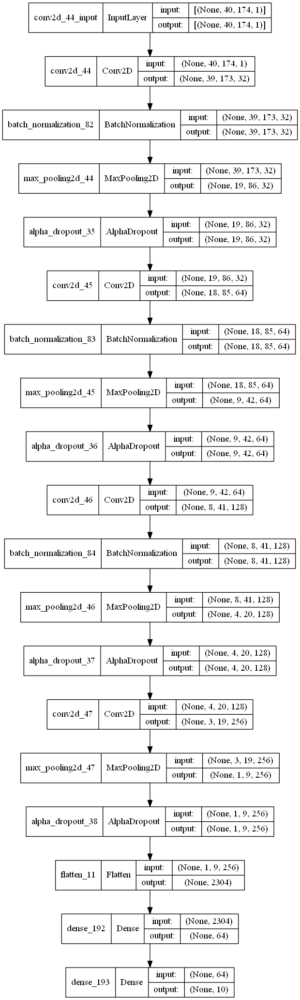

In [1013]:
plot_model(model_selu2,show_shapes=True, show_layer_names=True )

In [1014]:
# Compiling the model
model_selu2.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer='adam')

In [1015]:
from tensorflow.keras.callbacks import Callback

In [1017]:
# Training the model built, with batch size and no.of epochs specified.
batch_size = 90
epochs = 50
es = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience = 4, min_delta=0.01)

hist_selu2 = model_selu2.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val),
                            callbacks=[es])

Epoch 1/50
70/70 [==============================] - 60s 852ms/step - loss: 2.3164 - accuracy: 0.2933 - val_loss: 3.5998 - val_accuracy: 0.2706
Epoch 2/50
70/70 [==============================] - 54s 769ms/step - loss: 1.3637 - accuracy: 0.5166 - val_loss: 2.5631 - val_accuracy: 0.4395
Epoch 3/50
70/70 [==============================] - 54s 779ms/step - loss: 1.1089 - accuracy: 0.6126 - val_loss: 1.8618 - val_accuracy: 0.5860
Epoch 4/50
70/70 [==============================] - 54s 778ms/step - loss: 0.9651 - accuracy: 0.6660 - val_loss: 1.5754 - val_accuracy: 0.6643
Epoch 5/50
70/70 [==============================] - 54s 767ms/step - loss: 0.8262 - accuracy: 0.7192 - val_loss: 1.7513 - val_accuracy: 0.6785
Epoch 6/50
70/70 [==============================] - 54s 774ms/step - loss: 0.7311 - accuracy: 0.7467 - val_loss: 1.9955 - val_accuracy: 0.6592
Epoch 7/50
70/70 [==============================] - 57s 808ms/step - loss: 0.6522 - accuracy: 0.7814 - val_loss: 1.6263 - val_accuracy: 0.7111

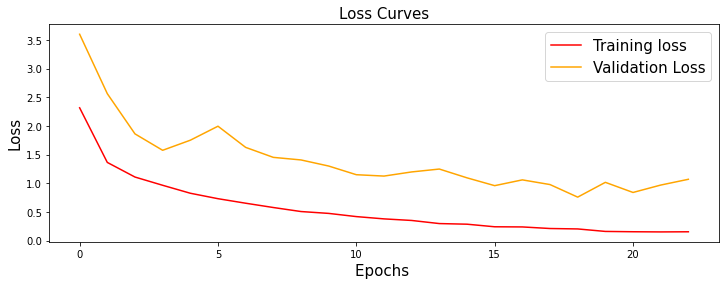

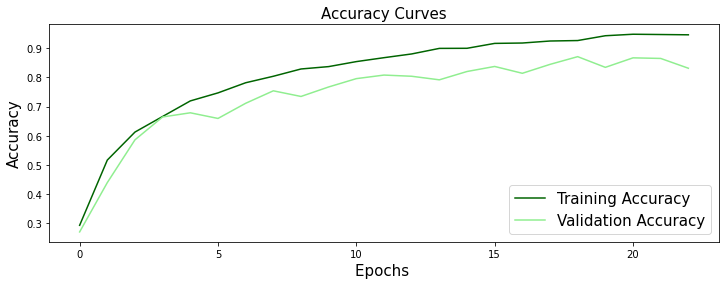

In [1018]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(hist_selu2.history['loss'],'red',linewidth=1.5)
plt.plot(hist_selu2.history['val_loss'],'orange',linewidth=1.5)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist_selu2.history['accuracy'],'darkgreen',linewidth=1.5)
plt.plot(hist_selu2.history['val_accuracy'],'lightgreen',linewidth=1.5)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [1023]:
batch_size = 90
epochs = 15

hist_selu2 = model_selu2.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val))

Epoch 1/15
70/70 [==============================] - 51s 737ms/step - loss: 0.1419 - accuracy: 0.9520 - val_loss: 0.9639 - val_accuracy: 0.8525
Epoch 2/15
70/70 [==============================] - 53s 759ms/step - loss: 0.1251 - accuracy: 0.9549 - val_loss: 0.9745 - val_accuracy: 0.8647
Epoch 3/15
70/70 [==============================] - 53s 755ms/step - loss: 0.1100 - accuracy: 0.9608 - val_loss: 1.1779 - val_accuracy: 0.8555
Epoch 4/15
70/70 [==============================] - 52s 744ms/step - loss: 0.1237 - accuracy: 0.9570 - val_loss: 0.8684 - val_accuracy: 0.8698
Epoch 5/15
70/70 [==============================] - 54s 769ms/step - loss: 0.1019 - accuracy: 0.9621 - val_loss: 1.0446 - val_accuracy: 0.8596
Epoch 6/15
70/70 [==============================] - 54s 774ms/step - loss: 0.0913 - accuracy: 0.9687 - val_loss: 0.9694 - val_accuracy: 0.8688
Epoch 7/15
70/70 [==============================] - 54s 769ms/step - loss: 0.1162 - accuracy: 0.9608 - val_loss: 1.0759 - val_accuracy: 0.8505

In [1027]:
batch_size = 90
epochs = 10

hist_selu2 = model_selu2.fit(X_train, Y_train, batch_size=batch_size, epochs=epochs, validation_data=(X_val, Y_val))

Epoch 1/10
70/70 [==============================] - 46s 658ms/step - loss: 0.0486 - accuracy: 0.9824 - val_loss: 1.4476 - val_accuracy: 0.8444
Epoch 2/10
70/70 [==============================] - 49s 703ms/step - loss: 0.0676 - accuracy: 0.9760 - val_loss: 1.0647 - val_accuracy: 0.8688
Epoch 3/10
70/70 [==============================] - 53s 753ms/step - loss: 0.0526 - accuracy: 0.9815 - val_loss: 1.2818 - val_accuracy: 0.8728
Epoch 4/10
70/70 [==============================] - 70s 1s/step - loss: 0.0551 - accuracy: 0.9805 - val_loss: 1.2262 - val_accuracy: 0.8688
Epoch 5/10
70/70 [==============================] - 69s 985ms/step - loss: 0.0610 - accuracy: 0.9795 - val_loss: 1.3277 - val_accuracy: 0.8596
Epoch 6/10
70/70 [==============================] - 69s 980ms/step - loss: 0.0702 - accuracy: 0.9763 - val_loss: 1.4804 - val_accuracy: 0.8474
Epoch 7/10
70/70 [==============================] - 71s 1s/step - loss: 0.0745 - accuracy: 0.9768 - val_loss: 1.3038 - val_accuracy: 0.8576
Epoch

In [1028]:
# Evaluating the model on testing data
model_selu2.evaluate(X_test, Y_test)

69/69 [==============================] - 7s 95ms/step - loss: 1.0790 - accuracy: 0.8804


[1.0790209770202637, 0.8804397583007812]

Testing accuracy about 88% is achived using the above model built

In [1029]:
y_pred_selu2 = model_selu2.predict(X_test)

In [1030]:
y_pred_selu2 = pred_int(y_pred_selu2)
y_tests = pred_int(Y_test)

In [1031]:
print(classification_report(y_tests, y_pred_selu2))

              precision    recall  f1-score   support

           0       0.96      0.92      0.94       273
           1       0.91      0.89      0.90       104
           2       0.79      0.84      0.81       273
           3       0.84      0.85      0.85       234
           4       0.98      0.78      0.87       223
           5       0.89      0.96      0.93       241
           6       0.95      0.96      0.95        98
           7       0.93      0.95      0.94       243
           8       0.82      0.96      0.88       239
           9       0.84      0.74      0.78       255

    accuracy                           0.88      2183
   macro avg       0.89      0.89      0.89      2183
weighted avg       0.88      0.88      0.88      2183



As we can see, the precision and recall values are pretty good for all the classes 

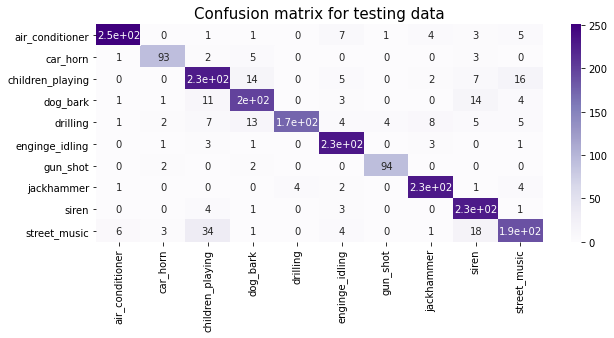

In [1032]:
confusion_matselu2 = confusion_matrix(y_tests, y_pred_selu2)

plt.figure(figsize=(10,4))
plt.title("Confusion matrix for testing data", fontsize = 15)
plt.xlabel("Predicted class")
plt.ylabel("True class")

sns.heatmap(confusion_matselu2, annot=True, cmap="Purples",  xticklabels = ['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'],
           yticklabels=['air_conditioner', 'car_horn', 'children_playing', 'dog_bark', 'drilling', 'enginge_idling', 'gun_shot', 'jackhammer', 'siren','street_music'])
plt.show()


###      * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * *  * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * 

### Listing out the best neural network models which were able to classify our audio data well.

1. **model3** :- with about 95% testing accuracy using the audio features extracted with f1 score of 95%


2. **model2** :- with about 91.7% testing accuracy using the audio features extracted and f1 score of about 92%


3. **model_elu** :- with about 91% testing accuracy using only the MFCC's extracted


4. **model1** :- with about 89% testing accuracy using the audio features extracted

.
.
.


Saving the best models, we've trained for future applications

In [1039]:
model_path = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Models\\model3.h5"

tf.keras.models.save_model(model3, filepath=model_path, overwrite=True, include_optimizer=True, save_format="h5")

In [1043]:
from keras.models import load_model

Model3 = load_model("C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Models\\model3.h5")

Model3.evaluate(x_test_n, y_test)

63/63 [==============================] - 1s 11ms/step - loss: 0.6484 - accuracy: 0.9481


[0.648350179195404, 0.948110818862915]

In [1044]:
model_path = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Models\\model2.h5"

tf.keras.models.save_model(model2, filepath=model_path, overwrite=True, include_optimizer=True, save_format="h5")

In [1045]:
model_path = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Models\\model_elu.h5"

tf.keras.models.save_model(model_elu, filepath=model_path, overwrite=True, include_optimizer=True, save_format="h5")

In [1563]:
model_path = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Models\\model1.h5"

tf.keras.models.save_model(model1, filepath=model_path, overwrite=True, include_optimizer=True, save_format="h5")

In [1564]:
model_path = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Models\\model_selu2.h5"

tf.keras.models.save_model(model_selu2, filepath=model_path, overwrite=True, include_optimizer=True, save_format="h5")

In [1565]:
model_path = "C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\Models\\model_selu.h5"

tf.keras.models.save_model(model_selu, filepath=model_path, overwrite=True, include_optimizer=True, save_format="h5")

In [1548]:
def extract_features(features_list, data_paths):

    s = time.time()

    for i in range(len(data_paths)):

        sample , sr = librosa.load(data_paths[i][0])

        ae = amplitude_envelope(sample, frame_size = 2048, hop_length = 512)
        ae_m, ae_v = ae.mean(), ae.var()
        features_list["ae_mean"].append(ae_m)
        features_list["ae_var"].append(ae_v)
        rms = Rms(sample)
        rms_m, rms_v = rms.mean(), rms.var()
        features_list["rms_mean"].append(rms_m)
        features_list["rms_var"].append(rms_v)
        zcr =  Zcr(sample)
        zcr_m, zcr_v = zcr.mean(), zcr.var()
        features_list["zcr_mean"].append(zcr_m)
        features_list['zcr_var'].append(zcr_v)
        mag_spec = Mag_spec(sample)
        features_list["mag_spec_mean"].append(mag_spec.mean())
        features_list["mag_spec_var"].append(mag_spec.var())
        spec = spectrogram(sample)
        features_list["spec_mean"].append(spec.mean())
        features_list['spec_var'].append(spec.var())
        mel_spec = log_mel(sample, sr)
        features_list["mel_mean"].append(mel_spec.mean())
        features_list["mel_var"].append(mel_spec.var())
        mfcc = Mfcc(sample, sr)
        features_list["mfcc_mean"].append(mfcc.mean())
        features_list["mfcc_var"].append(mfcc.var())
        chroma_stft = Chroma_stft(sample, sr)
        features_list["chroma_stft_mean"].append(chroma_stft.mean())
        features_list['chroma_stft_var'].append(chroma_stft.var())
        spec_centriod = Spec_centriod(sample, sr)
        features_list['spec_centroid_mean'].append(spec_centriod.mean())
        features_list['spec_centroid_var'].append(spec_centriod.var())
        spec_roll = spec_roll_off(sample, sr)
        features_list["roll_off_mean"].append(spec_roll.mean())
        features_list['roll_off_var'].append(spec_roll.var())
        spec_roll50 = spec_roll_off50(sample, sr)
        features_list["roll_off50_mean"].append(spec_roll50.mean())
        features_list['roll_off50_var'].append(spec_roll50.var())
        spec_roll25 =  spec_roll_off25(sample, sr)
        features_list["roll_off25_mean"].append(spec_roll25.mean())
        features_list['roll_off25_var'].append(spec_roll25.var())
        spec_contr =  spec_contrast(sample, sr)
        features_list["spec_cont_mean"].append(spec_contr.mean())
        features_list['spec_cont_var'].append(spec_contr.var())
        percep =  perceptual_wt(sample, sr)
        features_list["percep_mean"].append(percep.mean())
        features_list['percep_var'].append(percep.var())
        tempo =  tempogram(sample, sr)
        features_list["tempo_mean"].append(tempo.mean())
        features_list["tempo_var"].append(tempo.var())
        spec_bw =  spec_bandwidth(sample, sr)
        features_list["spec_bw_mean"].append(spec_bw.mean())
        features_list['spec_bw_var'].append(spec_bw.var())
        log_me = log_mel(sample, sr)
        features_list["log_mel_mean"].append(log_me.mean())
        features_list['log_mel_var'].append(log_me.var())


    e = time.time()
    print((e - s)/60  , "mins")

# Using Audio augmentation to classify the sounds even more better

In [1358]:
data_path_m = sorted(data_paths, key = lambda x:x[1])

In [1148]:
ind_ranges = {0: [],1: [],2: [],3: [],4: [],5: [],6: [],7: [],8: [],9:[]}

In [1149]:
si = 0
ei = 0
curr_ind = 0
i = 0
while i < len(data_path_m):
    if data_path_m[si][1] != data_path_m[ei][1]:
        
        ind_ranges[curr_ind].append(si)
        ind_ranges[curr_ind].append(ei)

        curr_ind += 1
        si = ei
        i += 1
        
    else:
        i += 1
        ei = i
        
ind_ranges[9].append(si)
ind_ranges[9].append(ei)

In [1150]:
ind_ranges

{0: [0, 1000],
 1: [1000, 1429],
 2: [1429, 2429],
 3: [2429, 3429],
 4: [3429, 4429],
 5: [4429, 5429],
 6: [5429, 5803],
 7: [5803, 6803],
 8: [6803, 7732],
 9: [7732, 8732]}

In [1193]:
car_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[1][0], ind_ranges[1][1]-1)
    car_samples.append(data_path_m[ind][0])

In [1196]:
print(class_labels[1])
ipd.Audio(car_samples[9])

car_horn


In [1201]:
print(class_labels[1])
ipd.Audio(car_samples[2])

car_horn


In [1366]:
print(class_labels[1])
ipd.Audio(car_samples[6])

car_horn


In [1203]:
print(class_labels[1])
ipd.Audio(car_samples[7])

car_horn


Noise can be added to car horns, frequecy can be changed with care

In [1208]:
ac_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[0][0], ind_ranges[0][1]-1)
    ac_samples.append(data_path_m[ind][0])

In [1210]:
print(class_labels[0])
ipd.Audio(ac_samples[4])

air_conditioner


In [1212]:
print(class_labels[0])
ipd.Audio(ac_samples[9])

air_conditioner


In [1214]:
print(class_labels[0])
ipd.Audio(ac_samples[8])

air_conditioner


In [1216]:
cp_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[2][0], ind_ranges[2][1]-1)
    cp_samples.append(data_path_m[ind][0])

In [1239]:
print(class_labels[2])
ipd.Audio(cp_samples[4])

children_playing


In [1242]:
print(class_labels[2])
ipd.Audio(cp_samples[3])

children_playing


In [1245]:
print(class_labels[2])
ipd.Audio(cp_samples[9])

children_playing


In [1541]:
print(class_labels[2])
ipd.Audio(cp_samples[5])

children_playing


In [1223]:
db_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[3][0], ind_ranges[3][1]-1)
    db_samples.append(data_path_m[ind][0])

In [1247]:
print(class_labels[3])
ipd.Audio(db_samples[4])

dog_bark


In [1249]:
print(class_labels[3])
ipd.Audio(db_samples[1])

dog_bark


In [1251]:
print(class_labels[3])
ipd.Audio(db_samples[8])

dog_bark


In [1231]:
drill_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[4][0], ind_ranges[4][1]-1)
    drill_samples.append(data_path_m[ind][0])

In [1253]:
print(class_labels[4])
ipd.Audio(drill_samples[1])

drilling


In [1255]:
print(class_labels[4])
ipd.Audio(drill_samples[8])

drilling


In [1258]:
print(class_labels[4])
ipd.Audio(drill_samples[3])

drilling


In [1273]:
ei_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[5][0], ind_ranges[5][1]-1)
    ei_samples.append(data_path_m[ind][0])

In [1275]:
print(class_labels[5])
ipd.Audio(ei_samples[8])

enginge_idling


In [1279]:
print(class_labels[5])
ipd.Audio(ei_samples[4])

enginge_idling


In [1281]:
print(class_labels[5])
ipd.Audio(ei_samples[6])

enginge_idling


In [1282]:
gs_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[6][0], ind_ranges[6][1]-1)
    gs_samples.append(data_path_m[ind][0])

In [1285]:
print(class_labels[6])
ipd.Audio(gs_samples[4])

gun_shot


In [1287]:
print(class_labels[6])
ipd.Audio(gs_samples[2])

gun_shot


In [1289]:
print(class_labels[6])
ipd.Audio(gs_samples[5])

gun_shot


In [1290]:
j_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[7][0], ind_ranges[7][1]-1)
    j_samples.append(data_path_m[ind][0])

In [1292]:
print(class_labels[7])
ipd.Audio(j_samples[2])

jackhammer


In [1294]:
print(class_labels[7])
ipd.Audio(j_samples[1])

jackhammer


In [1296]:
print(class_labels[7])
ipd.Audio(j_samples[0])

jackhammer


In [1298]:
s_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[8][0], ind_ranges[8][1]-1)
    s_samples.append(data_path_m[ind][0])

In [1302]:
print(class_labels[8])
ipd.Audio(s_samples[8])

siren


In [1304]:
print(class_labels[8])
ipd.Audio(s_samples[5])

siren


In [1306]:
print(class_labels[8])
ipd.Audio(s_samples[0])

siren


In [1308]:
sm_samples = []
for i in range(10):
    ind = random.randint(ind_ranges[9][0], ind_ranges[9][1]-1)
    sm_samples.append(data_path_m[ind][0])

In [1310]:
print(class_labels[9])
ipd.Audio(sm_samples[0])

street_music


In [1312]:
print(class_labels[9])
ipd.Audio(sm_samples[4])

street_music


In [1314]:
print(class_labels[9])
ipd.Audio(sm_samples[3])

street_music


In [983]:
from audiomentations import Compose, AddGaussianNoise, PitchShift, TimeStretch, PolarityInversion, Gain  
import random
import librosa

In [14]:
# x_train1, x_test1, y_train1, y_test1 = train_test_split(X_sc,y, test_size=0.2, random_state=0)
# x_train1, x_val, y_train1, y_val = train_test_split(x_train1,y_train1, test_size=0.12, random_state=0)
# print(x_train1.shape, x_val1.shape, x_test1.shape)

In [984]:
random.shuffle(data_paths)

In [985]:
print(len(data_paths))
data_paths[0]

8732


['C:\\Users\\srevaatsav\\Downloads\\UrbanSound8K\\audio\\fold5\\173993-3-0-39.wav',
 3]

In [986]:
Y = []
for i in range(len(data_paths)):
    Y.append(data_paths[i][1])

In [987]:
x_train1, x_test1, y_train1, y_test1 = train_test_split(data_paths,Y, test_size=0.2, random_state=0)
x_train1, x_val1, y_train1, y_val1 = train_test_split(x_train1,y_train1, test_size=0.125, random_state=0)
print(len(x_train1), len(x_val1), len(x_test1))

6111 874 1747


In [988]:
features_list_train = {"ae_mean":[], "ae_var":[], "rms_mean":[], "rms_var":[], "zcr_mean":[], "zcr_var":[], "chroma_stft_mean":[], 
            "chroma_stft_var":[], "spec_centroid_mean":[], "spec_centroid_var":[], "spec_cont_mean":[], "spec_cont_var":[],
            "spec_bw_mean":[], "spec_bw_var":[],"percep_mean":[], "percep_var":[], "tempo_mean":[], "tempo_var":[], 
            "roll_off_mean":[], "roll_off_var":[], "roll_off50_mean":[],"roll_off50_var":[],"roll_off25_mean":[],"roll_off25_var":[],
            "log_mel_mean":[], "log_mel_var":[], "mfcc_mean":[], "mfcc_var":[],"spec_mean":[], "spec_var":[], 
            "mag_spec_mean" :[] ,"mag_spec_var":[], "mel_mean":[], "mel_var":[]}

features_list_val = {"ae_mean":[], "ae_var":[], "rms_mean":[], "rms_var":[], "zcr_mean":[], "zcr_var":[], "chroma_stft_mean":[], 
            "chroma_stft_var":[], "spec_centroid_mean":[], "spec_centroid_var":[], "spec_cont_mean":[], "spec_cont_var":[],
            "spec_bw_mean":[], "spec_bw_var":[],"percep_mean":[], "percep_var":[], "tempo_mean":[], "tempo_var":[], 
            "roll_off_mean":[], "roll_off_var":[], "roll_off50_mean":[],"roll_off50_var":[],"roll_off25_mean":[],"roll_off25_var":[],
            "log_mel_mean":[], "log_mel_var":[], "mfcc_mean":[], "mfcc_var":[],"spec_mean":[], "spec_var":[], 
            "mag_spec_mean" :[] ,"mag_spec_var":[], "mel_mean":[], "mel_var":[]}

features_list_test = {"ae_mean":[], "ae_var":[], "rms_mean":[], "rms_var":[], "zcr_mean":[], "zcr_var":[], "chroma_stft_mean":[], 
            "chroma_stft_var":[], "spec_centroid_mean":[], "spec_centroid_var":[], "spec_cont_mean":[], "spec_cont_var":[],
            "spec_bw_mean":[], "spec_bw_var":[],"percep_mean":[], "percep_var":[], "tempo_mean":[], "tempo_var":[], 
            "roll_off_mean":[], "roll_off_var":[], "roll_off50_mean":[],"roll_off50_var":[],"roll_off25_mean":[],"roll_off25_var":[],
            "log_mel_mean":[], "log_mel_var":[], "mfcc_mean":[], "mfcc_var":[],"spec_mean":[], "spec_var":[], 
            "mag_spec_mean" :[] ,"mag_spec_var":[], "mel_mean":[], "mel_var":[]}

In [82]:
s = time.time()

for i in range(len(x_train1)):
    
    sample , sr = librosa.load(x_train1[i][0])
    
    ae = amplitude_envelope(sample, frame_size = 2048, hop_length = 512)
    ae_m, ae_v = ae.mean(), ae.var()
    features_list_train["ae_mean"].append(ae_m)
    features_list_train["ae_var"].append(ae_v)
    
    
    rms = Rms(sample)
    rms_m, rms_v = rms.mean(), rms.var()
    features_list_train["rms_mean"].append(rms_m)
    features_list_train["rms_var"].append(rms_v)
    
    zcr =  Zcr(sample)
    zcr_m, zcr_v = zcr.mean(), zcr.var()
    features_list_train["zcr_mean"].append(zcr_m)
    features_list_train['zcr_var'].append(zcr_v)
    
    
    mag_spec = Mag_spec(sample)
    features_list_train["mag_spec_mean"].append(mag_spec.mean())
    features_list_train["mag_spec_var"].append(mag_spec.var())
    
    
    spec = spectrogram(sample)
    features_list_train["spec_mean"].append(spec.mean())
    features_list_train['spec_var'].append(spec.var())
    
    
    mel_spec = log_mel(sample, sr)
    features_list_train["mel_mean"].append(mel_spec.mean())
    features_list_train["mel_var"].append(mel_spec.var())
    
    
    mfcc = Mfcc(sample, sr)
    features_list_train["mfcc_mean"].append(mfcc.mean())
    features_list_train["mfcc_var"].append(mfcc.var())
    
            
    chroma_stft = Chroma_stft(sample, sr)
    features_list_train["chroma_stft_mean"].append(chroma_stft.mean())
    features_list_train['chroma_stft_var'].append(chroma_stft.var())
    
    spec_centriod = Spec_centriod(sample, sr)
    features_list_train['spec_centroid_mean'].append(spec_centriod.mean())
    features_list_train['spec_centroid_var'].append(spec_centriod.var())
    
    
    spec_roll = spec_roll_off(sample, sr)
    features_list_train["roll_off_mean"].append(spec_roll.mean())
    features_list_train['roll_off_var'].append(spec_roll.var())
    
    
    spec_roll50 = spec_roll_off50(sample, sr)
    features_list_train["roll_off50_mean"].append(spec_roll50.mean())
    features_list_train['roll_off50_var'].append(spec_roll50.var())
    
    
    spec_roll25 =  spec_roll_off25(sample, sr)
    features_list_train["roll_off25_mean"].append(spec_roll25.mean())
    features_list_train['roll_off25_var'].append(spec_roll25.var())
    
    
    spec_contr =  spec_contrast(sample, sr)
    features_list_train["spec_cont_mean"].append(spec_contr.mean())
    features_list_train['spec_cont_var'].append(spec_contr.var())
    

    percep =  perceptual_wt(sample, sr)
    features_list_train["percep_mean"].append(percep.mean())
    features_list_train['percep_var'].append(percep.var())
    
    
    tempo =  tempogram(sample, sr)
    features_list_train["tempo_mean"].append(tempo.mean())
    features_list_train["tempo_var"].append(tempo.var())
    
    
    spec_bw =  spec_bandwidth(sample, sr)
    features_list_train["spec_bw_mean"].append(spec_bw.mean())
    features_list_train['spec_bw_var'].append(spec_bw.var())
    
    log_me = log_mel(sample, sr)
    features_list_train["log_mel_mean"].append(log_me.mean())
    features_list_train['log_mel_var'].append(log_me.var())
    
    
e = time.time()
print((e - s)/60  , "mins")

C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\pitch.py:153: UserWarning: Trying to estimate tuning from empty frequency set.
  warnings.warn("Trying to estimate tuning from empty frequency set.")
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1103
  warnings.warn(
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1323
  warnings.warn(


37.727198628584546 mins


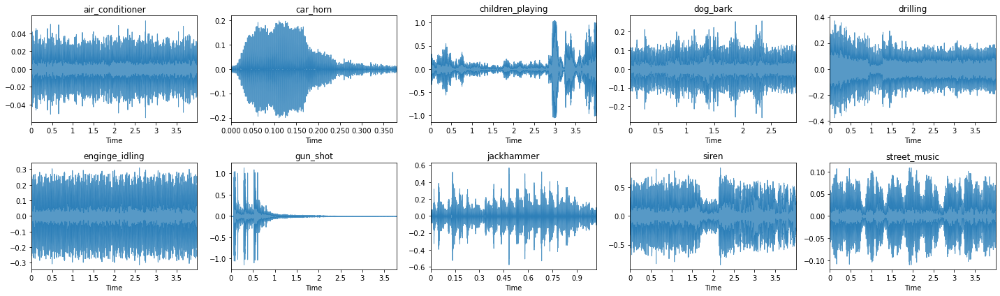

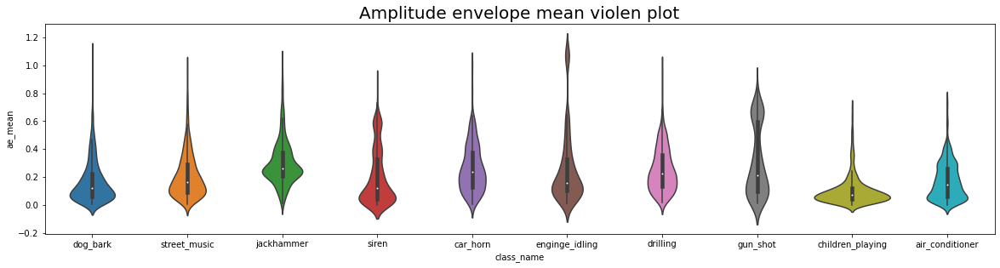

### As we can see, the amplitude distribution of the entire data, is shown above

In [83]:
s = time.time()


augment = Compose([
    AddGaussianNoise(min_amplitude=0.01, max_amplitude= 0.025, p = 1),
    PitchShift(min_semitones=-3, max_semitones = +3, p = 1),
    TimeStretch(min_rate=0.75, max_rate=1.35, p = 1),
    PolarityInversion(p=0.35),
    Gain(p = 0.90)])



for i in range(len(x_train1)):
    
    sample , sr = librosa.load(x_train1[i][0])
    
    augmented_signal = augment(sample, sr)
    
    ae = amplitude_envelope(augmented_signal, frame_size = 2048, hop_length = 512)
    ae_m, ae_v = ae.mean(), ae.var()
    features_list_train["ae_mean"].append(ae_m)
    features_list_train["ae_var"].append(ae_v)
    
    
    rms = Rms(augmented_signal)
    rms_m, rms_v = rms.mean(), rms.var()
    features_list_train["rms_mean"].append(rms_m)
    features_list_train["rms_var"].append(rms_v)
    
    zcr =  Zcr(augmented_signal)
    zcr_m, zcr_v = zcr.mean(), zcr.var()
    features_list_train["zcr_mean"].append(zcr_m)
    features_list_train['zcr_var'].append(zcr_v)
    
    
    mag_spec = Mag_spec(augmented_signal)
    features_list_train["mag_spec_mean"].append(mag_spec.mean())
    features_list_train["mag_spec_var"].append(mag_spec.var())
    
    
    spec = spectrogram(augmented_signal)
    features_list_train["spec_mean"].append(spec.mean())
    features_list_train['spec_var'].append(spec.var())
    
    
    mel_spec = log_mel(augmented_signal, sr)
    features_list_train["mel_mean"].append(mel_spec.mean())
    features_list_train["mel_var"].append(mel_spec.var())
    
    
    mfcc = Mfcc(augmented_signal, sr)
    features_list_train["mfcc_mean"].append(mfcc.mean())
    features_list_train["mfcc_var"].append(mfcc.var())
    
            
    chroma_stft = Chroma_stft(augmented_signal, sr)
    features_list_train["chroma_stft_mean"].append(chroma_stft.mean())
    features_list_train['chroma_stft_var'].append(chroma_stft.var())
    
    spec_centriod = Spec_centriod(augmented_signal, sr)
    features_list_train['spec_centroid_mean'].append(spec_centriod.mean())
    features_list_train['spec_centroid_var'].append(spec_centriod.var())
    
    
    spec_roll = spec_roll_off(augmented_signal, sr)
    features_list_train["roll_off_mean"].append(spec_roll.mean())
    features_list_train['roll_off_var'].append(spec_roll.var())
    
    
    spec_roll50 = spec_roll_off50(augmented_signal, sr)
    features_list_train["roll_off50_mean"].append(spec_roll50.mean())
    features_list_train['roll_off50_var'].append(spec_roll50.var())
    
    
    spec_roll25 =  spec_roll_off25(augmented_signal, sr)
    features_list_train["roll_off25_mean"].append(spec_roll25.mean())
    features_list_train['roll_off25_var'].append(spec_roll25.var())
    
    
    spec_contr =  spec_contrast(augmented_signal, sr)
    features_list_train["spec_cont_mean"].append(spec_contr.mean())
    features_list_train['spec_cont_var'].append(spec_contr.var())
    

    percep =  perceptual_wt(augmented_signal, sr)
    features_list_train["percep_mean"].append(percep.mean())
    features_list_train['percep_var'].append(percep.var())
    
    
    tempo =  tempogram(augmented_signal, sr)
    features_list_train["tempo_mean"].append(tempo.mean())
    features_list_train["tempo_var"].append(tempo.var())
    
    
    spec_bw =  spec_bandwidth(augmented_signal, sr)
    features_list_train["spec_bw_mean"].append(spec_bw.mean())
    features_list_train['spec_bw_var'].append(spec_bw.var())
    
    log_me = log_mel(augmented_signal, sr)
    features_list_train["log_mel_mean"].append(log_me.mean())
    features_list_train['log_mel_var'].append(log_me.var())
    

    
e = time.time()
print((e - s)/60  , "mins")

C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\pitch.py:153: UserWarning: Trying to estimate tuning from empty frequency set.
  warnings.warn("Trying to estimate tuning from empty frequency set.")
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1103
  warnings.warn(
C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1323
  warnings.warn(


53.21333312193553 mins


In [84]:
s = time.time()

for i in range(len(x_val1)):
    
    sample , sr = librosa.load(x_val1[i][0])
    
    ae = amplitude_envelope(sample, frame_size = 2048, hop_length = 512)
    ae_m, ae_v = ae.mean(), ae.var()
    features_list_val["ae_mean"].append(ae_m)
    features_list_val["ae_var"].append(ae_v)
    
    
    rms = Rms(sample)
    rms_m, rms_v = rms.mean(), rms.var()
    features_list_val["rms_mean"].append(rms_m)
    features_list_val["rms_var"].append(rms_v)
    
    zcr =  Zcr(sample)
    zcr_m, zcr_v = zcr.mean(), zcr.var()
    features_list_val["zcr_mean"].append(zcr_m)
    features_list_val['zcr_var'].append(zcr_v)
    
    
    mag_spec = Mag_spec(sample)
    features_list_val["mag_spec_mean"].append(mag_spec.mean())
    features_list_val["mag_spec_var"].append(mag_spec.var())
    
    
    spec = spectrogram(sample)
    features_list_val["spec_mean"].append(spec.mean())
    features_list_val['spec_var'].append(spec.var())
    
    
    mel_spec = log_mel(sample, sr)
    features_list_val["mel_mean"].append(mel_spec.mean())
    features_list_val["mel_var"].append(mel_spec.var())
    
    
    mfcc = Mfcc(sample, sr)
    features_list_val["mfcc_mean"].append(mfcc.mean())
    features_list_val["mfcc_var"].append(mfcc.var())
    
            
    chroma_stft = Chroma_stft(sample, sr)
    features_list_val["chroma_stft_mean"].append(chroma_stft.mean())
    features_list_val['chroma_stft_var'].append(chroma_stft.var())
    
    spec_centriod = Spec_centriod(sample, sr)
    features_list_val['spec_centroid_mean'].append(spec_centriod.mean())
    features_list_val['spec_centroid_var'].append(spec_centriod.var())
    
    
    spec_roll = spec_roll_off(sample, sr)
    features_list_val["roll_off_mean"].append(spec_roll.mean())
    features_list_val['roll_off_var'].append(spec_roll.var())
    
    
    spec_roll50 = spec_roll_off50(sample, sr)
    features_list_val["roll_off50_mean"].append(spec_roll50.mean())
    features_list_val['roll_off50_var'].append(spec_roll50.var())
    
    
    spec_roll25 =  spec_roll_off25(sample, sr)
    features_list_val["roll_off25_mean"].append(spec_roll25.mean())
    features_list_val['roll_off25_var'].append(spec_roll25.var())
    
    
    spec_contr =  spec_contrast(sample, sr)
    features_list_val["spec_cont_mean"].append(spec_contr.mean())
    features_list_val['spec_cont_var'].append(spec_contr.var())
    

    percep =  perceptual_wt(sample, sr)
    features_list_val["percep_mean"].append(percep.mean())
    features_list_val['percep_var'].append(percep.var())
    
    
    tempo =  tempogram(sample, sr)
    features_list_val["tempo_mean"].append(tempo.mean())
    features_list_val["tempo_var"].append(tempo.var())
    
    
    spec_bw =  spec_bandwidth(sample, sr)
    features_list_val["spec_bw_mean"].append(spec_bw.mean())
    features_list_val['spec_bw_var'].append(spec_bw.var())
    
    log_me = log_mel(sample, sr)
    features_list_val["log_mel_mean"].append(log_me.mean())
    features_list_val['log_mel_var'].append(log_me.var())
    
#     print(i)

    
e = time.time()
print((e - s)/60  , "mins")

C:\Users\srevaatsav\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=2048 is too small for input signal of length=1523
  warnings.warn(


5.274974195162455 mins


In [85]:
s = time.time()

for i in range(len(x_test1)):
    
    sample , sr = librosa.load(x_test1[i][0])
    
    ae = amplitude_envelope(sample, frame_size = 2048, hop_length = 512)
    ae_m, ae_v = ae.mean(), ae.var()
    features_list_test["ae_mean"].append(ae_m)
    features_list_test["ae_var"].append(ae_v)
    
    
    rms = Rms(sample)
    rms_m, rms_v = rms.mean(), rms.var()
    features_list_test["rms_mean"].append(rms_m)
    features_list_test["rms_var"].append(rms_v)
    
    zcr =  Zcr(sample)
    zcr_m, zcr_v = zcr.mean(), zcr.var()
    features_list_test["zcr_mean"].append(zcr_m)
    features_list_test['zcr_var'].append(zcr_v)
    
    
    mag_spec = Mag_spec(sample)
    features_list_test["mag_spec_mean"].append(mag_spec.mean())
    features_list_test["mag_spec_var"].append(mag_spec.var())
    
    
    spec = spectrogram(sample)
    features_list_test["spec_mean"].append(spec.mean())
    features_list_test['spec_var'].append(spec.var())
    
    
    mel_spec = log_mel(sample, sr)
    features_list_test["mel_mean"].append(mel_spec.mean())
    features_list_test["mel_var"].append(mel_spec.var())
    
    
    mfcc = Mfcc(sample, sr)
    features_list_test["mfcc_mean"].append(mfcc.mean())
    features_list_test["mfcc_var"].append(mfcc.var())
    
            
    chroma_stft = Chroma_stft(sample, sr)
    features_list_test["chroma_stft_mean"].append(chroma_stft.mean())
    features_list_test['chroma_stft_var'].append(chroma_stft.var())
    
    spec_centriod = Spec_centriod(sample, sr)
    features_list_test['spec_centroid_mean'].append(spec_centriod.mean())
    features_list_test['spec_centroid_var'].append(spec_centriod.var())
    
    
    spec_roll = spec_roll_off(sample, sr)
    features_list_test["roll_off_mean"].append(spec_roll.mean())
    features_list_test['roll_off_var'].append(spec_roll.var())
    
    
    spec_roll50 = spec_roll_off50(sample, sr)
    features_list_test["roll_off50_mean"].append(spec_roll50.mean())
    features_list_test['roll_off50_var'].append(spec_roll50.var())
    
    
    spec_roll25 =  spec_roll_off25(sample, sr)
    features_list_test["roll_off25_mean"].append(spec_roll25.mean())
    features_list_test['roll_off25_var'].append(spec_roll25.var())
    
    
    spec_contr =  spec_contrast(sample, sr)
    features_list_test["spec_cont_mean"].append(spec_contr.mean())
    features_list_test['spec_cont_var'].append(spec_contr.var())
    

    percep =  perceptual_wt(sample, sr)
    features_list_test["percep_mean"].append(percep.mean())
    features_list_test['percep_var'].append(percep.var())
    
    
    tempo =  tempogram(sample, sr)
    features_list_test["tempo_mean"].append(tempo.mean())
    features_list_test["tempo_var"].append(tempo.var())
    
    
    spec_bw =  spec_bandwidth(sample, sr)
    features_list_test["spec_bw_mean"].append(spec_bw.mean())
    features_list_test['spec_bw_var'].append(spec_bw.var())
    
    log_me = log_mel(sample, sr)
    features_list_test["log_mel_mean"].append(log_me.mean())
    features_list_test['log_mel_var'].append(log_me.var())
    
#     print(i)

    
e = time.time()
print((e - s)/60  , "mins")

11.045244812965393 mins


In [88]:
print(len(features_list_train["ae_mean"]))

12292


In [90]:
12292//2 == x_train1

True

In [99]:
len(features_list_val["ae_mean"]) == len(x_val1)

True

In [100]:
len(features_list_test["ae_mean"]) == len(x_test1)

True

In [91]:
len(y_train1)

6146

In [94]:
y_t1 = y_train1

In [95]:
y_train1 = y_train1 + y_train1
print(len(y_train1))

12292


In [104]:
feature_train = pd.DataFrame(features_list_train)
feature_train

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,log_mel_mean,log_mel_var,mfcc_mean,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var
0,0.307663,0.113807,0.076767,0.008073,0.237457,0.028080,0.418573,0.120213,4007.497678,2.311019e+06,...,-20.826067,82.323639,-7.757313,5186.189453,10.690619,25064.357422,10.002538,1095.043682,-20.826067,82.323639
1,0.213258,0.001534,0.060803,0.000076,0.240037,0.003169,0.489250,0.067186,3046.680270,1.866352e+05,...,-8.602217,82.427200,-2.663752,1688.928467,2.892012,236.603592,10.140596,229.102487,-8.602217,82.427200
2,0.362349,0.004757,0.090657,0.000933,0.121173,0.000596,0.615209,0.053645,2683.278720,4.822248e+04,...,-7.207807,70.518311,4.407009,1272.863525,7.022495,8709.030273,10.385901,701.848823,-7.207807,70.518311
3,0.316299,0.010339,0.061840,0.000208,0.175943,0.002914,0.667361,0.040076,3384.924181,2.569210e+05,...,-7.713542,65.623856,-6.219439,1315.092041,3.095155,172.691833,9.606194,156.769179,-7.713542,65.623856
4,0.099636,0.001948,0.035348,0.000170,0.047964,0.005172,0.498194,0.074712,1459.676879,9.529256e+05,...,-23.355541,195.780334,-4.746798,7550.006348,1.089907,304.143250,3.661364,112.052998,-23.355541,195.780334
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12287,0.312978,0.010452,0.099470,0.001215,0.142668,0.001336,0.323077,0.086325,2706.302503,7.883591e+04,...,-6.184690,89.807426,-7.671197,1224.662354,8.520037,9569.824219,15.469977,721.755420,-6.184690,89.807426
12288,0.122633,0.016762,0.037627,0.002043,0.353454,0.028648,0.539212,0.097842,3776.799039,2.881284e+06,...,-21.216089,435.160461,-20.693100,7925.325195,2.651911,9185.656250,11.720733,150.716360,-21.216089,435.160461
12289,0.064055,0.001423,0.019013,0.000133,0.265597,0.018366,0.412139,0.096693,3616.621310,2.808519e+06,...,-24.567219,468.713287,-21.621346,9252.333008,0.379800,15.534208,4.870172,19.201874,-24.567219,468.713287
12290,0.077064,0.001130,0.024694,0.000102,0.151538,0.004083,0.241691,0.089178,3259.990256,1.082307e+06,...,-22.364540,247.318985,-16.606842,7031.350098,0.546236,42.766579,2.862868,29.161722,-22.364540,247.318985


In [105]:
feature_val = pd.DataFrame(features_list_val)
feature_val

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,log_mel_mean,log_mel_var,mfcc_mean,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var
0,0.101538,0.000651,0.035749,0.000152,0.091069,0.001152,0.596849,0.047221,2729.283580,6.548634e+04,...,-16.321779,65.407753,-3.422573,3440.716797,1.099238,809.306763,3.975297,110.572599,-16.321779,65.407753
1,0.211175,0.001996,0.064815,0.000102,0.112463,0.000646,0.399124,0.076967,1763.687040,3.122361e+04,...,-10.880905,182.083359,-2.297848,3171.158203,3.301295,504.464600,8.023024,315.598238,-10.880905,182.083359
2,0.168281,0.000307,0.049494,0.000016,0.340538,0.000457,0.423988,0.051003,4445.680105,5.304572e+03,...,-8.994407,39.770229,-19.524687,976.484680,1.892346,33.896561,10.700693,102.961265,-8.994407,39.770229
3,0.337280,0.003059,0.106335,0.000139,0.117108,0.000166,0.485977,0.068534,1585.310786,4.144310e+03,...,-9.014126,249.727203,2.547629,3354.229736,8.780665,2190.387207,11.642346,873.799169,-9.014126,249.727203
4,0.031516,0.000073,0.014150,0.000014,0.012611,0.000053,0.691333,0.040827,914.777059,1.241895e+04,...,-37.856831,163.859955,-13.141759,15870.154297,0.167668,9.871469,0.549978,18.563553,-37.856831,163.859955
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
834,0.205340,0.004177,0.072935,0.000428,0.040434,0.000173,0.401418,0.086181,975.529736,7.026842e+04,...,-18.622696,351.062836,-0.147311,6939.304688,4.506972,3529.779785,6.662576,463.039143,-18.622696,351.062836
835,0.347910,0.007944,0.113493,0.000857,0.053863,0.000224,0.324375,0.078817,1136.486018,2.857182e+04,...,-12.209303,256.711914,3.675999,4271.324219,10.539877,18748.275391,9.190135,1129.396454,-12.209303,256.711914
836,0.154807,0.010788,0.047535,0.000672,0.063059,0.002133,0.711869,0.036443,2773.782864,1.046067e+06,...,-20.099737,116.905609,-2.484256,5329.576660,2.249767,1907.117554,4.924983,233.965750,-20.099737,116.905609
837,0.254346,0.025290,0.082302,0.003319,0.097171,0.001215,0.374245,0.088764,1342.534143,7.255961e+04,...,-17.286123,324.120361,-11.515347,6151.644043,7.749847,10332.844727,11.490455,758.890339,-17.286123,324.120361


In [106]:
feature_test = pd.DataFrame(features_list_test)
feature_test

,ae_mean,ae_var,rms_mean,rms_var,zcr_mean,zcr_var,chroma_stft_mean,chroma_stft_var,spec_centroid_mean,spec_centroid_var,...,log_mel_mean,log_mel_var,mfcc_mean,mfcc_var,spec_mean,spec_var,mag_spec_mean,mag_spec_var,mel_mean,mel_var
0,0.134906,0.000517,0.048114,0.000054,0.042867,0.000152,0.575222,0.058507,1355.189843,20337.762703,...,-17.669380,166.604889,-0.373488,4875.867676,1.821100,388.315063,3.989383,192.855201,-17.669380,166.604889
1,0.310217,0.014120,0.092158,0.001289,0.145101,0.001064,0.468720,0.065585,2266.158526,143288.765989,...,-5.904819,114.247467,-0.607944,1677.914307,7.517197,3354.876953,14.609084,651.684294,-5.904819,114.247467
2,0.489508,0.000628,0.211142,0.000339,0.017855,0.000011,0.292073,0.081591,732.601725,3066.886759,...,-15.119536,231.389038,8.787988,4578.599609,34.473095,210544.375000,8.342632,3890.810525,-15.119536,231.389038
3,0.254554,0.067165,0.078180,0.007184,0.040039,0.000582,0.460146,0.097315,967.777573,76755.843326,...,-22.285658,316.327911,-2.275075,7979.755859,10.202630,60624.093750,5.568141,397.390925,-22.285658,316.327911
4,0.027343,0.000032,0.008830,0.000002,0.122934,0.000432,0.610886,0.049094,2284.311703,32417.467515,...,-25.996384,103.606140,-12.681976,8031.205078,0.061660,0.163467,1.254805,5.483940,-25.996384,103.606140
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1742,0.076919,0.000378,0.025509,0.000014,0.064464,0.000256,0.569121,0.055319,1320.314176,20347.359278,...,-21.529053,206.445251,-6.052149,6855.192871,0.513905,11.429773,2.939183,50.082236,-21.529053,206.445251
1743,0.199418,0.001213,0.059981,0.000071,0.160613,0.000407,0.570963,0.052953,2790.200130,9584.800680,...,-7.157074,60.806366,-0.319591,1197.892334,2.819995,175.527267,10.305455,216.506194,-7.157074,60.806366
1744,0.631968,0.046527,0.177942,0.003954,0.356168,0.009728,0.315696,0.072144,4385.715758,300991.285767,...,-2.556782,145.879013,5.979806,1386.145996,27.328875,60345.402344,22.382610,1231.436694,-2.556782,145.879013
1745,0.123305,0.000268,0.043195,0.000025,0.086542,0.000405,0.585290,0.054816,2350.473881,14375.668558,...,-15.685480,111.184677,-0.742361,3656.157715,1.453887,164.742188,4.429467,147.266296,-15.685480,111.184677


In [108]:
x_train_n = np.array(feature_train)
x_val_n = np.array(feature_val)
x_test_n = np.array(feature_test)

In [109]:
print(x_train_n.shape, x_val_n.shape, x_test_n.shape)

(12292, 34) (839, 34) (1747, 34)


In [110]:
import tensorflow as tf
import keras

In [111]:
y_train_n = tf.keras.utils.to_categorical(y_train1)
y_val_n = tf.keras.utils.to_categorical(y_val1)
y_test_n = tf.keras.utils.to_categorical(y_test1)

In [112]:
print(y_train_n.shape, y_val_n.shape, y_test_n.shape)

(12292, 10) (839, 10) (1747, 10)


In [130]:
type(x_test_n) , type(x_val_n)

(numpy.ndarray, numpy.ndarray)

In [133]:
x_test_temp = list(x_test_n)
x_val_temp = list(x_val_n)

In [134]:
y_test_temp = list(y_test_n)
y_val_temp = list(y_val_n)

In [135]:
Xt_n = x_val_temp + x_test_temp 
Yt_n = y_val_temp + y_test_temp

In [138]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

mmscale = MinMaxScaler()

X_sc_n = mmscale.fit_transform(Xt_n)

In [146]:
 x_test_n, x_val_n, y_test_n, y_val_n = train_test_split(X_sc_n, Yt_n, test_size=0.30, random_state=66)

In [148]:
x_test_n - np.array(x_test_n)
x_val_n = np.array(x_val_n)
y_test_n = np.array(y_test_n)
y_val_n = np.array(y_val_n)

In [149]:
print(x_test_n.shape, x_val_n.shape)

(1810, 34) (776, 34)


In [150]:
print(y_test_n.shape , y_val_n.shape)

(1810, 10) (776, 10)


In [157]:
max(x_train_n[0])

5168297.125769607

In [158]:
mmscale = MinMaxScaler()

x_train_n = mmscale.fit_transform(x_train_n)

In [159]:
max(x_train_n[0])

0.7932332708421926

In [118]:
import tensorflow as tf
import keras
from keras import layers
from keras.models import Sequential
from keras.layers import Dense, BatchNormalization , Dropout, AlphaDropout, Input, Flatten, Concatenate
from keras.models import Model

### Re-trianing few of the earlier used models, to look at the results after audio augmentation on the training data

In [160]:
input_shape_n = (34)

In [161]:
input_to_nn = Input(shape = input_shape_n)

hidden_1 = Dense(2048,  activation='selu',kernel_initializer='lecun_normal' )(input_to_nn)
bn1 = BatchNormalization()(hidden_1)

hidden_2 = Dense(1024, activation='selu',kernel_initializer='lecun_normal')(bn1)
bn2 = BatchNormalization()(hidden_2)

hidden_3 = Dense(512,  activation='selu',kernel_initializer='lecun_normal')(bn2)
bn3 = BatchNormalization()(hidden_3)

hidden_4 = Dense(256,  activation='selu',kernel_initializer='lecun_normal')(bn3)
bn4 = BatchNormalization()(hidden_4)

hidden_5 = Dense(128,  activation='selu',kernel_initializer='lecun_normal')(bn4)
bn5 = BatchNormalization()(hidden_5)

d1 = AlphaDropout(0.5)(bn5)


hidden_6 = Dense(1024, activation = "elu")(input_to_nn)
bn6 = BatchNormalization()(hidden_6)

hidden_7 = Dense(256, activation = "elu")(bn6)
bn7 = BatchNormalization()(hidden_7)

hidden_8 = Dense(64, activation = "elu")(bn7)
bn8 = BatchNormalization()(hidden_8)

hidden_9 = Dense(32, activation = "elu")(bn8)
bn9 = BatchNormalization()(hidden_9)

hidden_10 = Dense(16, activation = "elu")(bn9)
bn10 = BatchNormalization()(hidden_10)

d2 = AlphaDropout(0.5)(bn10)


concat = Concatenate()([d1, d2])

dense1 = Dense(64, activation = "selu", kernel_initializer='lecun_normal')(concat)
d3 = AlphaDropout(0.5)(dense1)
dense2 = Dense(32, activation = "elu")(d3)

output = Dense(10, activation = "softmax")(dense2)

model3 = Model(inputs = [input_to_nn], outputs = [output])

model3.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 34)]         0           []                               
                                                                                                  
 dense_62 (Dense)               (None, 2048)         71680       ['input_6[0][0]']                
                                                                                                  
 dense_67 (Dense)               (None, 1024)         35840       ['input_6[0][0]']                
                                                                                                  
 batch_normalization_50 (BatchN  (None, 2048)        8192        ['dense_62[0][0]']               
 ormalization)                                                                              

In [162]:
model3.compile(optimizer="adam", loss= "categorical_crossentropy", metrics= ["accuracy"])

In [163]:
hist3 = model3.fit(x_train_n , y_train_n, epochs=200, batch_size = 32, validation_data=(x_val_n, y_val_n))

Epoch 1/200
385/385 [==============================] - 10s 20ms/step - loss: 2.0637 - accuracy: 0.2693 - val_loss: 2.2714 - val_accuracy: 0.4897
Epoch 2/200
385/385 [==============================] - 8s 20ms/step - loss: 1.7299 - accuracy: 0.3740 - val_loss: 2.7382 - val_accuracy: 0.4961
Epoch 3/200
385/385 [==============================] - 8s 20ms/step - loss: 1.6110 - accuracy: 0.4198 - val_loss: 2.9783 - val_accuracy: 0.5052
Epoch 4/200
385/385 [==============================] - 9s 22ms/step - loss: 1.5281 - accuracy: 0.4569 - val_loss: 3.4310 - val_accuracy: 0.5245
Epoch 5/200
385/385 [==============================] - 8s 20ms/step - loss: 1.5004 - accuracy: 0.4752 - val_loss: 2.6316 - val_accuracy: 0.5735
Epoch 6/200
385/385 [==============================] - 7s 19ms/step - loss: 1.4638 - accuracy: 0.4854 - val_loss: 3.0982 - val_accuracy: 0.5541
Epoch 7/200
385/385 [==============================] - 8s 20ms/step - loss: 1.3954 - accuracy: 0.5072 - val_loss: 3.0271 - val_accuracy

385/385 [==============================] - 8s 20ms/step - loss: 0.4858 - accuracy: 0.8404 - val_loss: 7.1054 - val_accuracy: 0.5503
Epoch 114/200
385/385 [==============================] - 8s 20ms/step - loss: 0.4702 - accuracy: 0.8424 - val_loss: 5.5978 - val_accuracy: 0.6211
Epoch 115/200
385/385 [==============================] - 8s 21ms/step - loss: 0.4561 - accuracy: 0.8471 - val_loss: 4.9606 - val_accuracy: 0.6276
Epoch 116/200
385/385 [==============================] - 8s 20ms/step - loss: 0.4686 - accuracy: 0.8418 - val_loss: 5.1734 - val_accuracy: 0.6379
Epoch 117/200
385/385 [==============================] - 8s 21ms/step - loss: 0.4762 - accuracy: 0.8381 - val_loss: 4.4576 - val_accuracy: 0.6611
Epoch 118/200
385/385 [==============================] - 8s 20ms/step - loss: 0.4634 - accuracy: 0.8461 - val_loss: 5.9097 - val_accuracy: 0.6160
Epoch 119/200
385/385 [==============================] - 8s 20ms/step - loss: 0.4710 - accuracy: 0.8443 - val_loss: 5.5643 - val_accuracy:

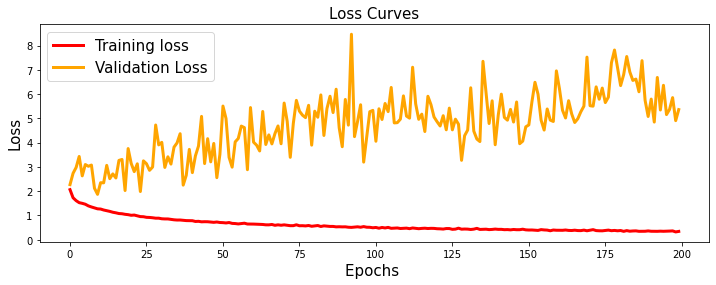

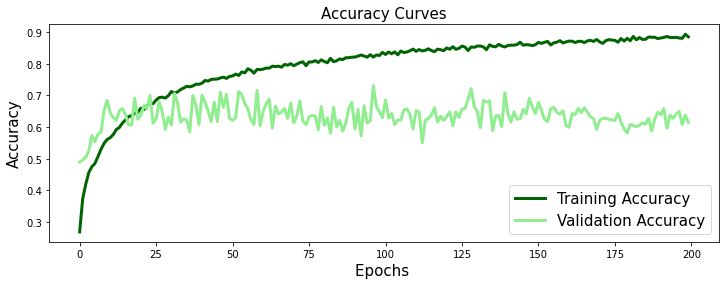

In [164]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(hist3.history['loss'],'red',linewidth=3.0)
plt.plot(hist3.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist3.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(hist3.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [165]:
model3.evaluate(x_test_n, y_test_n)

57/57 [==============================] - 1s 11ms/step - loss: 5.0355 - accuracy: 0.6271


[5.035479545593262, 0.6270717978477478]

In [167]:
model1 = Sequential()

model1.add(keras.Input(shape=input_shape_n))
model1.add(layers.Dense(4096 ,activation="tanh"))
model1.add(layers.Dropout(0.35))
model1.add(layers.Dense(2048, activation = "tanh"))
model1.add(layers.Dropout(0.45))
model1.add(layers.Dense(1024, activation = "sigmoid"))
model1.add(layers.Dropout(0.5))
model1.add(layers.Dense(512, activation = "tanh"))
model1.add(layers.Dropout(0.5))
model1.add(layers.Dense(64))
model1.add(layers.Dense(units = 10, activation = "softmax"))

model1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_75 (Dense)            (None, 4096)              143360    
                                                                 
 dropout (Dropout)           (None, 4096)              0         
                                                                 
 dense_76 (Dense)            (None, 2048)              8390656   
                                                                 
 dropout_1 (Dropout)         (None, 2048)              0         
                                                                 
 dense_77 (Dense)            (None, 1024)              2098176   
                                                                 
 dropout_2 (Dropout)         (None, 1024)              0         
                                                                 
 dense_78 (Dense)            (None, 512)              

In [168]:
model1.compile(optimizer="adam", loss= "categorical_crossentropy", metrics= ["accuracy"])

In [169]:
hist1 = model1.fit(x_train_n , y_train_n, epochs=60, batch_size = 32, validation_data=(x_val_n, y_val_n))

Epoch 1/60
385/385 [==============================] - 32s 81ms/step - loss: 2.1497 - accuracy: 0.2707 - val_loss: 1.6247 - val_accuracy: 0.4459
Epoch 2/60
385/385 [==============================] - 31s 80ms/step - loss: 1.7306 - accuracy: 0.3648 - val_loss: 1.4656 - val_accuracy: 0.5064
Epoch 3/60
385/385 [==============================] - 31s 81ms/step - loss: 1.6609 - accuracy: 0.3925 - val_loss: 1.5582 - val_accuracy: 0.4691
Epoch 4/60
385/385 [==============================] - 31s 79ms/step - loss: 1.6201 - accuracy: 0.4138 - val_loss: 1.4111 - val_accuracy: 0.5103
Epoch 5/60
385/385 [==============================] - 31s 79ms/step - loss: 1.5711 - accuracy: 0.4232 - val_loss: 1.3498 - val_accuracy: 0.5193
Epoch 6/60
385/385 [==============================] - 31s 80ms/step - loss: 1.5392 - accuracy: 0.4374 - val_loss: 1.6759 - val_accuracy: 0.4510
Epoch 7/60
385/385 [==============================] - 31s 81ms/step - loss: 1.4978 - accuracy: 0.4549 - val_loss: 1.4651 - val_accuracy:

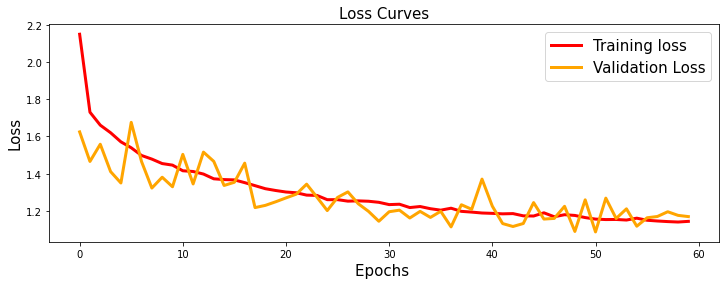

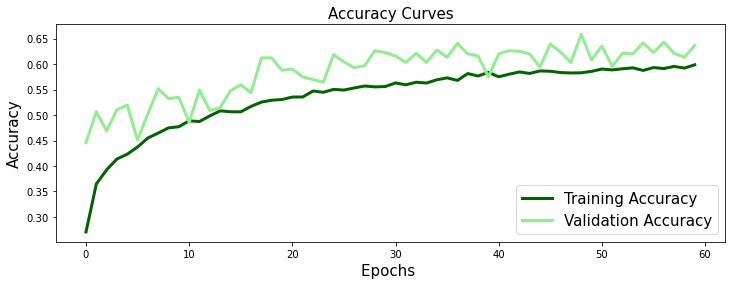

In [170]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(hist1.history['loss'],'red',linewidth=3.0)
plt.plot(hist1.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist1.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(hist1.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [193]:
hist1 = model1.fit(x_train_n , y_train_n, epochs=180, batch_size = 32, validation_data=(x_val_n, y_val_n))

Epoch 1/180
385/385 [==============================] - 21s 54ms/step - loss: 1.0951 - accuracy: 0.6087 - val_loss: 1.2635 - val_accuracy: 0.5915
Epoch 2/180
385/385 [==============================] - 21s 55ms/step - loss: 1.0998 - accuracy: 0.6086 - val_loss: 1.1137 - val_accuracy: 0.6366
Epoch 3/180
385/385 [==============================] - 23s 60ms/step - loss: 1.0866 - accuracy: 0.6158 - val_loss: 1.1355 - val_accuracy: 0.6418
Epoch 4/180
385/385 [==============================] - 26s 68ms/step - loss: 1.0975 - accuracy: 0.6102 - val_loss: 1.0621 - val_accuracy: 0.6675
Epoch 5/180
385/385 [==============================] - 26s 67ms/step - loss: 1.1067 - accuracy: 0.6040 - val_loss: 1.0472 - val_accuracy: 0.6637
Epoch 6/180
385/385 [==============================] - 22s 58ms/step - loss: 1.0979 - accuracy: 0.6086 - val_loss: 1.1405 - val_accuracy: 0.6198
Epoch 7/180
385/385 [==============================] - 25s 64ms/step - loss: 1.1122 - accuracy: 0.6033 - val_loss: 1.0383 - val_ac

385/385 [==============================] - 27s 70ms/step - loss: 1.0626 - accuracy: 0.6244 - val_loss: 0.9861 - val_accuracy: 0.6740
Epoch 114/180
385/385 [==============================] - 26s 67ms/step - loss: 1.0641 - accuracy: 0.6145 - val_loss: 0.9868 - val_accuracy: 0.6907
Epoch 115/180
385/385 [==============================] - 25s 65ms/step - loss: 1.0668 - accuracy: 0.6171 - val_loss: 1.0634 - val_accuracy: 0.6675
Epoch 116/180
385/385 [==============================] - 25s 64ms/step - loss: 1.0575 - accuracy: 0.6191 - val_loss: 1.1027 - val_accuracy: 0.6508
Epoch 117/180
385/385 [==============================] - 24s 62ms/step - loss: 1.0601 - accuracy: 0.6222 - val_loss: 1.0869 - val_accuracy: 0.6508
Epoch 118/180
385/385 [==============================] - 23s 60ms/step - loss: 1.0469 - accuracy: 0.6246 - val_loss: 1.0995 - val_accuracy: 0.6624
Epoch 119/180
385/385 [==============================] - 22s 57ms/step - loss: 1.0360 - accuracy: 0.6317 - val_loss: 1.0784 - val_ac

Epoch 169/180
385/385 [==============================] - 22s 58ms/step - loss: 1.0325 - accuracy: 0.6313 - val_loss: 1.0694 - val_accuracy: 0.6765
Epoch 170/180
385/385 [==============================] - 22s 58ms/step - loss: 1.0381 - accuracy: 0.6315 - val_loss: 1.0334 - val_accuracy: 0.6843
Epoch 171/180
385/385 [==============================] - 22s 58ms/step - loss: 1.0190 - accuracy: 0.6359 - val_loss: 1.1195 - val_accuracy: 0.6585
Epoch 172/180
385/385 [==============================] - 22s 57ms/step - loss: 1.0293 - accuracy: 0.6309 - val_loss: 1.0948 - val_accuracy: 0.6469
Epoch 173/180
385/385 [==============================] - 23s 59ms/step - loss: 1.0239 - accuracy: 0.6381 - val_loss: 1.0213 - val_accuracy: 0.6830
Epoch 174/180
385/385 [==============================] - 22s 58ms/step - loss: 1.0444 - accuracy: 0.6272 - val_loss: 0.9720 - val_accuracy: 0.6881
Epoch 175/180
385/385 [==============================] - 22s 58ms/step - loss: 1.0375 - accuracy: 0.6300 - val_loss: 1

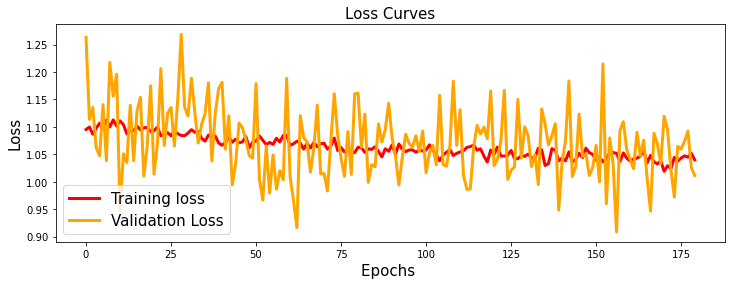

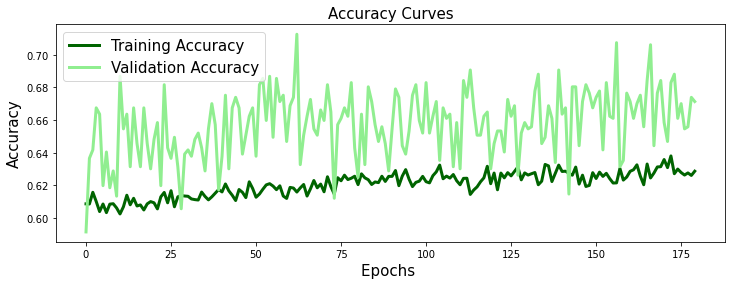

In [194]:
plt.figure(figsize=[12,4])
plt.plot(hist1.history['loss'],'red',linewidth=3.0)
plt.plot(hist1.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist1.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(hist1.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [195]:
input_to_nn = Input(shape = input_shape_n)

hidden_1 = Dense(512, activation = "tanh")(input_to_nn)
d1 = Dropout(0.45)(hidden_1)
hidden_2 = Dense(128, activation = "tanh")(d1)
d2 = Dropout(0.5)(hidden_2)
hidden_3 = Dense(32, activation = "tanh")(d2)

hidden_4 = Dense(256, activation = "sigmoid")(input_to_nn)
d3 = Dropout(0.4)(hidden_4)
hidden_5 = Dense(64, activation = "sigmoid")(d3)
d4 = Dropout(0.45)(hidden_5)
hidden_6 = Dense(16, activation = "sigmoid")(d4)

concat = Concatenate()([hidden_3, hidden_6])

dense1 = Dense(512, activation = "tanh")(concat)
dense2 = Dense(128, activation = "relu")(dense1)
output = Dense(10, activation = "softmax")(dense2)

model2 = Model(inputs = [input_to_nn], outputs = [output])

model2.summary()

Model: "model_12"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_17 (InputLayer)          [(None, 34)]         0           []                               
                                                                                                  
 dense_219 (Dense)              (None, 512)          17920       ['input_17[0][0]']               
                                                                                                  
 dense_222 (Dense)              (None, 256)          8960        ['input_17[0][0]']               
                                                                                                  
 dropout_39 (Dropout)           (None, 512)          0           ['dense_219[0][0]']              
                                                                                           

In [197]:
model2.compile(optimizer="adam", loss= "categorical_crossentropy", metrics= ["accuracy"])

In [200]:
hist2 = model2.fit(x_train_n , y_train_n, epochs=500, batch_size = 32, validation_data=(x_val_n, y_val_n))

Epoch 1/500
385/385 [==============================] - 4s 8ms/step - loss: 1.8550 - accuracy: 0.3138 - val_loss: 1.4288 - val_accuracy: 0.4678
Epoch 2/500
385/385 [==============================] - 3s 7ms/step - loss: 1.6318 - accuracy: 0.3979 - val_loss: 1.3856 - val_accuracy: 0.5026
Epoch 3/500
385/385 [==============================] - 3s 8ms/step - loss: 1.5724 - accuracy: 0.4214 - val_loss: 1.4211 - val_accuracy: 0.4871
Epoch 4/500
385/385 [==============================] - 3s 7ms/step - loss: 1.5469 - accuracy: 0.4296 - val_loss: 1.4008 - val_accuracy: 0.5116
Epoch 5/500
385/385 [==============================] - 3s 7ms/step - loss: 1.5056 - accuracy: 0.4415 - val_loss: 1.4470 - val_accuracy: 0.5490
Epoch 6/500
385/385 [==============================] - 3s 7ms/step - loss: 1.4838 - accuracy: 0.4585 - val_loss: 1.3298 - val_accuracy: 0.5425
Epoch 7/500
385/385 [==============================] - 3s 7ms/step - loss: 1.4563 - accuracy: 0.4686 - val_loss: 1.2897 - val_accuracy: 0.5619

Epoch 114/500
385/385 [==============================] - 3s 7ms/step - loss: 1.0549 - accuracy: 0.6129 - val_loss: 1.3317 - val_accuracy: 0.6121
Epoch 115/500
385/385 [==============================] - 3s 7ms/step - loss: 1.0552 - accuracy: 0.6153 - val_loss: 1.2661 - val_accuracy: 0.6211
Epoch 116/500
385/385 [==============================] - 3s 7ms/step - loss: 1.0580 - accuracy: 0.6152 - val_loss: 1.3558 - val_accuracy: 0.6082
Epoch 117/500
385/385 [==============================] - 3s 7ms/step - loss: 1.0616 - accuracy: 0.6117 - val_loss: 1.4212 - val_accuracy: 0.6108
Epoch 118/500
385/385 [==============================] - 3s 7ms/step - loss: 1.0598 - accuracy: 0.6145 - val_loss: 1.2928 - val_accuracy: 0.6289
Epoch 119/500
385/385 [==============================] - 3s 7ms/step - loss: 1.0421 - accuracy: 0.6196 - val_loss: 1.3410 - val_accuracy: 0.6198
Epoch 120/500
385/385 [==============================] - ETA: 0s - loss: 1.0547 - accuracy: 0.61 - 3s 7ms/step - loss: 1.0529 - ac

385/385 [==============================] - 3s 7ms/step - loss: 0.9481 - accuracy: 0.6545 - val_loss: 1.5849 - val_accuracy: 0.5876
Epoch 227/500
385/385 [==============================] - 3s 7ms/step - loss: 0.9441 - accuracy: 0.6496 - val_loss: 1.5676 - val_accuracy: 0.5915
Epoch 228/500
385/385 [==============================] - 3s 7ms/step - loss: 0.9528 - accuracy: 0.6520 - val_loss: 1.4476 - val_accuracy: 0.6095
Epoch 229/500
385/385 [==============================] - 3s 7ms/step - loss: 0.9529 - accuracy: 0.6518 - val_loss: 1.4774 - val_accuracy: 0.5941
Epoch 230/500
385/385 [==============================] - 3s 7ms/step - loss: 0.9588 - accuracy: 0.6430 - val_loss: 1.4539 - val_accuracy: 0.6134
Epoch 231/500
385/385 [==============================] - 3s 7ms/step - loss: 0.9460 - accuracy: 0.6518 - val_loss: 1.3950 - val_accuracy: 0.6147
Epoch 232/500
385/385 [==============================] - 3s 7ms/step - loss: 0.9601 - accuracy: 0.6485 - val_loss: 1.4018 - val_accuracy: 0.6044

385/385 [==============================] - 2s 5ms/step - loss: 0.8997 - accuracy: 0.6679 - val_loss: 1.6107 - val_accuracy: 0.5812
Epoch 338/500
385/385 [==============================] - 2s 5ms/step - loss: 0.9248 - accuracy: 0.6590 - val_loss: 1.4996 - val_accuracy: 0.6005
Epoch 339/500
385/385 [==============================] - 2s 5ms/step - loss: 0.9286 - accuracy: 0.6595 - val_loss: 1.4799 - val_accuracy: 0.6082 - loss: 0.9283 - accuracy: 0.66
Epoch 340/500
385/385 [==============================] - 2s 5ms/step - loss: 0.9094 - accuracy: 0.6674 - val_loss: 1.4167 - val_accuracy: 0.6224
Epoch 341/500
385/385 [==============================] - 2s 5ms/step - loss: 0.9085 - accuracy: 0.6649 - val_loss: 1.4261 - val_accuracy: 0.6108
Epoch 342/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8982 - accuracy: 0.6671 - val_loss: 1.3411 - val_accuracy: 0.6289
Epoch 343/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8926 - accuracy: 0.6755 - val_los

Epoch 392/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8769 - accuracy: 0.6787 - val_loss: 1.3999 - val_accuracy: 0.6314
Epoch 393/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8914 - accuracy: 0.6730 - val_loss: 1.4353 - val_accuracy: 0.6186
Epoch 394/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8835 - accuracy: 0.6754 - val_loss: 1.4974 - val_accuracy: 0.6263
Epoch 395/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8834 - accuracy: 0.6786 - val_loss: 1.5771 - val_accuracy: 0.5966
Epoch 396/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8808 - accuracy: 0.6727 - val_loss: 1.3164 - val_accuracy: 0.6443
Epoch 397/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8745 - accuracy: 0.6780 - val_loss: 1.5703 - val_accuracy: 0.5954
Epoch 398/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8893 - accuracy: 0.6730 - val_loss: 1.5375 - val_ac

Epoch 448/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8666 - accuracy: 0.6840 - val_loss: 1.5579 - val_accuracy: 0.6121
Epoch 449/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8610 - accuracy: 0.6817 - val_loss: 1.4943 - val_accuracy: 0.6250
Epoch 450/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8746 - accuracy: 0.6784 - val_loss: 1.5769 - val_accuracy: 0.6121
Epoch 451/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8622 - accuracy: 0.6854 - val_loss: 1.5586 - val_accuracy: 0.6082
Epoch 452/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8740 - accuracy: 0.6742 - val_loss: 1.4649 - val_accuracy: 0.6211
Epoch 453/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8541 - accuracy: 0.6841 - val_loss: 1.4635 - val_accuracy: 0.6082
Epoch 454/500
385/385 [==============================] - 2s 5ms/step - loss: 0.8658 - accuracy: 0.6816 - val_loss: 1.4085 - val_ac

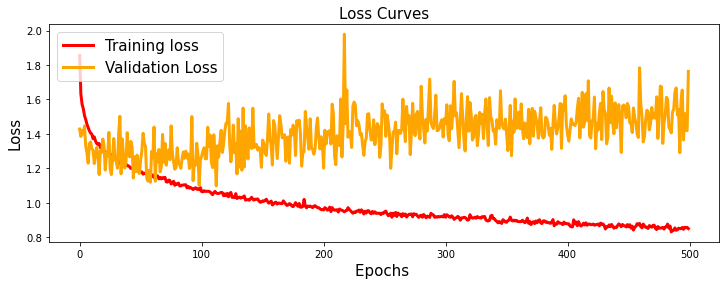

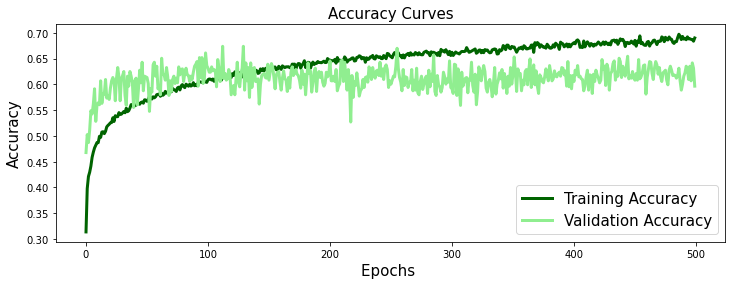

In [201]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(hist2.history['loss'],'red',linewidth=3.0)
plt.plot(hist2.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist2.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(hist2.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()

In [185]:
from keras.activations import LeakyReLU

In [190]:
input_to_nn = Input(shape = input_shape_n)

hidden_1 = Dense(2048,  activation='selu',kernel_initializer='lecun_normal' )(input_to_nn)
bn1 = BatchNormalization()(hidden_1)
d11 = AlphaDropout(0.5)(bn1)

hidden_2 = Dense(1024, activation='selu',kernel_initializer='lecun_normal')(d11)
bn2 = BatchNormalization()(hidden_2)
d12 = AlphaDropout(0.5)(bn2)

hidden_3 = Dense(512,  activation='selu',kernel_initializer='lecun_normal')(d12)
bn3 = BatchNormalization()(hidden_3)
d13 = AlphaDropout(0.5)(bn3)

concat1 = Concatenate()([hidden_1, hidden_3])

hidden_4 = Dense(256,  activation='selu',kernel_initializer='lecun_normal')(concat1)
bn4 = BatchNormalization()(hidden_4)
d14 = AlphaDropout(0.5)(bn4)

concat2 = Concatenate()([hidden_2, hidden_4])


hidden_5 = Dense(128,  activation='selu',kernel_initializer='lecun_normal')(concat2)
bn5 = BatchNormalization()(hidden_5)
d15 = AlphaDropout(0.5)(bn5)



hidden_6 = Dense(1024, activation = "elu")(input_to_nn)
bn6 = BatchNormalization()(hidden_6)

hidden_7 = Dense(256, activation = "elu")(bn6)
bn7 = BatchNormalization()(hidden_7)

hidden_8 = Dense(64, activation = "elu")(bn7)
bn8 = BatchNormalization()(hidden_8)

hidden_9 = Dense(32, activation = "elu")(bn8)
bn9 = BatchNormalization()(hidden_9)

hidden_10 = Dense(16, activation = "elu")(bn9)
bn10 = BatchNormalization()(hidden_10)

d2 = AlphaDropout(0.5)(bn10)



hidden_11 = Dense(256, activation = LeakyReLU())(input_to_nn)
bn11 = BatchNormalization()(hidden_11)
d31 = Dropout(0.2)(bn11)


hidden_12 = Dense(128, activation = LeakyReLU())(d31)
bn12 = BatchNormalization()(hidden_12)
d32 = Dropout(0.25)(bn12)


hidden_13 = Dense(64, activation = LeakyReLU())(d32)
bn13 = BatchNormalization()(hidden_13)
d33 = Dropout(0.2)(bn13)


hidden_14 = Dense(32, activation = LeakyReLU())(d33)
bn14 = BatchNormalization()(hidden_14)
d34 = Dropout(0.25)(bn14)


hidden_15 = Dense(16, activation = LeakyReLU())(d34)
bn15 = BatchNormalization()(hidden_15)
d35 = Dropout(0.2)(bn15)



concat = Concatenate()([d15, d2, d35])

dense1 = Dense(64, activation = "selu", kernel_initializer='lecun_normal')(concat)
d3 = AlphaDropout(0.5)(dense1)
dense2 = Dense(32, activation = "elu")(d3)

output = Dense(10, activation = "softmax")(dense2)

model4 = Model(inputs = [input_to_nn], outputs = [output])

model4.summary()

Model: "model_11"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_16 (InputLayer)          [(None, 34)]         0           []                               
                                                                                                  
 dense_211 (Dense)              (None, 256)          8960        ['input_16[0][0]']               
                                                                                                  
 batch_normalization_162 (Batch  (None, 256)         1024        ['dense_211[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 dense_201 (Dense)              (None, 2048)         71680       ['input_16[0][0]']        

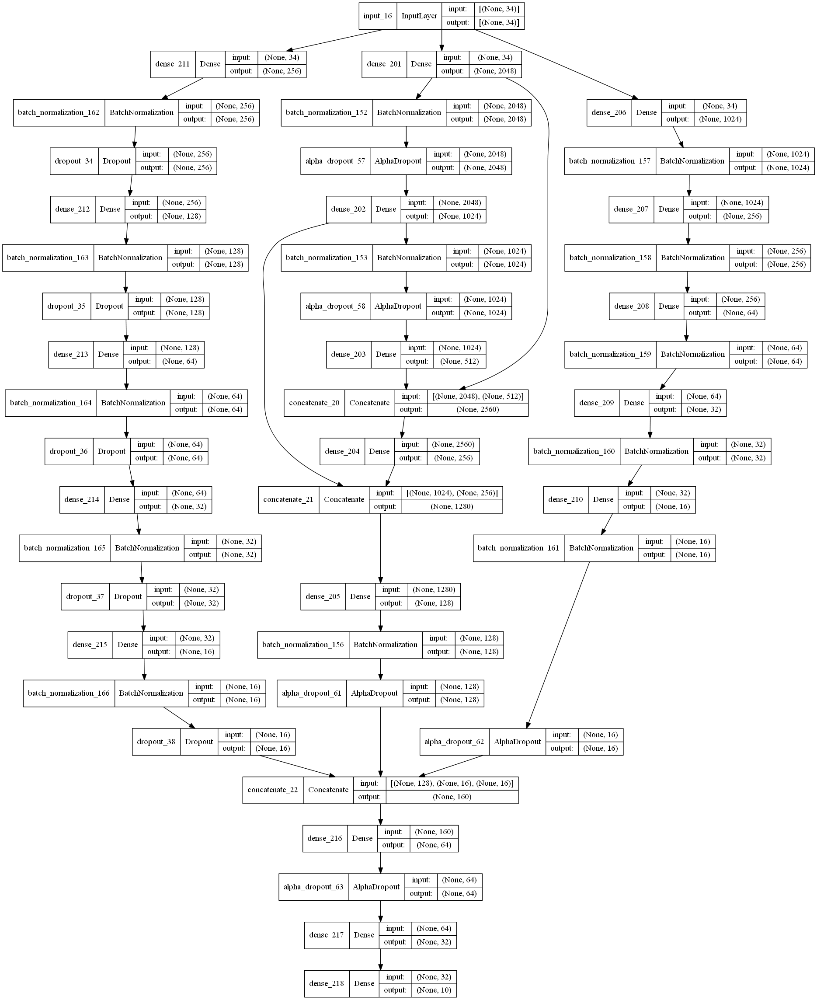

In [191]:
tf.keras.utils.plot_model(model4, show_shapes=True)

In [192]:
model4.compile(optimizer="adam", loss= "categorical_crossentropy", metrics= ["accuracy"])

In [204]:
hist4 = model4.fit(x_train_n , y_train_n, epochs=100, batch_size = 32, validation_data=(x_val_n, y_val_n))

Epoch 1/100
385/385 [==============================] - 14s 30ms/step - loss: 2.0747 - accuracy: 0.2578 - val_loss: 3.1488 - val_accuracy: 0.4072
Epoch 2/100
385/385 [==============================] - 11s 28ms/step - loss: 1.7668 - accuracy: 0.3447 - val_loss: 5.7944 - val_accuracy: 0.3595
Epoch 3/100
385/385 [==============================] - 10s 27ms/step - loss: 1.6840 - accuracy: 0.3844 - val_loss: 7.2430 - val_accuracy: 0.3827
Epoch 4/100
385/385 [==============================] - 10s 25ms/step - loss: 1.6154 - accuracy: 0.4101 - val_loss: 6.9765 - val_accuracy: 0.4253
Epoch 5/100
385/385 [==============================] - 10s 25ms/step - loss: 1.5490 - accuracy: 0.4407 - val_loss: 5.8501 - val_accuracy: 0.4394
Epoch 6/100
385/385 [==============================] - 10s 25ms/step - loss: 1.5421 - accuracy: 0.4435 - val_loss: 5.7767 - val_accuracy: 0.4665
Epoch 7/100
385/385 [==============================] - 10s 25ms/step - loss: 1.4929 - accuracy: 0.4660 - val_loss: 4.6763 - val_ac

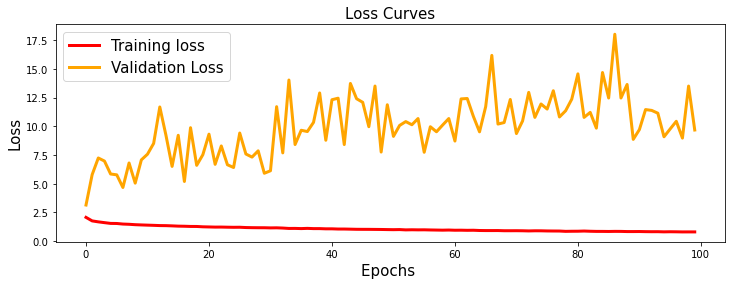

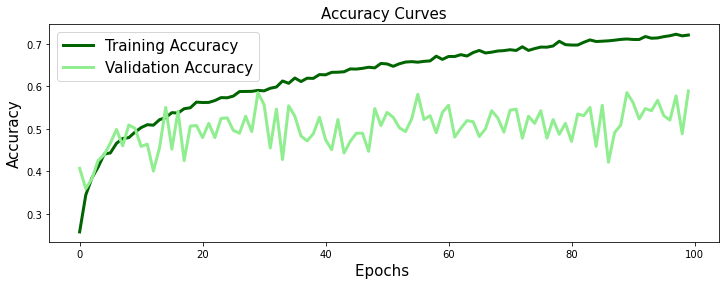

In [205]:
import matplotlib.pyplot as plt

# Loss curves
plt.figure(figsize=[12,4])
plt.plot(hist4.history['loss'],'red',linewidth=3.0)
plt.plot(hist4.history['val_loss'],'orange',linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Loss',fontsize=15)
plt.title('Loss Curves',fontsize=15)


# Accuracy Curves
plt.figure(figsize=[12,4])
plt.plot(hist4.history['accuracy'],'darkgreen',linewidth=3.0)
plt.plot(hist4.history['val_accuracy'],'lightgreen',linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'],fontsize=15)
plt.xlabel('Epochs ',fontsize=15)
plt.ylabel('Accuracy',fontsize=15)
plt.title('Accuracy Curves',fontsize=15)
plt.show()